<a href="https://colab.research.google.com/github/fredericomontandon/pythonprograms/blob/master/ML_Fredv3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Pré-processamento com Pandas e Scikit-Learn**

## Introdução

- Variaveis

1.   Numericas

*   Continua - Números reais (Temperatura, peso, altura..)
*   Discretas - Discretas (Conjuto de valores finitos (inteiros)


2.   Categoricas


*   Nominal - Dados não mensuráveis, sem ordenação (Cor dos olhos, gênero)
*   Ordinal - Categorização sob uma ordenação (Tamanho P,M,G)




In [ ]:
#Importando as bibliotecas
import pandas as pd
import numpy as np
import sklearn
import matplotlib.pyplot as plt
import matplotlib
import os
import plotly.express as px
import seaborn as sns
import pickle
from google.colab import drive
drive.mount('/content/drive/')
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix


Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


## Base de dados de crédito


In [ ]:
#Carregando a base de dados
base_credito = pd.read_csv('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit_data.csv')

In [ ]:
 #Vamos fazer a previsao de default, 0 indica que pagou emprestimo, 1 não pagou o emprestimo
base_credito

,clientid,income,age,loan,default
0,1,66155.925095,59.017015,8106.532131,0
1,2,34415.153966,48.117153,6564.745018,0
2,3,57317.170063,63.108049,8020.953296,0
3,4,42709.534201,45.751972,6103.642260,0
4,5,66952.688845,18.584336,8770.099235,1
...,...,...,...,...,...
1995,1996,59221.044874,48.518179,1926.729397,0
1996,1997,69516.127573,23.162104,3503.176156,0
1997,1998,44311.449262,28.017167,5522.786693,1
1998,1999,43756.056605,63.971796,1622.722598,0


In [ ]:
#Visualiando estatisticas
stat = base_credito.describe()

In [ ]:
stat

,clientid,income,age,loan,default
count,2000.000000,2000.000000,1997.000000,2000.000000,2000.000000
mean,1000.500000,45331.600018,40.807559,4444.369695,0.141500
std,577.494589,14326.327119,13.624469,3045.410024,0.348624
min,1.000000,20014.489470,-52.423280,1.377630,0.000000
25%,500.750000,32796.459717,28.990415,1939.708847,0.000000
50%,1000.500000,45789.117313,41.317159,3974.719419,0.000000
75%,1500.250000,57791.281668,52.587040,6432.410625,0.000000
max,2000.000000,69995.685578,63.971796,13766.051239,1.000000


In [ ]:
base_credito.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2000 entries, 0 to 1999
Data columns (total 5 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   clientid  2000 non-null   int64  
 1   income    2000 non-null   float64
 2   age       1997 non-null   float64
 3   loan      2000 non-null   float64
 4   default   2000 non-null   int64  
dtypes: float64(3), int64(2)
memory usage: 78.3 KB


In [ ]:
#Salvei a table describe dentro de uma variavel, e a partir dai vou
#obtendo dados já calculado usando loc, posso pegar dirto tb, base_credito.describe().loc['25%']
stat.loc['std']


,std
clientid,577.494589
income,14326.327119
age,13.624469
loan,3045.410024
default,0.348624


In [ ]:
'''
Atenção a sintaxe, nesse caso abaixo, chamamos simplistemente dentro do dataset quem tem salario
maior que que 69000, ou seja, é uma operação lógica isso simplismente retorna True ou False
'''
base_credito['income'] >= 69995
'''
Já aqui, estamo dizendo retorne dentro da base credito, quem tem income maior que 69000, assim ele
ira retornar o valor, não mais puramente uma operação lógica
'''
base_credito[base_credito['income'] >= 69995]

,clientid,income,age,loan,default
422,423,69995.685578,52.719673,2084.370861,0


## Visualização dos dados

In [ ]:
#Verficicando valores unicos na coluna default
np.unique(base_credito['default'])

array([0, 1])

In [ ]:
#Visualizando dados unicos da coluna default
base_credito['default'].value_counts()

,count
default,
0,1717
1,283


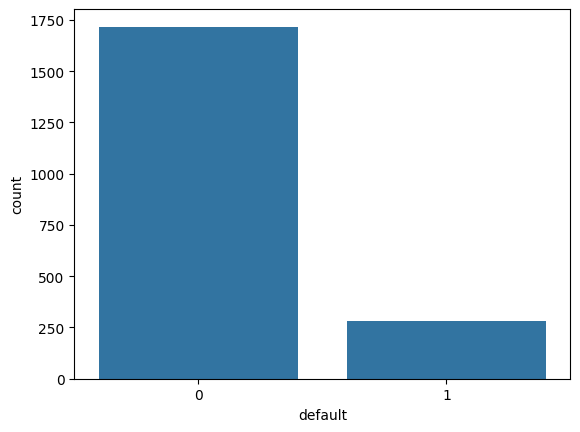

In [ ]:
#Visualizando com seabor graficos
sns.countplot(x = base_credito['default']);

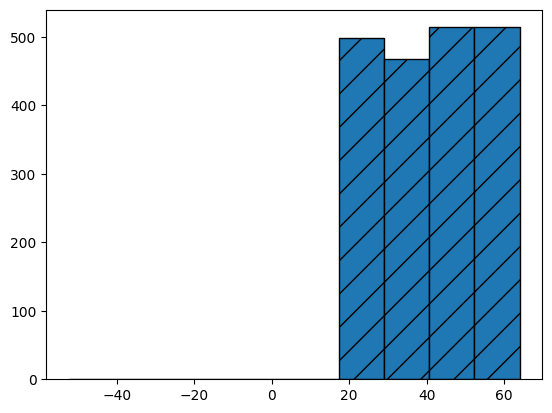

In [ ]:
#Usando o matplotlib para gerar graficos
plt.hist(base_credito['age'],edgecolor='black',hatch='/');

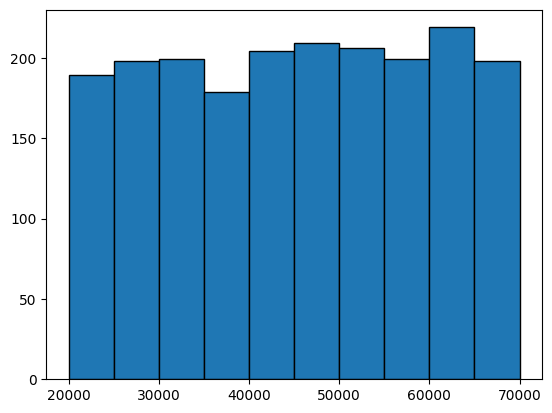

In [ ]:
plt.hist(base_credito['income'],edgecolor='black');

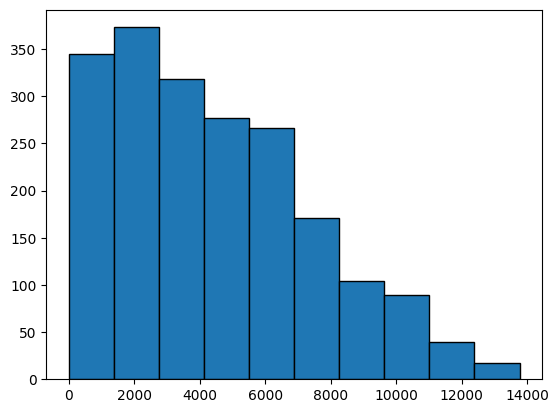

In [ ]:
plt.hist(base_credito['loan'],edgecolor='black');

In [ ]:
#Fazendo um gráfico dinamico com o Ploty
grafico = px.scatter_matrix(base_credito,dimensions=['age','income','loan'], color = 'default',color_continuous_scale='blackbody')
#usando o color a coluna default ele faz um mapa de calor basedo em 0-1 de quem paga e nao paga, e ai o color_continuous
#me da a mudança do gradiente de cor
grafico.show()

## Tratamento de valores inconsistentes

In [ ]:
base_credito.loc[base_credito['age'] < 0]

,clientid,income,age,loan,default
15,16,50501.726689,-28.218361,3977.287432,0
21,22,32197.620701,-52.423280,4244.057136,0
26,27,63287.038908,-36.496976,9595.286289,0


In [ ]:
#Relembrando .loc[linha, coluna],
#No caso: base_credito['age'] < 0 retorne todas as linhas onde age é < 0
#base_credito.loc[base_credito['age'] < 0, 'age'] me retorne some a coluna age os valores sao < 0

base_credito.loc[base_credito['age'] < 0, 'age'] = base_credito.loc[base_credito['age'] < 0, 'age'] * -1

In [ ]:
base_credito.head(27)

,clientid,income,age,loan,default
0,1,66155.925095,59.017015,8106.532131,0
1,2,34415.153966,48.117153,6564.745018,0
2,3,57317.170063,63.108049,8020.953296,0
3,4,42709.534201,45.751972,6103.642260,0
4,5,66952.688845,18.584336,8770.099235,1
5,6,24904.064140,57.471607,15.498598,0
6,7,48430.359613,26.809132,5722.581981,0
7,8,24500.141984,32.897548,2971.003310,1
8,9,40654.892537,55.496853,4755.825280,0
9,10,25075.872771,39.776378,1409.230371,0


In [ ]:
#Fazendo um gráfico dinamico com o Ploty
grafico = px.scatter_matrix(base_credito,dimensions=['age','income','loan'], color = 'default',color_continuous_scale='blackbody')
#usando o color a coluna default ele faz um mapa de calor basedo em 0-1 de quem paga e nao paga, e ai o color_continuous
#me da a mudança do gradiente de cor
grafico.show()

## Valores de tratamentos faltantes

In [ ]:
#Fazendo o somatorio da quantidade de vezes que temos valores NaN
base_credito.isnull().sum()

,0
clientid,0
income,0
age,3
loan,0
default,0


In [ ]:
#Aqui estou usando iloc para mostrar onde estao os valores NaN
base_credito.loc[pd.isnull(base_credito['age'])]

,clientid,income,age,loan,default
28,29,59417.805406,NaN,2082.625938,0
30,31,48528.852796,NaN,6155.784670,0
31,32,23526.302555,NaN,2862.010139,0


In [ ]:
 #Vou substituir os valores NaN, por interpolação linear
base_credito['age'].fillna(base_credito['age'].interpolate(), inplace=True)


/tmp/ipython-input-2510939064.py:2: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





In [ ]:
base_credito.isnull().sum()

,0
clientid,0
income,0
age,0
loan,0
default,0


In [ ]:
#Verificando os valores
base_credito.loc[(base_credito['clientid'] == 29) | (base_credito['clientid'] == 31) | (base_credito['clientid'] == 32)]

,clientid,income,age,loan,default
28,29,59417.805406,55.175435,2082.625938,0
30,31,48528.852796,49.051268,6155.784670,0
31,32,23526.302555,43.591587,2862.010139,0


In [ ]:
base_credito.loc[base_credito['clientid'].isin([29,31,32])] #codigo mais simplies

,clientid,income,age,loan,default
28,29,59417.805406,55.175435,2082.625938,0
30,31,48528.852796,49.051268,6155.784670,0
31,32,23526.302555,43.591587,2862.010139,0


## Divisao entre previsores e classe

In [ ]:
#Aqui vamos fazer uma previsao para testar se o emprestimo sera pago ou nao
X_credit = base_credito.iloc[:, 1:4].values #Aqui estamos definindo as variaveis indepentendes, previsores, features
                                     #Selecionamos de 1 a 3, o ,values converte para numpy
X_credit

array([[6.61559251e+04, 5.90170151e+01, 8.10653213e+03],
       [3.44151540e+04, 4.81171531e+01, 6.56474502e+03],
       [5.73171701e+04, 6.31080495e+01, 8.02095330e+03],
       ...,
       [4.43114493e+04, 2.80171669e+01, 5.52278669e+03],
       [4.37560566e+04, 6.39717958e+01, 1.62272260e+03],
       [6.94365796e+04, 5.61526170e+01, 7.37883360e+03]])

In [ ]:
type(X_credit)

numpy.ndarray

In [ ]:
Y_credit = base_credito.iloc[:,4].values
Y_credit

array([0, 0, 0, ..., 1, 0, 0])

## Escalonamento dos atributos


In [ ]:
#Escalonamento, Padronização ou Normalização
X_credit


array([[6.61559251e+04, 5.90170151e+01, 8.10653213e+03],
       [3.44151540e+04, 4.81171531e+01, 6.56474502e+03],
       [5.73171701e+04, 6.31080495e+01, 8.02095330e+03],
       ...,
       [4.43114493e+04, 2.80171669e+01, 5.52278669e+03],
       [4.37560566e+04, 6.39717958e+01, 1.62272260e+03],
       [6.94365796e+04, 5.61526170e+01, 7.37883360e+03]])

In [ ]:
X_credit[:,0] #Pegando a primeira coluna do Dataset X-Credit

array([66155.92509508, 34415.15396582, 57317.17006303, ...,
       44311.44926231, 43756.05660491, 69436.57955155])

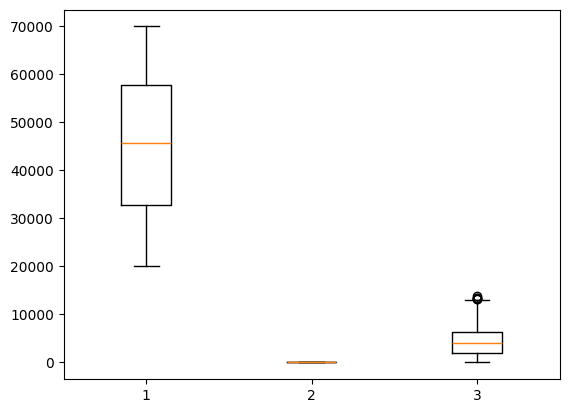

In [ ]:
plt.boxplot(X_credit);

In [ ]:
from sklearn.preprocessing import StandardScaler #Padronizando, Média 0 e desvio padrao 1
scaler_credit = StandardScaler()
X_credit = scaler_credit.fit_transform(X_credit)
X_credit

array([[ 1.45393393,  1.36350447,  1.20281942],
       [-0.76217555,  0.5414733 ,  0.69642695],
       [ 0.83682073,  1.67203661,  1.17471147],
       ...,
       [-0.07122592, -0.97440049,  0.35420081],
       [-0.11000289,  1.73717747, -0.92675625],
       [ 1.682986  ,  1.14748114,  0.96381038]])

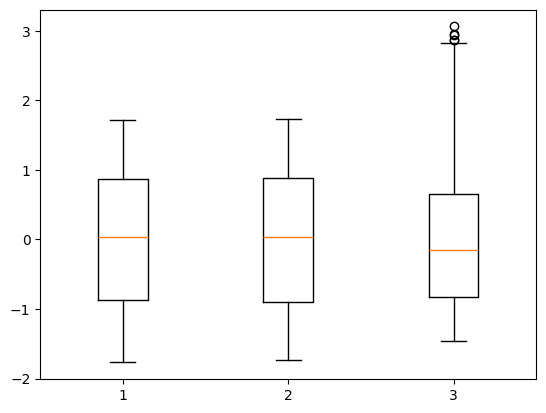

In [ ]:
plt.boxplot(X_credit);

In [ ]:
X_credit.std()

np.float64(1.0)

In [ ]:
X_credit.mean()

np.float64(9.769962616701378e-17)

# BASE DE DADOS CENSO

In [ ]:
df_census = pd.read_csv('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/census.csv')

In [ ]:
df_census.head()


,age,workclass,final-weight,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loos,hour-per-week,native-country,income
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


In [ ]:
df_census.describe()

,age,final-weight,education-num,capital-gain,capital-loos,hour-per-week
count,32561.000000,3.256100e+04,32561.000000,32561.000000,32561.000000,32561.000000
mean,38.581647,1.897784e+05,10.080679,1077.648844,87.303830,40.437456
std,13.640433,1.055500e+05,2.572720,7385.292085,402.960219,12.347429
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.178270e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.783560e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.370510e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [ ]:
df_census.shape

(32561, 15)

In [ ]:
df_census.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32561 entries, 0 to 32560
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             32561 non-null  int64 
 1   workclass       32561 non-null  object
 2   final-weight    32561 non-null  int64 
 3   education       32561 non-null  object
 4   education-num   32561 non-null  int64 
 5   marital-status  32561 non-null  object
 6   occupation      32561 non-null  object
 7   relationship    32561 non-null  object
 8   race            32561 non-null  object
 9   sex             32561 non-null  object
 10  capital-gain    32561 non-null  int64 
 11  capital-loos    32561 non-null  int64 
 12  hour-per-week   32561 non-null  int64 
 13  native-country  32561 non-null  object
 14  income          32561 non-null  object
dtypes: int64(6), object(9)
memory usage: 3.7+ MB


In [ ]:
np.unique(df_census['income'], return_counts=True)

(array([' <=50K', ' >50K'], dtype=object), array([24720,  7841]))

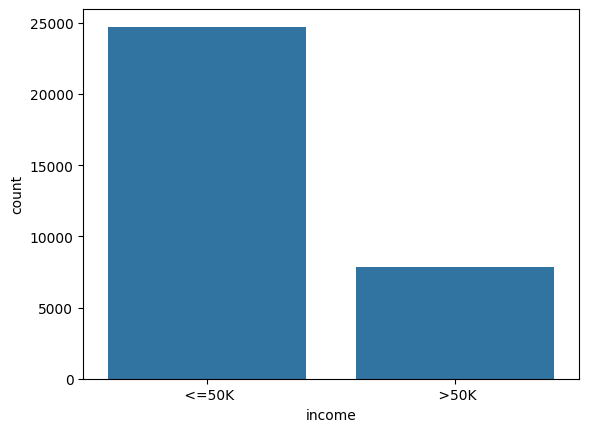

In [ ]:
#Visualizando grafico
sns.countplot(x = df_census['income']);

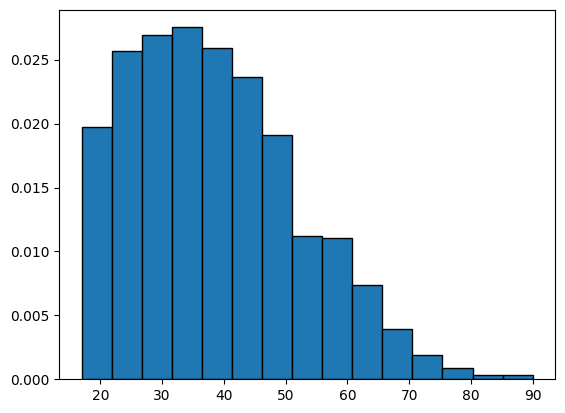

In [ ]:
plt.hist(df_census['age'],bins=15,density=True
         ,edgecolor='black');

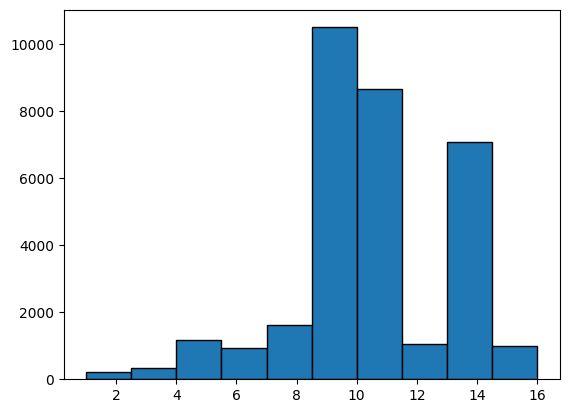

In [ ]:
plt.hist(df_census['education-num'],edgecolor='black');

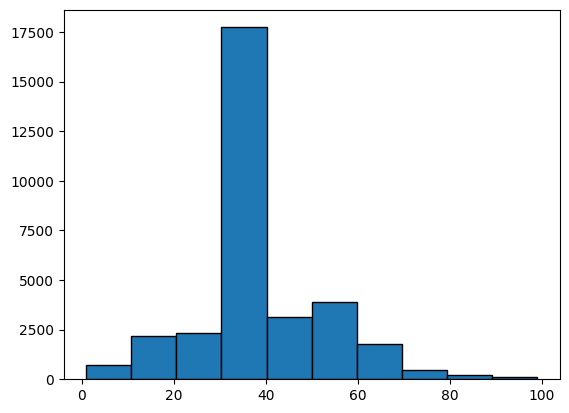

In [ ]:
plt.hist(df_census['hour-per-week'],edgecolor='black');

In [ ]:
np.unique(df_census['workclass'], return_counts=True)

(array([' ?', ' Federal-gov', ' Local-gov', ' Never-worked', ' Private',
        ' Self-emp-inc', ' Self-emp-not-inc', ' State-gov', ' Without-pay'],
       dtype=object),
 array([ 1836,   960,  2093,     7, 22696,  1116,  2541,  1298,    14]))

In [ ]:
#Graficos do ploty sao bem interessantes pois sao faceis de gerar e tambem sao interativos
grafico = px.treemap(df_census, path=['workclass','age'])
grafico.show()

In [ ]:
np.unique(df_census['occupation'], return_counts=True)

(array([' ?', ' Adm-clerical', ' Armed-Forces', ' Craft-repair',
        ' Exec-managerial', ' Farming-fishing', ' Handlers-cleaners',
        ' Machine-op-inspct', ' Other-service', ' Priv-house-serv',
        ' Prof-specialty', ' Protective-serv', ' Sales', ' Tech-support',
        ' Transport-moving'], dtype=object),
 array([1843, 3770,    9, 4099, 4066,  994, 1370, 2002, 3295,  149, 4140,
         649, 3650,  928, 1597]))

In [ ]:
grafico = px.treemap(df_census, path=['occupation','relationship','age'])
grafico.show()

In [ ]:
#Gráfico categorias paralelas
grafico = px.parallel_categories(df_census, dimensions=['workclass','occupation','relationship'],color='age',color_continuous_scale=px.colors.sequential.Inferno)
grafico.show()

In [ ]:
grafico = px.histogram(df_census, x='workclass',color='income',barmode='group')
grafico.show()

## Divisão da base de dados


In [ ]:
X_census = df_census.iloc[:,0:14].values
X_census

array([[39, ' State-gov', 77516, ..., 0, 40, ' United-States'],
       [50, ' Self-emp-not-inc', 83311, ..., 0, 13, ' United-States'],
       [38, ' Private', 215646, ..., 0, 40, ' United-States'],
       ...,
       [58, ' Private', 151910, ..., 0, 40, ' United-States'],
       [22, ' Private', 201490, ..., 0, 20, ' United-States'],
       [52, ' Self-emp-inc', 287927, ..., 0, 40, ' United-States']],
      dtype=object)

In [ ]:
Y_ceunsus = df_census.iloc[:,14].values
Y_ceunsus

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' >50K'],
      dtype=object)

## LabelEncoder
Atributos categoricos (tipo string) devem ser transformados para que possamos fazer toda a parte matematicas de Machine Learning, Regressao,etc.

**Encode target labels with value between 0 and n_classes-1.This transformer should be used to encode target values, i.e. y, and not the input X.**

A desvantagem LabelEncoder é que podemos ter muitas categorias e os valores serão diferentes, por exemplo, Para 10 categorias teremos 10 valores diferentes (0...9) isso pode levar a uma má interpretação matematica pois o algoritmo pode levar em consideração um peso maior pra o atributo 9 do que o 5 por exemplo

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
label_enconder_teste = LabelEncoder() #instanciando um objeto da classe LabelEncoder

In [ ]:
X_census[:,1] #coluna workclass

array([' State-gov', ' Self-emp-not-inc', ' Private', ..., ' Private',
       ' Private', ' Self-emp-inc'], dtype=object)

In [ ]:
teste = label_enconder_teste.fit_transform(X_census[:,1]) #estou testando o label encoder a coluna 1 do df_census que é workclass

In [ ]:
"""
Observe que o LabelEncoder() atribuiu 9 labels para cada tipo diferente de valor dentro da coluna workclass
"""
np.unique(teste)

array([0, 1, 2, 3, 4, 5, 6, 7, 8])

In [ ]:
X_census[0] #temos que criar um label enconder para cada atributo string

array([39, ' State-gov', 77516, ' Bachelors', 13, ' Never-married',
       ' Adm-clerical', ' Not-in-family', ' White', ' Male', 2174, 0, 40,
       ' United-States'], dtype=object)

In [ ]:
label_enconder_workclass = LabelEncoder()
label_enconder_education = LabelEncoder()
label_enconder_marital = LabelEncoder()
label_enconder_occupation = LabelEncoder()
label_enconder_relationship = LabelEncoder()
label_enconder_race = LabelEncoder()
label_enconder_sex = LabelEncoder()
label_enconder_country = LabelEncoder()
#Para cada coluna string

In [ ]:
X_census[:,1] = label_enconder_workclass.fit_transform(X_census[:,1]) #Coluna workclass
X_census[:,3] = label_enconder_education.fit_transform(X_census[:,3]) #Coluna Education
X_census[:,5] = label_enconder_marital.fit_transform(X_census[:,5]) #Coluna Marital
X_census[:,6] = label_enconder_occupation.fit_transform(X_census[:,6]) #Coluna Occupation
X_census[:,7] = label_enconder_relationship.fit_transform(X_census[:,7]) #Coluna Relationship
X_census[:,8] = label_enconder_race.fit_transform(X_census[:,8]) #Coluna Race
X_census[:,9] = label_enconder_sex.fit_transform(X_census[:,9]) #Coluna Sex
X_census[:,13] = label_enconder_country.fit_transform(X_census[:,13]) #Coluna Country

In [ ]:
pd.DataFrame(X_census) #visualizando a base X_census

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,39,7,77516,9,13,4,1,1,4,1,2174,0,40,39
1,50,6,83311,9,13,2,4,0,4,1,0,0,13,39
2,38,4,215646,11,9,0,6,1,4,1,0,0,40,39
3,53,4,234721,1,7,2,6,0,2,1,0,0,40,39
4,28,4,338409,9,13,2,10,5,2,0,0,0,40,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,27,4,257302,7,12,2,13,5,4,0,0,0,38,39
32557,40,4,154374,11,9,2,7,0,4,1,0,0,40,39
32558,58,4,151910,11,9,6,1,4,4,0,0,0,40,39
32559,22,4,201490,11,9,4,1,3,4,1,0,0,20,39


## OneHotEncoder

Evita o problema de vários categorias aqui teriamos uma tabela verdade contendo 0 e 1 representando de maneira combinada cada categoria

In [ ]:
len(np.unique(df_census['workclass'])) #quantidade de categorias na coluna
#Aqui teriamos 9 colunas adicionais para representar cada categoria, com combinações de 0 e 1
#1 0 0 0 0 0 0 0 0 --> representaria por exemplo private e assim sucessivamente

9

In [ ]:
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer #Para adicionar as colunas extras
onehotencoder_census= ColumnTransformer(transformers=[('OneHot',OneHotEncoder(),[1,3,5,6,7,8,9,13])],remainder='passthrough') #a lista se refere ao indice das colunas
X_census = onehotencoder_census.fit_transform(X_census).toarray() #toarray() é para deixar tipo array NumPy

In [ ]:
X_census

array([[0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 2.1740e+03, 0.0000e+00,
        4.0000e+01],
       [0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
        1.3000e+01],
       [0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
        4.0000e+01],
       ...,
       [0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
        4.0000e+01],
       [0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 0.0000e+00, 0.0000e+00,
        2.0000e+01],
       [0.0000e+00, 0.0000e+00, 0.0000e+00, ..., 1.5024e+04, 0.0000e+00,
        4.0000e+01]])

In [ ]:
pd.DataFrame(X_census) #base de dado com a transformação

,0,1,2,3,4,5,6,7,8,9,...,98,99,100,101,102,103,104,105,106,107
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,...,0.0,1.0,0.0,0.0,39.0,77516.0,13.0,2174.0,0.0,40.0
1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,50.0,83311.0,13.0,0.0,0.0,13.0
2,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,38.0,215646.0,9.0,0.0,0.0,40.0
3,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,53.0,234721.0,7.0,0.0,0.0,40.0
4,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,28.0,338409.0,13.0,0.0,0.0,40.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,27.0,257302.0,12.0,0.0,0.0,38.0
32557,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,40.0,154374.0,9.0,0.0,0.0,40.0
32558,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,58.0,151910.0,9.0,0.0,0.0,40.0
32559,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,...,0.0,1.0,0.0,0.0,22.0,201490.0,9.0,0.0,0.0,20.0


## Escalonamento dos valores

In [ ]:
from sklearn.preprocessing import StandardScaler
std = StandardScaler()
X_census = std.fit_transform(X_census)

In [ ]:
pd.DataFrame(X_census).describe()

,0,1,2,3,4,5,6,7,8,9,...,98,99,100,101,102,103,104,105,106,107
count,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,...,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04,3.256100e+04
mean,6.939363e-17,5.149967e-17,-4.582598e-17,-5.673693e-18,-3.535147e-17,4.020684e-17,4.757173e-17,3.960674e-17,2.182190e-18,4.909926e-18,...,5.237255e-18,1.994521e-16,3.600613e-18,1.636642e-17,-3.273284e-17,-1.001625e-16,1.492618e-16,2.007614e-17,-3.295106e-17,-6.022843e-17
std,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,...,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00
min,-2.444502e-01,-1.742951e-01,-2.620974e-01,-1.466381e-02,-1.516792e+00,-1.883893e-01,-2.909357e-01,-2.037614e-01,-2.073999e-02,-1.717532e-01,...,-2.416321e-02,-2.932948e+00,-4.540836e-02,-2.217266e-02,-1.582206e+00,-1.681631e+00,-3.529656e+00,-1.459205e-01,-2.166595e-01,-3.194030e+00
25%,-2.444502e-01,-1.742951e-01,-2.620974e-01,-1.466381e-02,-1.516792e+00,-1.883893e-01,-2.909357e-01,-2.037614e-01,-2.073999e-02,-1.717532e-01,...,-2.416321e-02,3.409539e-01,-4.540836e-02,-2.217266e-02,-7.757679e-01,-6.816910e-01,-4.200596e-01,-1.459205e-01,-2.166595e-01,-3.542945e-02
50%,-2.444502e-01,-1.742951e-01,-2.620974e-01,-1.466381e-02,6.592860e-01,-1.883893e-01,-2.909357e-01,-2.037614e-01,-2.073999e-02,-1.717532e-01,...,-2.416321e-02,3.409539e-01,-4.540836e-02,-2.217266e-02,-1.159546e-01,-1.082193e-01,-3.136003e-02,-1.459205e-01,-2.166595e-01,-3.542945e-02
75%,-2.444502e-01,-1.742951e-01,-2.620974e-01,-1.466381e-02,6.592860e-01,-1.883893e-01,-2.909357e-01,-2.037614e-01,-2.073999e-02,-1.717532e-01,...,-2.416321e-02,3.409539e-01,-4.540836e-02,-2.217266e-02,6.904838e-01,4.478765e-01,7.460392e-01,-1.459205e-01,-2.166595e-01,3.695194e-01
max,4.090813e+00,5.737396e+00,3.815376e+00,6.819510e+01,6.592860e-01,5.308156e+00,3.437186e+00,4.907700e+00,4.821603e+01,5.822306e+00,...,4.138522e+01,3.409539e-01,2.202238e+01,4.510058e+01,3.769612e+00,1.226856e+01,2.300838e+00,1.339458e+01,1.059351e+01,4.742967e+00


#INTRODUÇÃO E AVALIAÇÃO DOS ALGORITMOS

Com base nos dataset que temos queremos ver a probabilidade de risco de um emprestimo

**Previsores/Variaveis independentes (X)**
- Historia do crédito
- Dívida
- Garantias
- Renda Anual

**Variavel Dependente (Y)**
- Risco (Alto, Moderada, Baixo)

## Divisão das bases em treinamento e teste

In [ ]:
#Aqui usaremos a biblioteca Sklearn com modulo train_test_split como visto na UNICAMP
from sklearn.model_selection import train_test_split


In [ ]:
#Meu dataframe já esta padronizado Media zero e desvio padrao 1
pd.DataFrame(X_credit).std(), pd.DataFrame(X_census).mean()

(0    1.00025
 1    1.00025
 2    1.00025
 dtype: float64,
 0     -1.853392e-15
 1      8.154587e-16
 2     -1.087399e-15
 3     -2.156695e-15
 4     -4.412183e-16
            ...     
 103   -1.155742e-16
 104    3.244916e-16
 105    7.137124e-17
 106   -1.536722e-15
 107   -4.313110e-16
 Length: 108, dtype: float64)

Credit Data

In [ ]:
#Aqui estamos dividindo a base Credit, em treinamento e teste, tanto para as variaveis X(independentes) e Y(dependentes)
#Normalmente temos a metodo holdout, que pode ser 80%/20%, no caso deixamos 75% treinamento 25% teste
X_credit_treinamento, X_credit_teste, Y_credit_treinamento, Y_credit_teste = train_test_split(X_credit, Y_credit, test_size=0.25, random_state=38)

In [ ]:
#Verificando a divisão
X_credit_treinamento.shape, #Aqui temos 1500 registros,ou seja, 75% de 2000 da base original


((1500, 3),)

In [ ]:
Y_credit_treinamento.shape #Aqui temos 1500 registros,ou seja, 75% de 2000 da base original

(1500,)

In [ ]:
X_credit_teste.shape #Aqui temos 500 registros,ou seja, 25% de 2000 da base original

(500, 3)

In [ ]:
Y_credit_teste.shape #Aqui temos 500 registros,ou seja, 25% de 2000 da base original

(500,)

Census data

In [ ]:
#Meu dataframe já esta padronizado Media zero e desvio padrao 1
pd.DataFrame(X_census)

,0,1,2,3,4,5,6,7,8,9,...,98,99,100,101,102,103,104,105,106,107
0,-0.24445,-0.174295,-0.262097,-0.014664,-1.516792,-0.188389,-0.290936,4.907700,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,0.030671,-1.063611,1.134739,0.148453,-0.21666,-0.035429
1,-0.24445,-0.174295,-0.262097,-0.014664,-1.516792,-0.188389,3.437186,-0.203761,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,0.837109,-1.008707,1.134739,-0.145920,-0.21666,-2.222153
2,-0.24445,-0.174295,-0.262097,-0.014664,0.659286,-0.188389,-0.290936,-0.203761,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,-0.042642,0.245079,-0.420060,-0.145920,-0.21666,-0.035429
3,-0.24445,-0.174295,-0.262097,-0.014664,0.659286,-0.188389,-0.290936,-0.203761,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,1.057047,0.425801,-1.197459,-0.145920,-0.21666,-0.035429
4,-0.24445,-0.174295,-0.262097,-0.014664,0.659286,-0.188389,-0.290936,-0.203761,-0.02074,-0.171753,...,-0.024163,-2.932948,-0.045408,-0.022173,-0.775768,1.408176,1.134739,-0.145920,-0.21666,-0.035429
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32556,-0.24445,-0.174295,-0.262097,-0.014664,0.659286,-0.188389,-0.290936,-0.203761,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,-0.849080,0.639741,0.746039,-0.145920,-0.21666,-0.197409
32557,-0.24445,-0.174295,-0.262097,-0.014664,0.659286,-0.188389,-0.290936,-0.203761,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,0.103983,-0.335433,-0.420060,-0.145920,-0.21666,-0.035429
32558,-0.24445,-0.174295,-0.262097,-0.014664,0.659286,-0.188389,-0.290936,-0.203761,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,1.423610,-0.358777,-0.420060,-0.145920,-0.21666,-0.035429
32559,-0.24445,-0.174295,-0.262097,-0.014664,0.659286,-0.188389,-0.290936,-0.203761,-0.02074,-0.171753,...,-0.024163,0.340954,-0.045408,-0.022173,-1.215643,0.110960,-0.420060,-0.145920,-0.21666,-1.655225


In [ ]:
#Aqui estamos dividindo a base Credit, em treinamento e teste, tanto para as variaveis X(independentes) e Y(dependentes)
#Normalmente temos a metodo holdout, que pode ser 80%/20%, no caso deixamos 75% treinamento 25% teste
X_census_treinamento, X_census_teste, Y_census_treinamento, Y_census_teste = train_test_split(X_census, Y_ceunsus, test_size=0.25, random_state=38)

In [ ]:
X_census_treinamento.shape ##Aqui temos 24420 registros,ou seja, 75% de 2000 da base original

(24420, 108)

In [ ]:
Y_census_treinamento.shape #Aqui temos 24420 registros,ou seja, 75% de 2000 da base original

(24420,)

In [ ]:
X_census_teste.shape #Aqui temos 8141 registros,ou seja, 25% de 2000 da base original

(8141, 108)

In [ ]:
Y_census_teste.shape #Aqui temos 8141 registros,ou seja, 25% de 2000 da base original


(8141,)

## Salvar as variáveis

In [ ]:
#Aqui usaremos o pickle para salvar varaiveis com na Unicamp
import pickle

with open('credit.pkl', mode='wb') as f: #wb write/binary o f é um buffer para poder passar os dados para o arquivo
  pickle.dump([X_credit_treinamento, Y_credit_treinamento, X_credit_teste, Y_credit_teste], f) #Passando as variavels


In [ ]:
with open('census.pkl', mode='wb') as f: #wb write/binary o f é um buffer para poder passar os dados para o arquivo
  pickle.dump([X_census_treinamento, Y_census_treinamento, X_census_teste, Y_census_teste],f)

# PARTE 1 - CLASSIFICAÇÃO



---



#APPREDIZAMGEM BAYESIANA

## Introdução Naive Bayes

 - Abordagem probabilistica (Teorema de Bayes)
 - Exemplos de Aplicação: Filtros de Spam, Mineraçao de emoção, Separação de documentos


- O Naive Bayes é um algoritmo de classificação probabilística baseado no Teorema de Bayes, que assume independência entre as variáveis de entrada.
O núcleo do Naive Bayes é o Teorema de Bayes, que calcula a probabilidade de uma hipótese 𝐻 dado um conjunto de evidências 𝐸:


𝑃(𝐻∣𝐸)=𝑃(𝐸∣𝐻)⋅𝑃(𝐻)/𝑃(𝐸)

𝑃(𝐻∣𝐸): probabilidade da hipótese ser verdadeira dado as evidências.

𝑃(𝐸∣𝐻): probabilidade de observar as evidências se a hipótese for verdadeira.

𝑃(𝐻): probabilidade inicial da hipótese (prior).

𝑃(𝐸): probabilidade das evidências.


Treinamento:

1) O algoritmo calcula as probabilidades de cada classe com base nos dados de treinamento.

2) Classificação:
Para uma nova entrada, ele calcula a probabilidade de pertencer a cada classe e escolhe a de maior valor.

3) Eficiência:
Por não precisar de cálculos complexos, é rápido e escalável para grandes volumes de dados.

 Funciona analisando uma base de dados historica, a qual temos que é a base crédito, diante disso são feitas as probabilidades de Risco com base na nossa base historica, isso já é o ponta pé inicial para o algoritmo.

 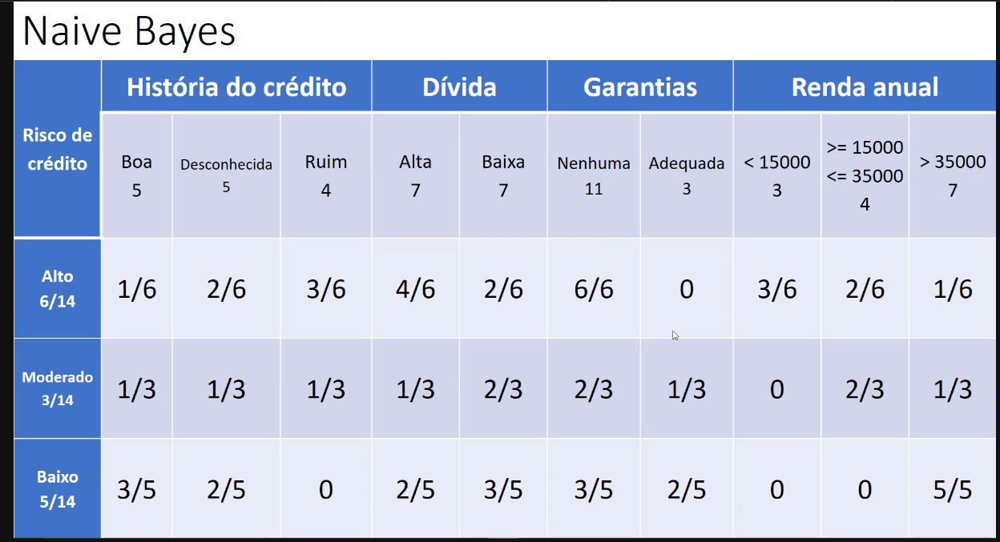

 Com base na nossa tabela já feita.
 - O algortimo com base nessa tabela ele irá fazer a classificação de novos registros retornando em probabilidades

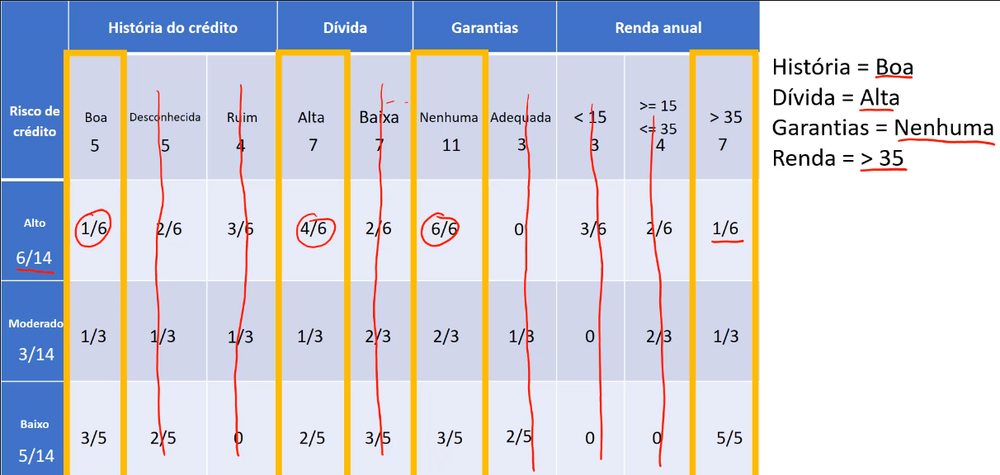

**Exemplo:**

Um novo cliente chega no banco e pede um emprestimo, o gerente irá avaliar qual será o risco de crédito baseado nas informações do cliente:

- História do crédito: Boa
- Dívida = Alta
- Garantias = Nenhuma
- Renda => 35

O algoritmo irá dizer qual será o Risco.

Com base nas informações o  algortimo ira selecionar:

- A coluna onde somente a historia de credito é boa
- A coluna onde somente a divida é alta
- A coluna onde somente a garantia é nenhuma
- A coluna onde somente a renda é =>35

Estimativa para Risco Alto
P(Alto) = 6/14 * 1/6 * 4/6 * 6/6 * 1/6 = 0,0079

Estimativa pra Risco Moderado
P(Moderado) = 3/14 * 1/3 * 1/3 * 2/3 * 1/3 = 0,0052

Estimativa para Risco Baixo
P(Baixo) = 5/14 * 3/5 * 2/5 * 3/5 * 5/5 = 0,0514

**Comparando os valores, a probabilidade do risco ser Baixo é maior de todas, esse novo cliente tem um risco baixo.**

--------------------------------------------------
Para retornar o valor em porcentagem fazemos:
--------------------------------------------------

**Soma: 0.0079 + 0.0052 + 0.0514 = 0.0645 (Considerado o 100%)**

**Alto: 0,0079/ 0,0645 * 100 = 12,24% de probabilidade**

**Moderado: 0,0052 / 0,0645 * 100 = 8,06% de probabilidade**

**Baixo: 0,0514 / 0,0645 * 100 = 79,68% de probabilidade**

## Correção Laplaciana

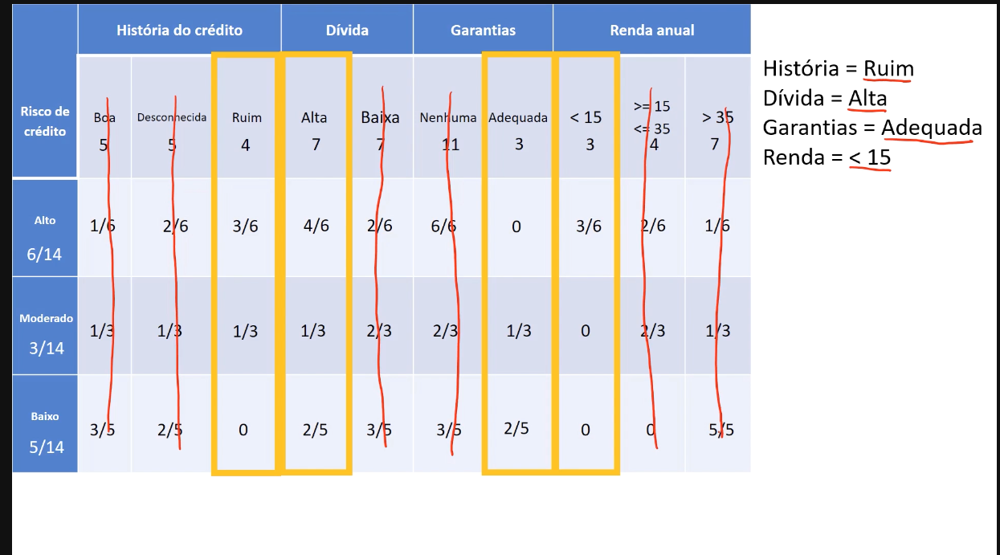

- História do crédito: Ruim
- Dívida = Alta
- Garantias = Adequada
- Renda =< 15

Estimativa para Risco Alto
P(Alto)= 6/14 * 3/6 * 4/6 * 0 * 3/6 = 0

Estimativa para Risco Moderado
P(Moderado)= 3/14 * 1/3 * 1/3 * 1/3 * 0 = 0

Estimativa para Risco Baixo
P(Baixo)= 5/14 * 0 * 2/5 * 2/5 * 0 = 0

Nesse caso não conseguimos fazer a previsão pois todas as probabilidades deram 0 porém, temos um artificio no algoritmo Naive Bayes que é a correção laplaciana, para base de dados pequenas caso tenha valores zerados ele precisara fazer uma correção adicionando um registro para evitar multiplicação por zero. A correção irá adicionar um registro adicional onde há zero.

No caso de Historia de Credito Ruim:

Quando o risco for baixo e historia de credito ruim temos 0
Devemos adicionar um evento no lugar de zero.

Risco de Credito Baixo: 5/14
Historia de credito RUim: adiciona 1/5 pois temos 5 eventos em 14 no Risco de credito o que buscamos.
Quando adicionamos 1 registro temos que adicionar em todos entao teremos:

Risco de Credito: 5/14 --> 6/15
Hist de Credito Ruim: como temos 6 registros no total entao será 1/6
Agorao total de ruins nao será 4 mas sim 5
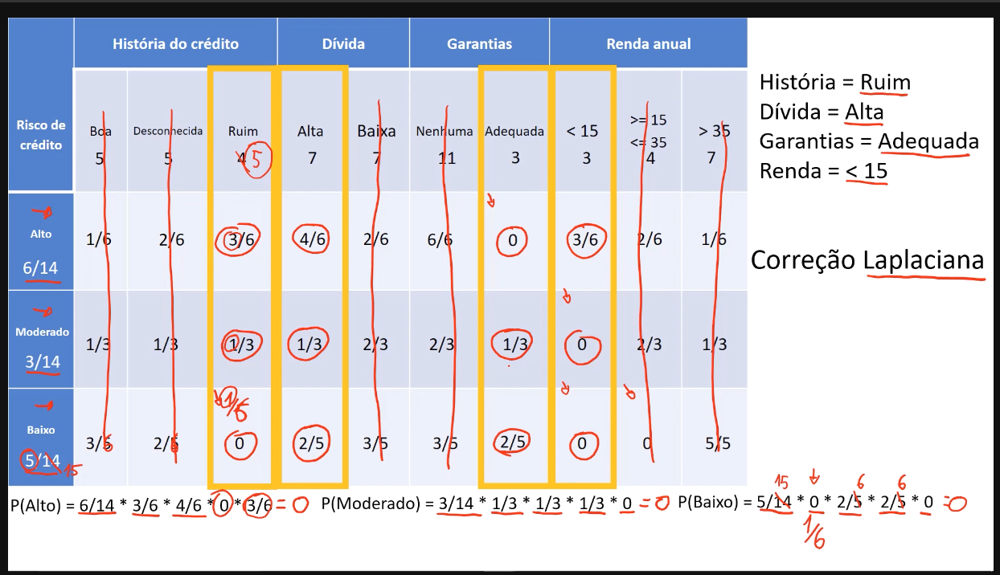

**TODOS OS TERMOS QUE SÃO 0 SERÃO MOTIFICADOS ASSIM RESULTANDO EM NOVAS PROBABILIDADES**

Mais exemplos:

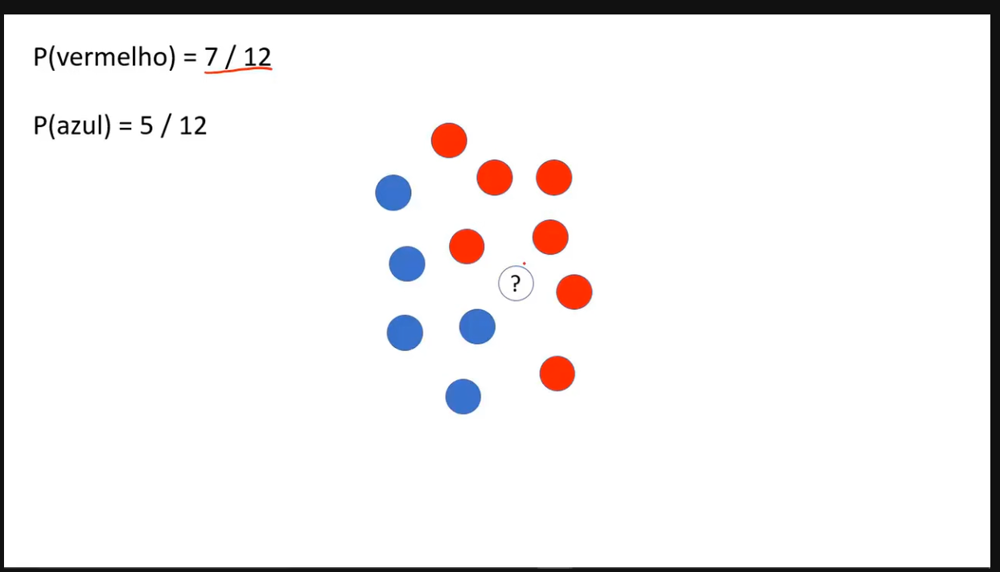

Vamos calcular qual a probabilidade da nova bolinha?
Existe uma uma propriedade que se chama Radius

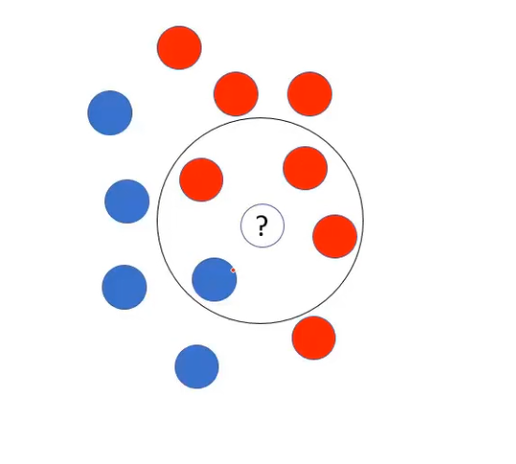

A probabilidade total é:
P(vermelho) = 7/12
P(azul) = 5/12

**O centro da cirdunferencia será a bolinha que estamos buscando e a partir dali temos um raio que englobará as bolinhas ao redor.**
A probabilidade nova é:
P'(vermelho) = 3/7
P'(azul) = 1/5

Essa probabilidade são chamadas de **PROBABILIDADES APRIORI**, pois conhecemos com antecedencia.

**Calculando a probabilidade final de qual cor seria a nova bolinha**
------------------------------------------------------------------------
P"(vermelho) = 7/12 * 3/7 = 21/84 = 0,25 **São as probabilidade posteriori**

P"(azul) = 5/12 * 1/5 = 5/60 = 0,08 **São as probabilidade posteriori**

Resultando = Bolinha seria vermelha

**Vantagens x Desvantagens**

- **Vantagens:**
    - Rápido
    - Simplicidade de interpretação
    - Trabalha com altas dimensões
    - Boas previsões em bases pequenas

- **Desvantagens:**
    - Combinação de caracteristicas (atributos independentes) - cada par de caracteristicas são independeten - nem sempre é verdade.
    

## Base Risco Crédito - Aplicando Naive Bayes

In [ ]:
from sklearn.naive_bayes import GaussianNB #importando o algoritmo do GaussianNaiveBayes


In [ ]:
base_risco_credito = pd.read_csv('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/risco_credito.csv')
base_risco_credito


,historia,divida,garantias,renda,risco
0,ruim,alta,nenhuma,0_15,alto
1,desconhecida,alta,nenhuma,15_35,alto
2,desconhecida,baixa,nenhuma,15_35,moderado
3,desconhecida,baixa,nenhuma,acima_35,alto
4,desconhecida,baixa,nenhuma,acima_35,baixo
5,desconhecida,baixa,adequada,acima_35,baixo
6,ruim,baixa,nenhuma,0_15,alto
7,ruim,baixa,adequada,acima_35,moderado
8,boa,baixa,nenhuma,acima_35,baixo
9,boa,alta,adequada,acima_35,baixo


In [ ]:
#PreProcessamento - divindo dataset em X e Y
X_risco_credito = base_risco_credito.iloc[:,0:4].values
X_risco_credito



array([['ruim', 'alta', 'nenhuma', '0_15'],
       ['desconhecida', 'alta', 'nenhuma', '15_35'],
       ['desconhecida', 'baixa', 'nenhuma', '15_35'],
       ['desconhecida', 'baixa', 'nenhuma', 'acima_35'],
       ['desconhecida', 'baixa', 'nenhuma', 'acima_35'],
       ['desconhecida', 'baixa', 'adequada', 'acima_35'],
       ['ruim', 'baixa', 'nenhuma', '0_15'],
       ['ruim', 'baixa', 'adequada', 'acima_35'],
       ['boa', 'baixa', 'nenhuma', 'acima_35'],
       ['boa', 'alta', 'adequada', 'acima_35'],
       ['boa', 'alta', 'nenhuma', '0_15'],
       ['boa', 'alta', 'nenhuma', '15_35'],
       ['boa', 'alta', 'nenhuma', 'acima_35'],
       ['ruim', 'alta', 'nenhuma', '15_35']], dtype=object)

In [ ]:
Y_risco_credito = base_risco_credito.iloc[:,4].values
Y_risco_credito

array(['alto', 'alto', 'moderado', 'alto', 'baixo', 'baixo', 'alto',
       'moderado', 'baixo', 'baixo', 'alto', 'moderado', 'baixo', 'alto'],
      dtype=object)

In [ ]:
#Aplicando LabelEnconder, base é pequena nao precisa OneHotEnconder
from sklearn.preprocessing import LabelEncoder
label_encoder_historia = LabelEncoder()
label_encoder_divida = LabelEncoder()
label_encoder_garantia = LabelEncoder()
label_encoder_renda = LabelEncoder()


In [ ]:
X_risco_credito[:,0] = label_encoder_historia.fit_transform(X_risco_credito[:,0])
X_risco_credito[:,1] = label_encoder_divida.fit_transform(X_risco_credito[:,1])
X_risco_credito[:,2] = label_encoder_garantia.fit_transform(X_risco_credito[:,2])
X_risco_credito[:,3] = label_encoder_renda.fit_transform(X_risco_credito[:,3])

In [ ]:
X_risco_credito

array([[2, 0, 1, 0],
       [1, 0, 1, 1],
       [1, 1, 1, 1],
       [1, 1, 1, 2],
       [1, 1, 1, 2],
       [1, 1, 0, 2],
       [2, 1, 1, 0],
       [2, 1, 0, 2],
       [0, 1, 1, 2],
       [0, 0, 0, 2],
       [0, 0, 1, 0],
       [0, 0, 1, 1],
       [0, 0, 1, 2],
       [2, 0, 1, 1]], dtype=object)

In [ ]:
base_risco_credito

,historia,divida,garantias,renda,risco
0,2,0,1,0,alto
1,1,0,1,1,alto
2,1,1,1,1,moderado
3,1,1,1,2,alto
4,1,1,1,2,baixo
5,1,1,0,2,baixo
6,2,1,1,0,alto
7,2,1,0,2,moderado
8,0,1,1,2,baixo
9,0,0,0,2,baixo


In [ ]:
import pickle
with open('risco_credito.pkl', mode = 'wb') as f:
  pickle.dump([X_risco_credito, Y_risco_credito], f)

In [ ]:
#Criando o algoritmo naive bayes
naive_risco_credito = GaussianNB()
naive_risco_credito.fit(X_risco_credito, Y_risco_credito)


GaussianNB()

In [ ]:
previsao = naive_risco_credito.predict([[0,0,1,2], [2,0,0,0]])
previsao

array(['baixo', 'moderado'], dtype='<U8')

In [ ]:
naive_risco_credito.classes_

array(['alto', 'baixo', 'moderado'], dtype='<U8')

In [ ]:
naive_risco_credito.class_count_

array([6., 5., 3.])

In [ ]:
naive_risco_credito.class_prior_ #Classes apriori

array([0.42857143, 0.35714286, 0.21428571])

## Base Crédito - Aplicando Naive Bayes

In [ ]:
with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit.pkl', 'rb') as f:
 X_credit_treinamento,Y_credit_treinamento,X_credit_teste,Y_credit_teste = pickle.load(f)

In [ ]:
X_credit_treinamento.shape,Y_credit_treinamento.shape

((1500, 3), (1500,))

In [ ]:
X_credit_teste.shape,Y_credit_teste.shape

((500, 3), (500,))

In [ ]:
naive_credit = GaussianNB()
naive_credit.fit(X_credit_treinamento, Y_credit_treinamento)

GaussianNB()

In [ ]:
previsoes = naive_credit.predict(X_credit_teste)
previsoes

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
Y_credit_teste

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report #Importando  modulos para mediçao de acuracia

In [ ]:
accuracy_score(Y_credit_teste, previsoes)

0.938

In [ ]:
cm=confusion_matrix(Y_credit_teste, previsoes)
cm

array([[428,   8],
       [ 23,  41]])

In [ ]:
class_labels = np.unique(Y_credit_teste)
df_cm = pd.DataFrame(cm, index=class_labels, columns=class_labels)

In [ ]:
class_labels

array([0, 1])

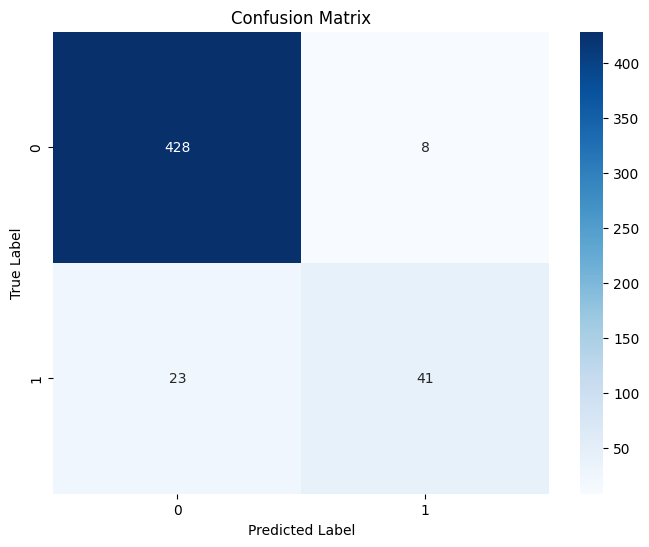

In [ ]:
    plt.figure(figsize=(8, 6))
    sns.heatmap(df_cm, annot=True, fmt='d', cmap='Blues', cbar=True)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

In [ ]:
from yellowbrick.classifier import ConfusionMatrix

/usr/local/lib/python3.12/dist-packages/yellowbrick/classifier/base.py:251: YellowbrickWarning:

both classes and encoder specified, using encoder

/usr/local/lib/python3.12/dist-packages/yellowbrick/classifier/base.py:251: YellowbrickWarning:

both classes and encoder specified, using encoder

/usr/local/lib/python3.12/dist-packages/yellowbrick/classifier/base.py:309: YellowbrickWarning:

both classes and encoder specified, using encoder

/usr/local/lib/python3.12/dist-packages/yellowbrick/classifier/base.py:309: YellowbrickWarning:

both classes and encoder specified, using encoder



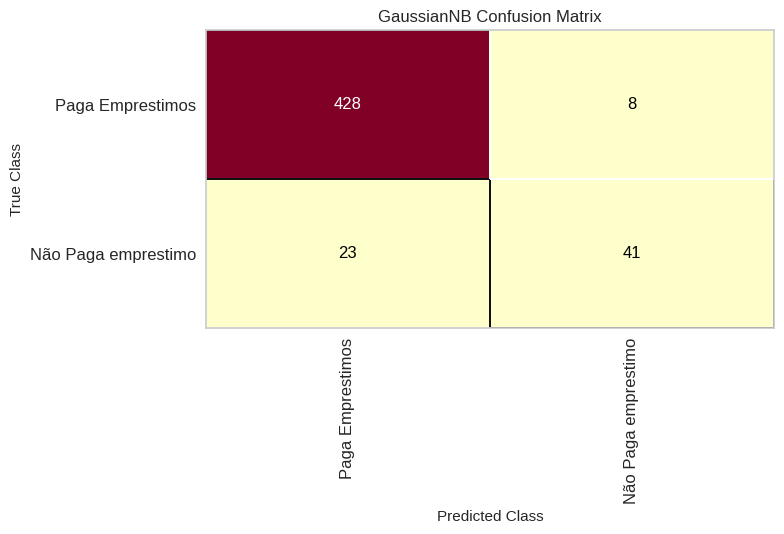

In [ ]:
#Usando já uma matrix de consufsao pronta

#ConfusionMatrix(model,classes)
classes = [0,1]
cm1 = ConfusionMatrix(GaussianNB(),classes=classes,
                      encoder={0:'Paga Emprestimos', 1:'Não Paga emprestimo'})
cm1.fit(X_credit_treinamento, Y_credit_treinamento);
cm1.score(X_credit_teste, Y_credit_teste);
cm1.show();


In [ ]:
print(classification_report(Y_credit_teste, previsoes))


              precision    recall  f1-score   support

           0       0.95      0.98      0.97       436
           1       0.84      0.64      0.73        64

    accuracy                           0.94       500
   macro avg       0.89      0.81      0.85       500
weighted avg       0.93      0.94      0.93       500



In [ ]:
with open('/content/census.pkl', 'rb') as f:
  X_census_treinamento,Y_census_treinamento,X_census_teste,Y_census_teste = pickle.load(f)

In [ ]:
X_census_treinamento.shape, Y_census_treinamento.shape

((24420, 108), (24420,))

In [ ]:
X_census_teste.shape, Y_census_teste.shape

((8141, 108), (8141,))

In [ ]:
naive_census = GaussianNB()
naive_census.fit(X_census_treinamento, Y_census_treinamento)

GaussianNB()

In [ ]:
previsoes = naive_census.predict(X_census_teste)
previsoes

array([' >50K', ' >50K', ' >50K', ..., ' >50K', ' >50K', ' >50K'],
      dtype='<U6')

In [ ]:
Y_census_teste

array([' >50K', ' >50K', ' <=50K', ..., ' <=50K', ' <=50K', ' <=50K'],
      dtype=object)

In [ ]:
cm = confusion_matrix(Y_census_teste, previsoes)
cm

array([[1679, 4488],
       [  77, 1897]])

In [ ]:
classe_labels = np.unique(Y_census_teste)
classe_labels

array([' <=50K', ' >50K'], dtype=object)

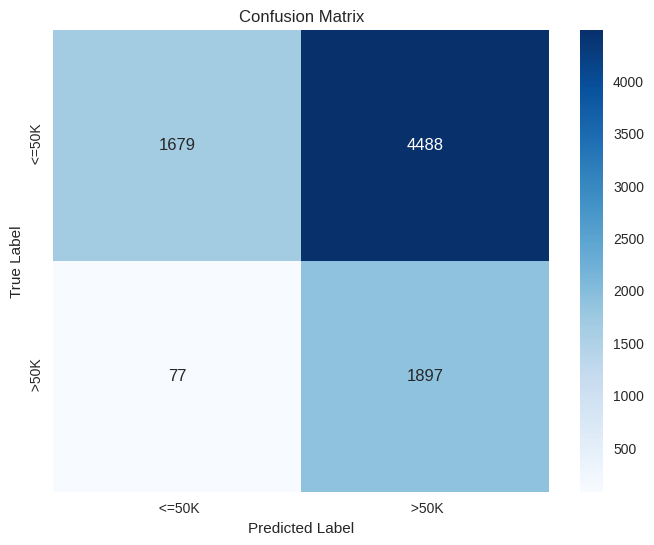

In [ ]:
classe_labels = np.unique(Y_census_teste)
df_cm = pd.DataFrame(cm, index=classe_labels, columns=classe_labels)
plt.figure(figsize=(8, 6))
sns.heatmap(df_cm, annot=True, fmt='d', cmap='Blues', cbar=True)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show();

In [ ]:
from sklearn.tree import DecisionTreeClassifier, plot_tree

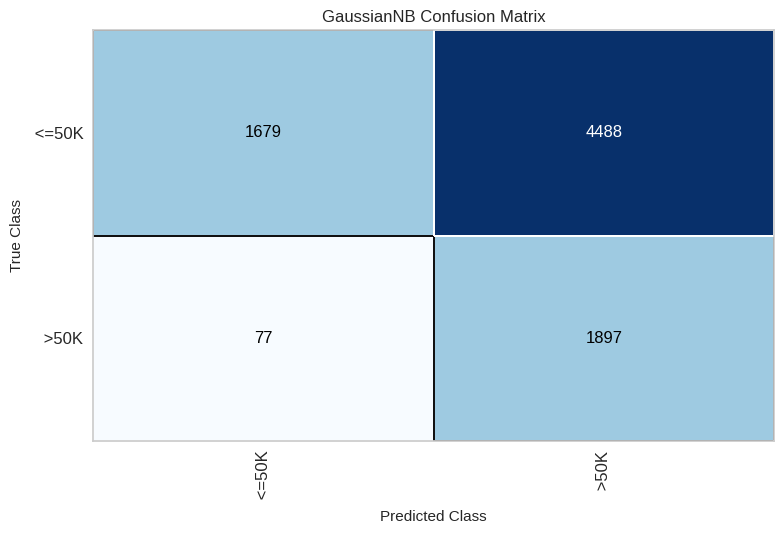

In [ ]:
cm2 = ConfusionMatrix(GaussianNB(),cmap='Blues')
cm2.fit(X_census_treinamento, Y_census_treinamento);
cm2.score(X_census_teste, Y_census_teste);
cm2.show();

In [ ]:
accuracy_score(Y_census_teste, previsoes)

0.43925807640339026

In [ ]:
print(classification_report(Y_census_teste, previsoes))

              precision    recall  f1-score   support

       <=50K       0.96      0.27      0.42      6167
        >50K       0.30      0.96      0.45      1974

    accuracy                           0.44      8141
   macro avg       0.63      0.62      0.44      8141
weighted avg       0.80      0.44      0.43      8141



TESTANDO COM ARVORE DE DECISÃO

In [ ]:
#Usando arvore de decisão
tree_census = DecisionTreeClassifier(criterion='entropy', random_state=38)
tree_census.fit(X_census_treinamento, Y_census_treinamento)

DecisionTreeClassifier(criterion='entropy', random_state=38)

In [ ]:
previsoes = tree_census.predict(X_census_teste)
previsoes

array([' >50K', ' <=50K', ' <=50K', ..., ' <=50K', ' >50K', ' >50K'],
      dtype=object)

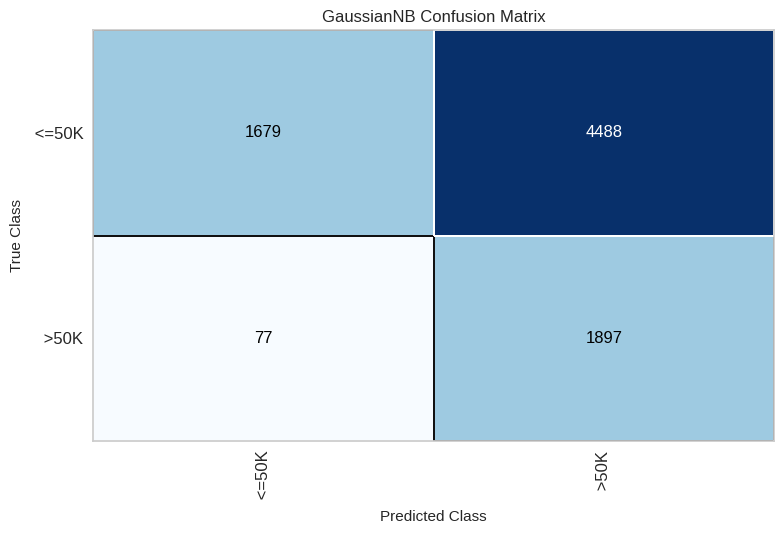

In [ ]:
cm3 = ConfusionMatrix(GaussianNB(),cmap='Blues')
cm3.fit(X_census_treinamento, Y_census_treinamento);
cm3.score(X_census_teste, Y_census_teste);
cm3.show();

In [ ]:
accuracy_score(Y_census_teste, previsoes)

0.8253285837120747

In [ ]:
print(classification_report(Y_census_teste, previsoes))

              precision    recall  f1-score   support

       <=50K       0.88      0.89      0.88      6167
        >50K       0.64      0.64      0.64      1974

    accuracy                           0.83      8141
   macro avg       0.76      0.76      0.76      8141
weighted avg       0.83      0.83      0.83      8141



# **ARVORES DE DECISÃO**

## Introdução

Iremos utilizar as mesmas bases de dados:

- Base risco crédito
- Base crédito
- Base census

Abaixo um exemplo de Arvore de Decisao

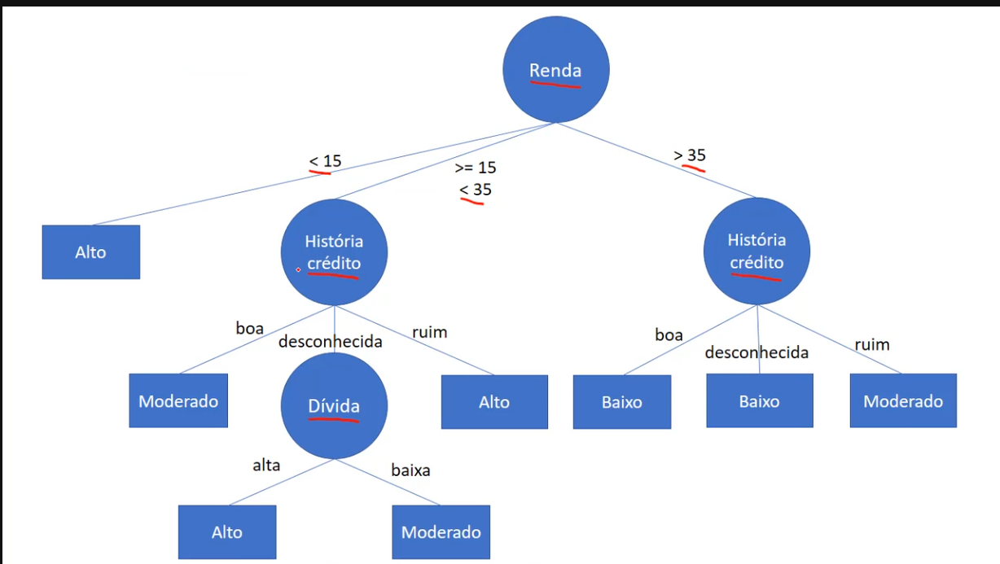

No exemplo acima da nossa arvore de decisão o ponto inicial a ser verificado é a Renda, e partir das regras sob a renda o algoritmo vai descendo através dos ramos até chegar nas folhas (classes) que nos da a classificação final.

Para chegar numa versão final de um arvore de decisão existem vários calculos matematicos que sao realizado para efetivamente fazer o treinamento para justamente encontrar a ordem de cada ramo e classificar o atributo de acordo com sua importância.

O treinamento numa arvore de deciso é justamente encontrar a ordem dos atributos.

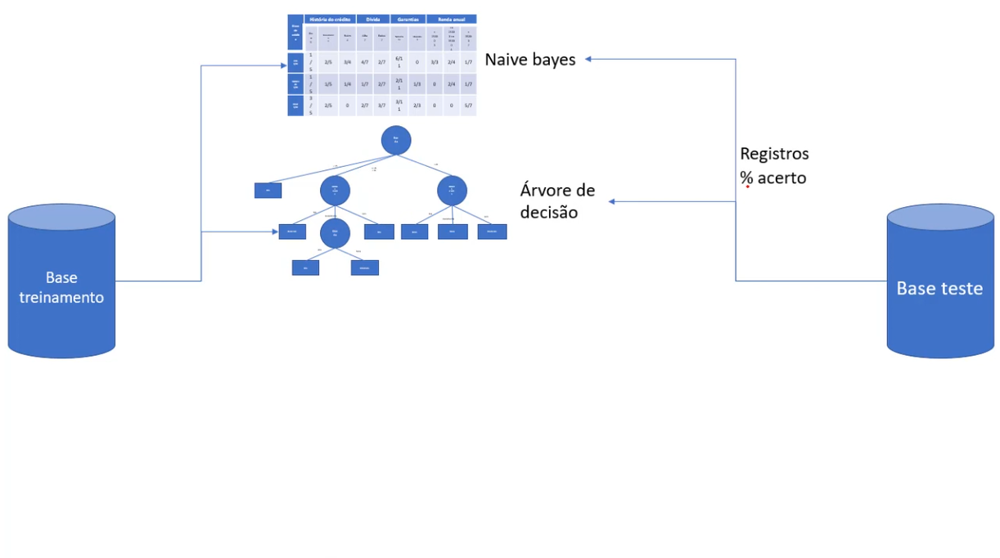

## Aprendizagem

Como funciona a geração de arvore de decisao a partir de uma base de dados:

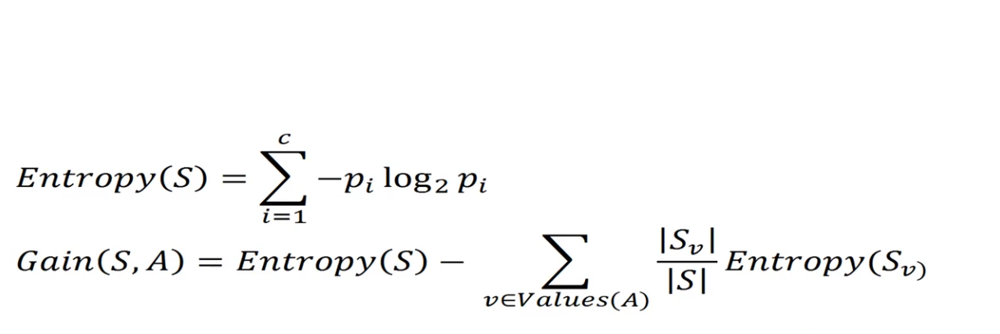


Inicialmente vamos fazer um calculo de entropia para toda base de dados?

**Primeiramente pegamos os valores de frequencia das classes:**

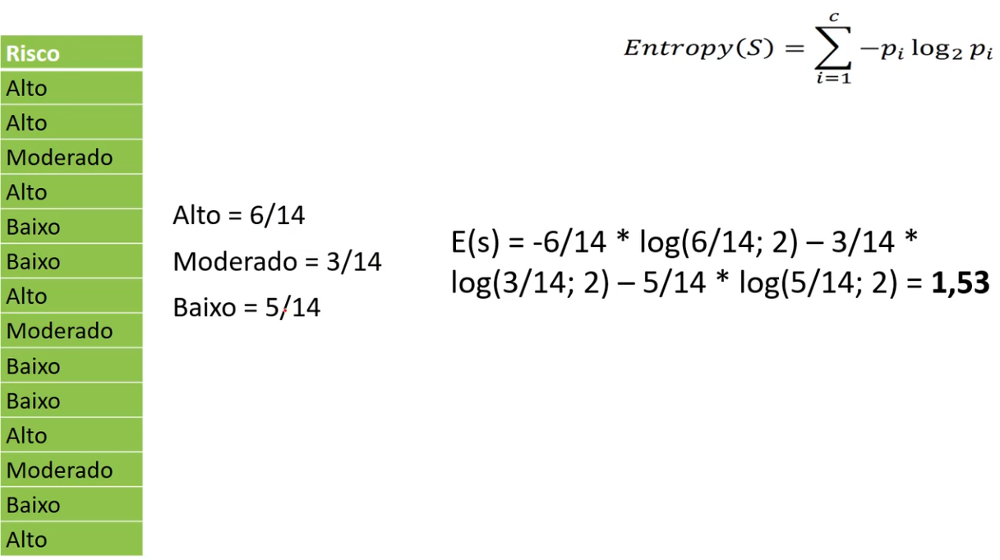


**Pi** são os valores de frequencia.
**A ENTROPIA SERÁ CALCULA NÃO SOMENTE PARA AS CLASSES MAS PARA TODOS OS RAMOS PERTINENTES DA ÁRVORE, COMO SERÁ VISTO A SEGUIR**

Na construção de árvores de decisão, a entropia é uma medida da incerteza ou impureza de um conjunto de dados em relação à variável-alvo. O objetivo do algoritmo é dividir os dados de forma a reduzir a entropia, tornando os subconjuntos resultantes mais homogêneos e puros. Uma entropia zero indica um conjunto completamente puro (uma única classe), enquanto um valor máximo de entropia indica um conjunto misto e desorganizado. As divisões são escolhidas para maximizar o ganho de informação, o que é equivalente a minimizar a entropia após a divisão.

Gain(S,A) ganho de informação deve ser feito para todas as features, no nosso caso teremos:

- G(historia)
- G(divida)
- G(garantias)
- G(renda)

Aquele atributo que tiver maior ganho é aquele com maior significancia resultando na raiz da arvore (ponto inicial).

Exemplo:

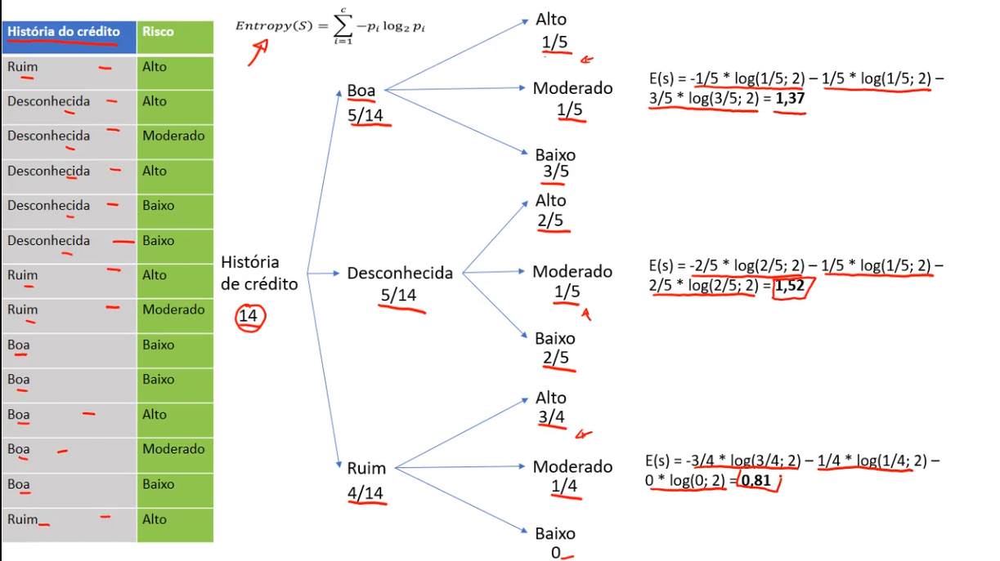

No exemplo observe que temos um valor 0 para Historia do Credito Ruim & Risco Baixo. Na entropia quando temos esse valor o algoritmo descartará esse termo com valor Zero.

**Entropia(S) é a entropia feita para a classe**
**Sv/S é a frequencia de cada atributo sobre o total**
**Entropia(Sv) é a entropia de cada atributo**

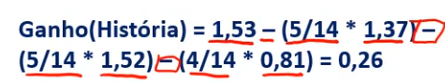


- 1,53 Entropia(S) da classe
- 5/14, 5/14 e 4/14 distruibuição de frequencia da Historia de credito Boa, Desconhecida e Ruim
- 1,37 ; 1,52 e 0,81 são as são Entropia(Sv) de cada feature.

Ganho(Historia de Crédito) = 0,2664

**Esses calculos são feitos para todas as features**

Após todos os calculos de Ganhos temos os seguintes valores:

- História de crédito = 0,26
- Dívida = 0,06
- Garantias = 0,20
- Renda = 0,66

Observemos que a **RENDA** tem o maior ganho por isso no algoritmo de arvore será a Raiz (ponto inicial), e para cada ramo a partir da raiz novamente fazemos calculo de entropia e ganho até chegar no resultado final

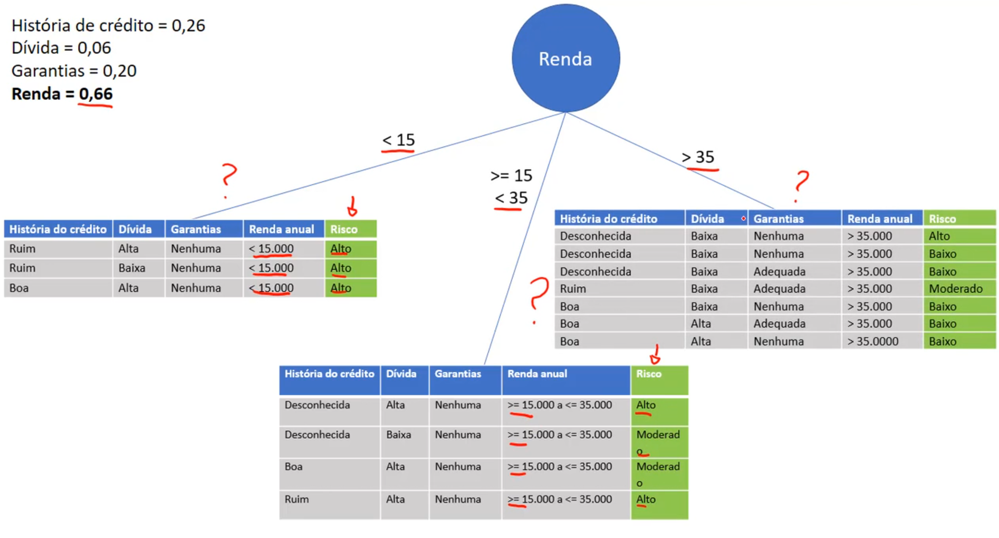

**RESUMINDO**
Uma árvore de decisão é um modelo de aprendizado supervisionado usado para classificação ou regressão. Ela divide os dados em subconjuntos com base em perguntas (ou condições) sobre os atributos, até chegar a uma decisão final (classe ou valor).

A entropia mede o grau de desordem ou impureza de um conjunto de dados. Quanto mais misturadas as classes, maior a entropia.

Entropia(S)=−i=1∑n​pi​log2​(pi​)

Onde:

pi​ é a proporção de elementos da classe i no conjunto S.
Imagine um conjunto de dados com 10 amostras:

6 são da classe "Sim"
4 são da classe "Não"

A entropia será:

Entropia=−(106​log2​106​+104​log2​104​)≈0.971

O ganho de informação mede a redução da entropia ao dividir o conjunto com base em um atributo. É usado para escolher o melhor atributo para fazer a divisão.

Onde:

- S é o conjunto original
- A é o atributo
- Sv é o subconjunto onde o atributo  tem valor v



## Conceito de poda


O conceito de poda é: geramos uma árvore de decisão e depois, retiramos (poda) nos atributos que tem pouco ganho de informação.

- Bias (viés)
  - Erros por classificação errada
- Variância
  - Erros por sensibilidade pequena a mudanças na base de treinamento
  - Pode levar a overfitting
  


## Arvore de decisão - base risco crédito


In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/risco_credito.pkl', 'rb') as f:
    X_risco_credito, Y_risco_credito = pickle.load(f)

In [ ]:
X_risco_credito.shape, Y_risco_credito.shape

((14, 4), (14,))

In [ ]:
X_risco_credito

array([[2, 0, 1, 0],
       [1, 0, 1, 1],
       [1, 1, 1, 1],
       [1, 1, 1, 2],
       [1, 1, 1, 2],
       [1, 1, 0, 2],
       [2, 1, 1, 0],
       [2, 1, 0, 2],
       [0, 1, 1, 2],
       [0, 0, 0, 2],
       [0, 0, 1, 0],
       [0, 0, 1, 1],
       [0, 0, 1, 2],
       [2, 0, 1, 1]], dtype=object)

In [ ]:
Y_risco_credito

array(['alto', 'alto', 'moderado', 'alto', 'baixo', 'baixo', 'alto',
       'moderado', 'baixo', 'baixo', 'alto', 'moderado', 'baixo', 'alto'],
      dtype=object)

In [ ]:
arvore = DecisionTreeClassifier(criterion='entropy')
arvore.fit(X_risco_credito, Y_risco_credito)

DecisionTreeClassifier(criterion='entropy')

In [ ]:
arvore.feature_importances_ #importancia de cada atributos

array([0.48015651, 0.06408636, 0.03885431, 0.41690281])

In [ ]:
arvore.get_params()

{'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'entropy',
 'max_depth': None,
 'max_features': None,
 'max_leaf_nodes': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'monotonic_cst': None,
 'random_state': None,
 'splitter': 'best'}

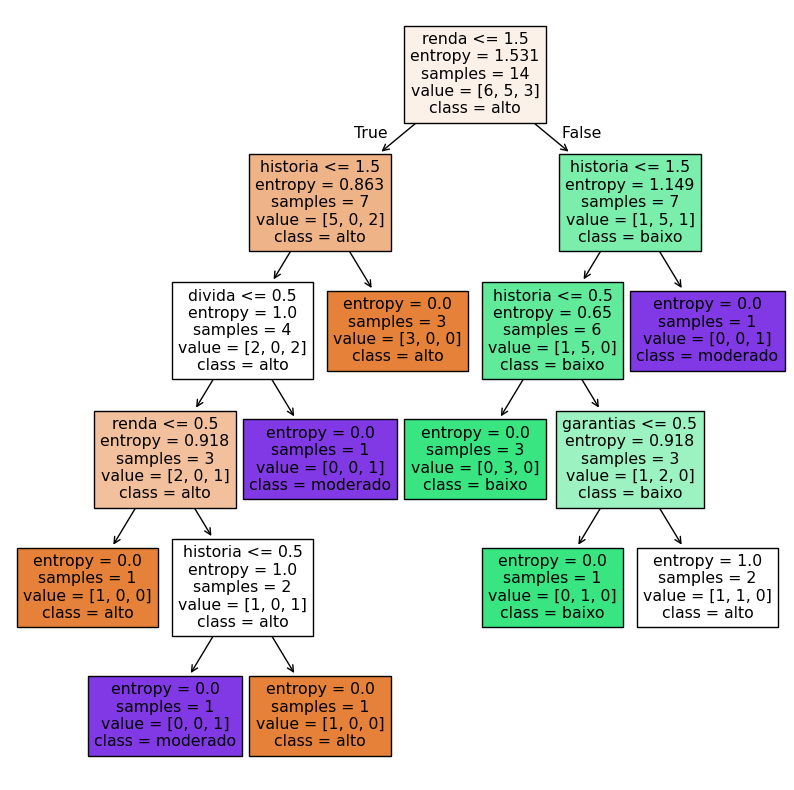

In [ ]:
from sklearn import tree
previsores = ['historia', 'divida', 'garantias', 'renda'] #lista que esta em sequencia com a feature_importances_
fig, ax = plt.subplots(1,1, figsize=(10, 10))
tree.plot_tree(arvore, filled=True, feature_names=previsores,class_names=arvore.classes_);

In [ ]:
previsoes = arvore.predict([[0,0,1,2],[2,0,0,0]]) #listas são os dados de entrada para teste, já com label enconder
previsoes

array(['baixo', 'alto'], dtype=object)

##Usando Pipeline para passar os valores em termos qualitativos

In [ ]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.impute import SimpleImputer

In [ ]:
base_credito_pd = pd.read_csv('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/risco_credito.csv')

In [ ]:
base_credito_pd

,historia,divida,garantias,renda,risco
0,ruim,alta,nenhuma,0_15,alto
1,desconhecida,alta,nenhuma,15_35,alto
2,desconhecida,baixa,nenhuma,15_35,moderado
3,desconhecida,baixa,nenhuma,acima_35,alto
4,desconhecida,baixa,nenhuma,acima_35,baixo
5,desconhecida,baixa,adequada,acima_35,baixo
6,ruim,baixa,nenhuma,0_15,alto
7,ruim,baixa,adequada,acima_35,moderado
8,boa,baixa,nenhuma,acima_35,baixo
9,boa,alta,adequada,acima_35,baixo


In [ ]:
X = base_credito_pd.iloc[:,0:4].values
Y = base_credito_pd.iloc[:,4].values

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X,Y,test_size=0.2)

In [ ]:
#Criando Pipeline: enconder + modelo
pipe = Pipeline([("encoder",OneHotEncoder()),
                 ("imputer", SimpleImputer(missing_values=np.nan, strategy='mean')),
                ("modelo", DecisionTreeClassifier())], verbose=True)

In [ ]:
pipe.fit(X_train, y_train)

[Pipeline] ........... (step 1 of 3) Processing encoder, total=   0.0s
[Pipeline] ........... (step 2 of 3) Processing imputer, total=   0.0s
[Pipeline] ............ (step 3 of 3) Processing modelo, total=   0.0s


Pipeline(steps=[('encoder', OneHotEncoder()), ('imputer', SimpleImputer()),
                ('modelo', DecisionTreeClassifier())],
         verbose=True)

In [ ]:
novo_cliente = [["boa", "alta", "nenhuma", "15_35"],["ruim","alta","nenhuma","0_15"]]

In [ ]:
previsao = pipe.predict(novo_cliente)
print("Risco previsto:", previsao[0],'&',previsao[1])

Risco previsto: moderado & alto


In [ ]:
score=pipe.score(X_test, y_test)
print("Acurácia:", score)

Acurácia: 0.6666666666666666


In [ ]:
previsao

array(['moderado', 'alto'], dtype=object)

## Arvore de decisão - Base Crédito

In [ ]:
with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit.pkl', 'rb') as f:
    X_credit_train, Y_credit_train, X_credit_teste,Y_credit_teste = pickle.load(f)

In [ ]:
X_credit_train.shape, Y_credit_train.shape

((1500, 3), (1500,))

In [ ]:
X_credit_teste.shape, Y_credit_teste.shape

((500, 3), (500,))

In [ ]:
arvore_credito = DecisionTreeClassifier(criterion='entropy', random_state=38)
arvore_credito.fit(X_credit_train, Y_credit_train)

DecisionTreeClassifier(criterion='entropy', random_state=38)

In [ ]:
arvore_credito.feature_importances_

array([0.21444103, 0.39503611, 0.39052286])

In [ ]:
previsao = arvore_credito.predict(X_credit_teste)
previsao

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
Y_credit_teste

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
accuracy_score(Y_credit_teste, previsao)

0.984

In [ ]:
print(classification_report(Y_credit_teste, previsao))

              precision    recall  f1-score   support

           0       1.00      0.99      0.99       436
           1       0.91      0.97      0.94        64

    accuracy                           0.98       500
   macro avg       0.95      0.98      0.97       500
weighted avg       0.98      0.98      0.98       500



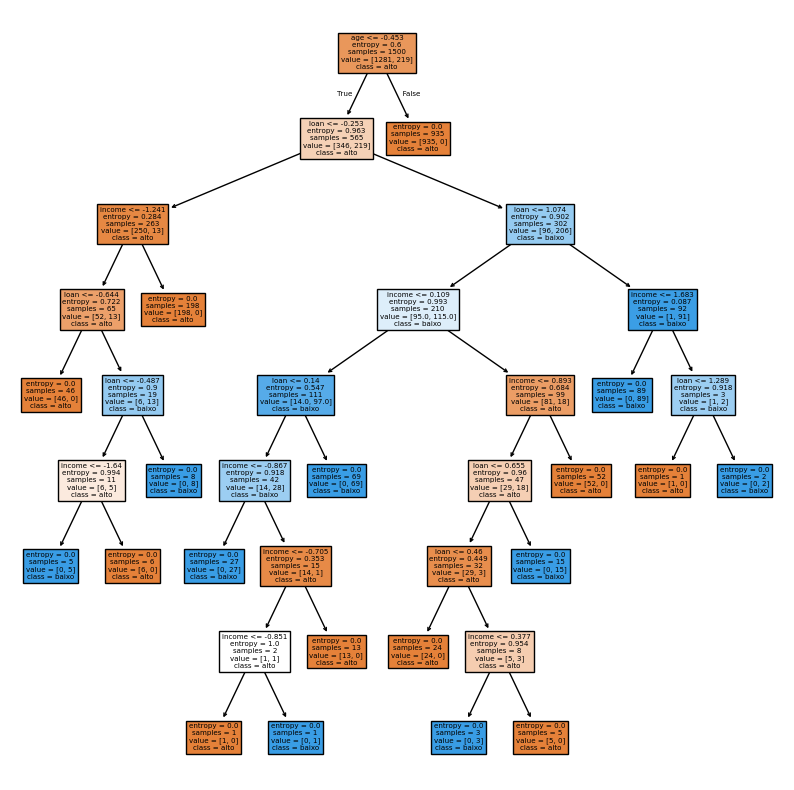

In [ ]:
from sklearn import tree
previsores = ['income', 'age', 'loan'] #lista que esta em sequencia com a feature_importances_
fig, ax = plt.subplots(1,1, figsize=(10, 10))
tree.plot_tree(arvore_credito, filled=True, feature_names=previsores,class_names=arvore.classes_);
fig.savefig('arvore_credito.png')

**USANDO XGBoost**

In [ ]:
from xgboost import XGBClassifier

In [ ]:
arvore_xg = XGBClassifier()
arvore_xg.fit(X_credit_train, Y_credit_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              feature_weights=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=None,
              n_jobs=None, num_parallel_tree=None, ...)

In [ ]:
previsao_xg = arvore_xg.predict(X_credit_teste)
previsao_xg

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
accuracy_score(Y_credit_teste, previsao_xg)

0.986

In [ ]:
print(classification_report(Y_credit_teste, previsao_xg))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       436
           1       0.94      0.95      0.95        64

    accuracy                           0.99       500
   macro avg       0.97      0.97      0.97       500
weighted avg       0.99      0.99      0.99       500



In [ ]:
from xgboost import plot_tree

<Figure size 2000x1000 with 0 Axes>

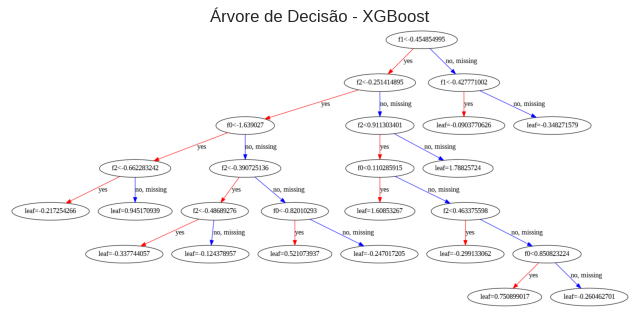

In [ ]:

plt.figure(figsize=(20, 10))
plot_tree(arvore_xg, tree_idx=0)  # num_trees=0 indica a primeira árvore
plt.title("Árvore de Decisão - XGBoost");
plt.show();


## Arvore de decisão - Base Census

In [ ]:
with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/census.pkl', 'rb') as f:
    X_census_train, Y_census_train, X_census_teste,Y_census_teste = pickle.load(f)

In [ ]:
X_census_train.shape, Y_census_train.shape

((27676, 108), (27676,))

In [ ]:
X_census_teste.shape, Y_census_teste.shape

((4885, 108), (4885,))

In [ ]:
arvore_census = DecisionTreeClassifier(criterion='entropy', random_state=38)
arvore_census.fit(X_census_train, Y_census_train)

DecisionTreeClassifier(criterion='entropy', random_state=38)

In [ ]:
previsao_census = arvore_census.predict(X_census_teste)
previsao_census

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' >50K'],
      dtype=object)

In [ ]:
Y_census_teste

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' <=50K'],
      dtype=object)

In [ ]:
accuracy_score(Y_census_teste, previsao_census)

0.8122824974411463

In [ ]:
arvore_census.feature_importances_

array([2.20517015e-03, 4.89810598e-03, 5.39283752e-03, 0.00000000e+00,
       9.61053478e-03, 5.04687517e-03, 9.68923644e-03, 5.63490061e-03,
       0.00000000e+00, 5.83341330e-05, 4.04666330e-04, 4.48095143e-04,
       1.97527186e-04, 2.72071098e-04, 2.47878977e-04, 4.82195675e-04,
       1.08946796e-03, 2.02610702e-03, 3.01841892e-03, 4.91862563e-04,
       8.45188484e-04, 2.60449494e-03, 0.00000000e+00, 5.41949685e-04,
       4.16708964e-03, 2.21700903e-03, 0.00000000e+00, 1.93033085e-01,
       9.23006595e-04, 3.00626090e-03, 1.88719500e-03, 7.29201078e-04,
       8.19074513e-04, 6.32652810e-03, 0.00000000e+00, 6.72271743e-03,
       8.74113314e-03, 3.85182831e-03, 1.89809861e-03, 4.91450975e-03,
       4.92139060e-03, 0.00000000e+00, 7.45566779e-03, 4.25468638e-03,
       7.04581014e-03, 4.12001454e-03, 6.85314306e-03, 1.51293042e-03,
       2.97106888e-03, 9.35521021e-04, 1.21058793e-03, 1.51564312e-03,
       5.07780502e-03, 8.26448748e-04, 1.74289086e-03, 4.60808773e-03,
      

In [ ]:
print(classification_report(Y_census_teste, previsao_census))

              precision    recall  f1-score   support

       <=50K       0.87      0.88      0.88      3693
        >50K       0.62      0.61      0.61      1192

    accuracy                           0.81      4885
   macro avg       0.75      0.74      0.74      4885
weighted avg       0.81      0.81      0.81      4885



0.8122824974411463

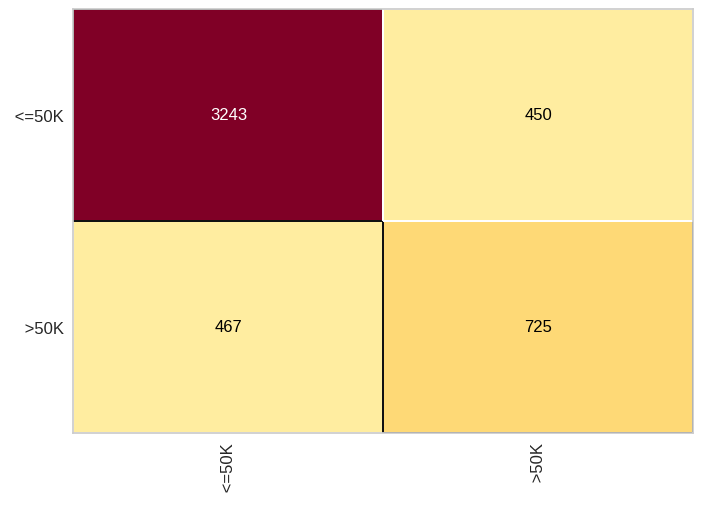

In [ ]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(arvore_census)
cm.fit(X_census_train, Y_census_train)
cm.score(X_census_teste, Y_census_teste)

## - Arvores de Decisão - Random Forest (Floresta Randomica)

As Random Forest são uma melhoria do algoritmos de arvore de decisão.
Ao invés de usar somente uma árvore de decisão como visto anteriormente, iremos utilizar mais de uma árvores por isso o nome Random Forest.

As respostas de cada arvores individual são agrupada e depois ponderadas afim de obter o melhor resultado de classificação.

A intuição do funcionamento do algoritmo Random Forest está dentro da área:

 - Ensemble learning (aprendizagem em conjunto)
    - A ideia desse tipo de aprendizagem é: "Consultar diversos profissionais para tomar uma decisão".
    - Temos vários algoritmos(arvores de decisão) juntos para construir um algortimo mais "forte".
    - Usa a média quando estamos trabalhando com regressão para chegar num resultado ou usa votos da maiora quando estamos trabalhando com classificação para dar a resposta final.

Por que é chamado de Random (Randomico)?
   - O algoritmo escolhe de forma aleatória K atributos para comparação da métrica de pureza / impureza dos dados (impureza de gini/entropia)

   Exemplo:
    - K = 3, quer dizer que cada uma das árvores terá somente 3 atributos
    - Nº Arvores = 3, teremos 3 arvores e cada uma delas utilizara randomicamente 3 atributos

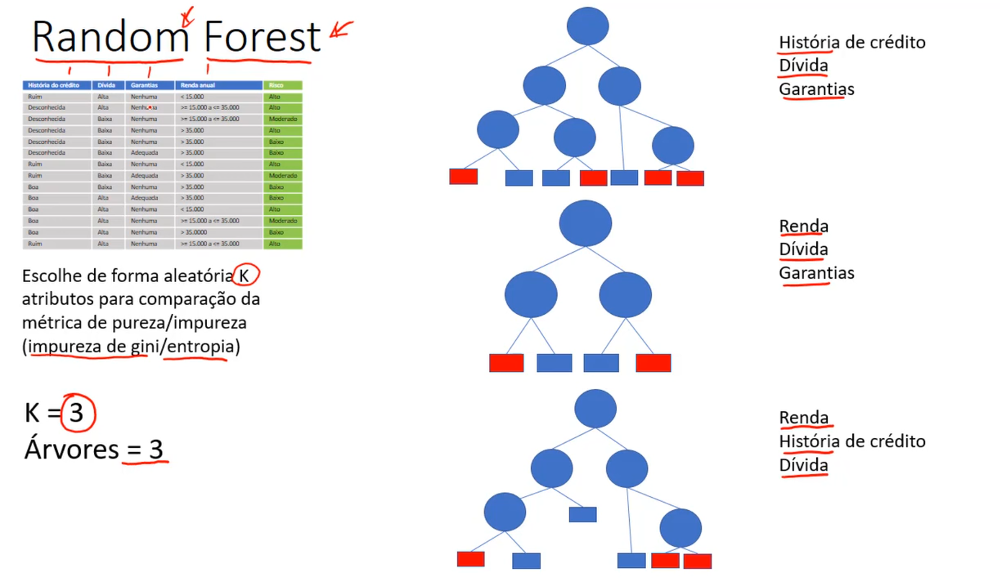

o valore de atributos é um hiperparametro que pode ser definido durante a criação do algoritmo porém, existe alguns calculos como retirar a raiz quadrada do número total de atributos para obter o paramentro K, √nºatributos.

## Random Forest - Base Crédito

In [ ]:
with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit.pkl', 'rb') as f:
  X_credit_treinamento, Y_credit_treinamento, X_credit_teste, Y_credit_teste = pickle.load(f)

In [ ]:
X_credit_treinamento.shape, Y_credit_treinamento.shape

((1500, 3), (1500,))

In [ ]:
X_credit_teste.shape, Y_credit_teste.shape

((500, 3), (500,))

In [ ]:
from sklearn.ensemble import RandomForestClassifier

In [ ]:
'''
N_estimators número de árvores de decisão que iremos criar
criterion é gini ou entropy
Max_features é o valor K, podemos usar sqrt ou log2
'''
random_credito = RandomForestClassifier(n_estimators=40,criterion='entropy',max_features='sqrt')
random_credito.fit(X_credit_treinamento, Y_credit_treinamento)

RandomForestClassifier(criterion='entropy', n_estimators=40)

In [ ]:
random_previsao=random_credito.predict(X_credit_teste)
random_previsao

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
Y_credit_teste

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
random_credito.feature_importances_

array([0.15135199, 0.47647299, 0.37217502])

In [ ]:
accuracy_score(Y_credit_teste,random_previsao)

0.99

In [ ]:
print(classification_report(Y_credit_teste,random_previsao))

              precision    recall  f1-score   support

           0       0.99      1.00      0.99       436
           1       0.97      0.95      0.96        64

    accuracy                           0.99       500
   macro avg       0.98      0.97      0.98       500
weighted avg       0.99      0.99      0.99       500



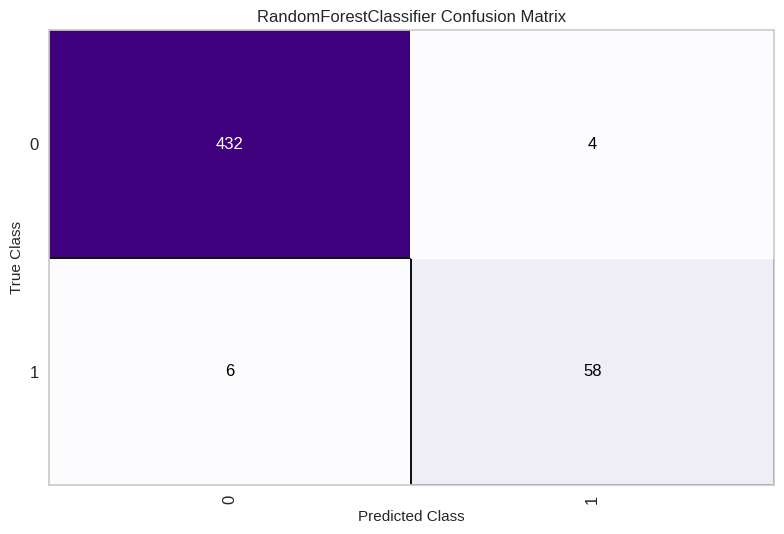

In [ ]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(random_credito,cmap='Purples')
cm.fit(X_credit_treinamento,Y_credit_treinamento)
cm.score(X_credit_teste,Y_credit_teste)
cm.show();


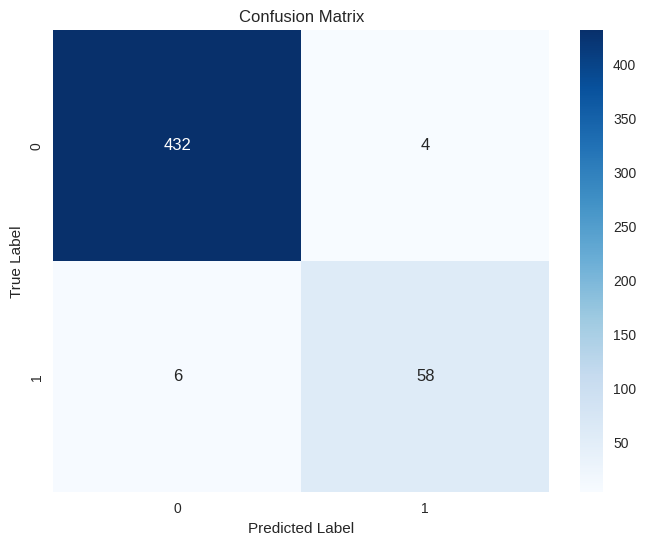

In [ ]:
  plt.figure(figsize=(8, 6))
  sns.heatmap(cm.confusion_matrix_, annot=True, fmt='d', cmap='Blues', cbar=True)
  plt.xlabel('Predicted Label')
  plt.ylabel('True Label')
  plt.title('Confusion Matrix')
  plt.show()

## Random Forest - Base Census

In [ ]:
with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/census.pkl', 'rb') as f:
  X_census_treinamento, Y_census_treinamento, X_census_teste, Y_census_teste = pickle.load(f)

In [ ]:
X_census_treinamento.shape, Y_census_treinamento.shape

((27676, 108), (27676,))

In [ ]:
Y_census_teste.shape, X_census_teste.shape

((4885,), (4885, 108))

In [ ]:
random_census = RandomForestClassifier(n_estimators=1000,criterion='entropy',max_features='sqrt')
random_census.fit(X_census_treinamento, Y_census_treinamento)

RandomForestClassifier(criterion='entropy', n_estimators=1000)

In [ ]:
random_previsao_census = random_census.predict(X_census_teste)
random_previsao_census

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' >50K'],
      dtype=object)

In [ ]:
Y_census_teste

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' <=50K'],
      dtype=object)

In [ ]:
accuracy_score(Y_census_teste,random_previsao_census)

0.847697031729785

In [ ]:
print(classification_report(Y_census_teste,random_previsao_census))

              precision    recall  f1-score   support

       <=50K       0.88      0.92      0.90      3693
        >50K       0.72      0.62      0.67      1192

    accuracy                           0.85      4885
   macro avg       0.80      0.77      0.78      4885
weighted avg       0.84      0.85      0.84      4885



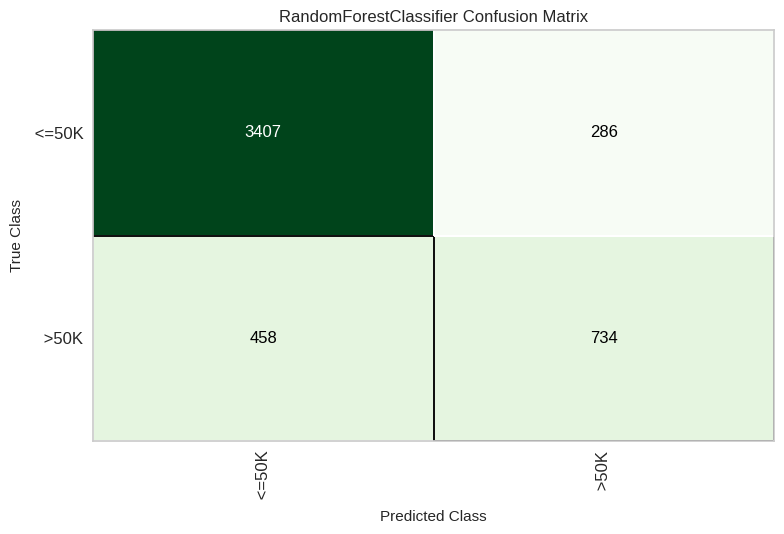

In [ ]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(random_census,cmap='Greens')
cm.fit(X_census_treinamento,Y_census_treinamento)
cm.score(X_census_teste,Y_census_teste)
cm.show();

# **APRENDIZAGEM POR REGRAS**

## Introdução

- Teoria sobre indução de regras - algoritimo OneR e PRISM
- Arvores de decisao x regras
- Regras (CN2) com orange - base risco de credito
- Regras (CN2) com orange - base crédito
- Regras (CN2) com orange/interface gráfica - base censo
- Classificador Base (MajorityLearner)

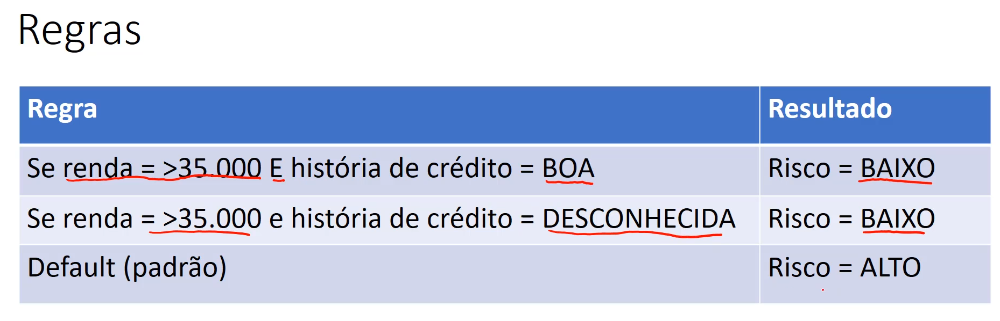


Com base na imagem acima, o algoritmo testa regra por regra caso nenhuma satisfaça ele assume a regra Default

## Algoritmo OneR


- Testar coisas simples primeiro
- Um atributo faz todo trabalho, uma analise deve ser feita para definir qual o atributo mais importante e criar regras baseadas nesse atributo mais importante. Parecido com como definir a raiz da arvore de decisão.

Um tabela é "feita" para definir o atributo mais importante:


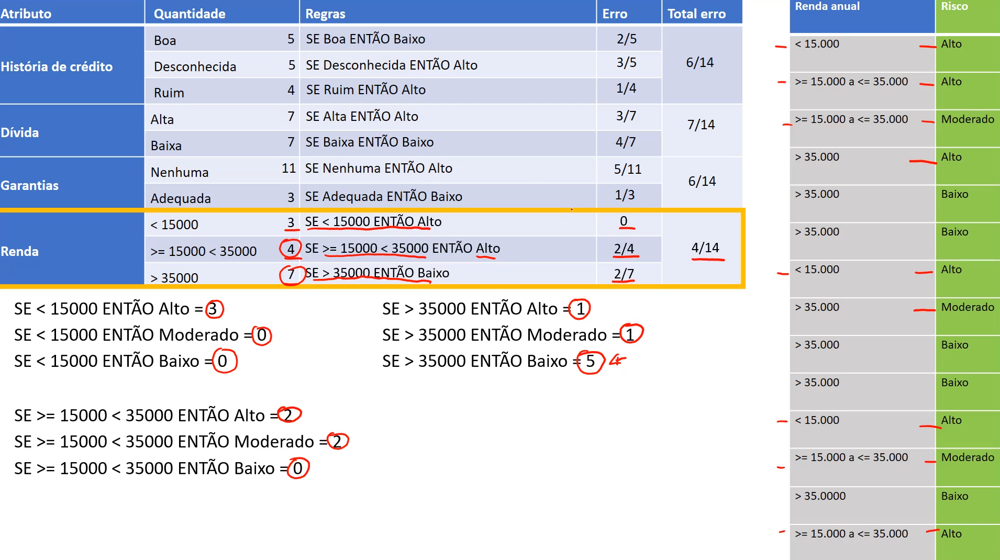

Observando a tabela o atributo renda é o que apresenta menor erro total, por tanto para o OneR é o atributo mais importante e todas as regras serão basedas em Renda.

## Algoritmo PRISM

O algortimo OneR é baseado em regras porém, leva em consideração somente 1 atributo para fazer as regras de classificações.
Já o algoritmo PRISM também baseado em regras, porém podemos usar regras compostas com mais de um atributos para termo uma classificação mais precisa.

Geraremos regras individuais para cada classe (resultado).

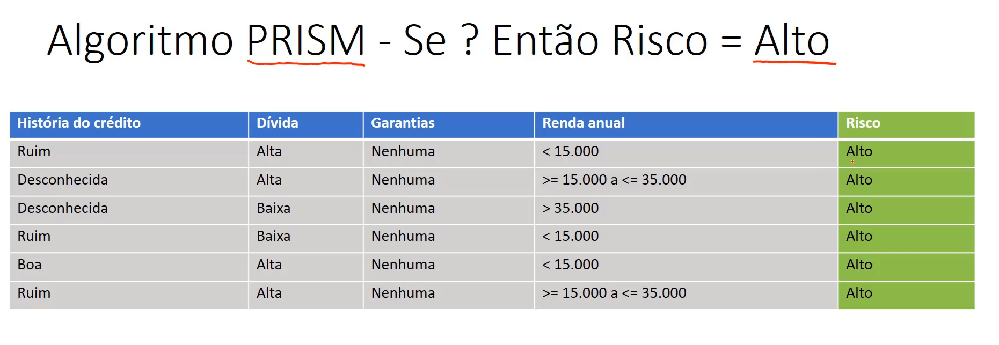


Fazendo uma tabela buscamndo o atributo que tem maior abrangencia para ter no caso um Risco = Alto para nosso algoritmo PRISM.
Observando a tabela de abrangencia temos que Garantias=Nenhuma tem o maio nível por tanto este é o atributo que iremos levar em consideração,
para nosso algortimo PRISM.


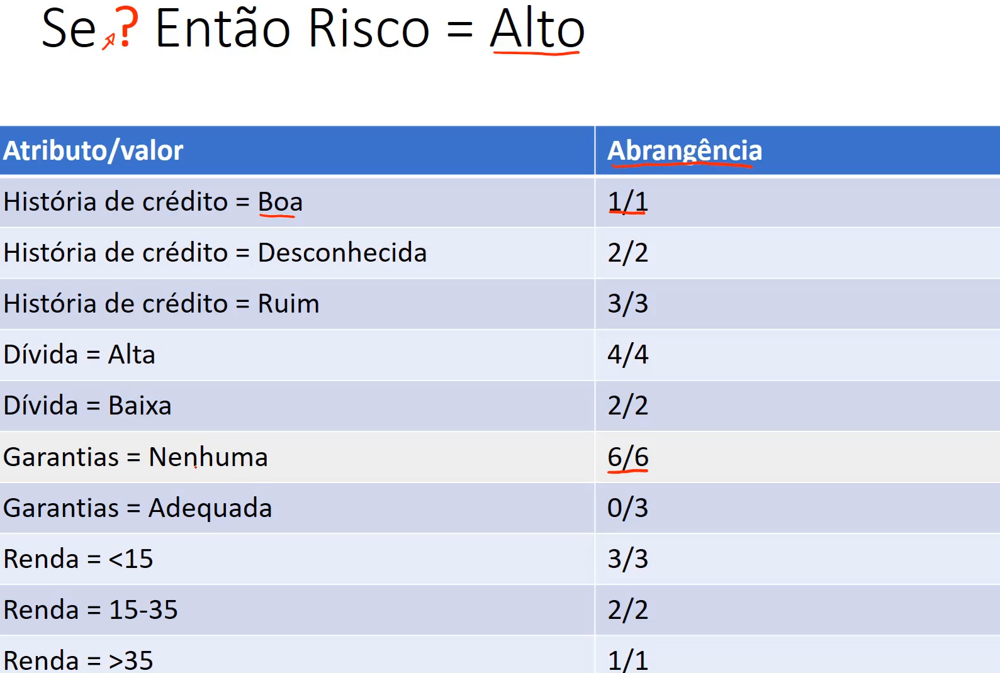

If **Garantias** = Nenhuma then **Risco** = Alto.

Agora vamos novamente para tabela de abrangencia para Risco = ALto para definirmos mais um atributo para nosso algortimo de Regra PRISM.

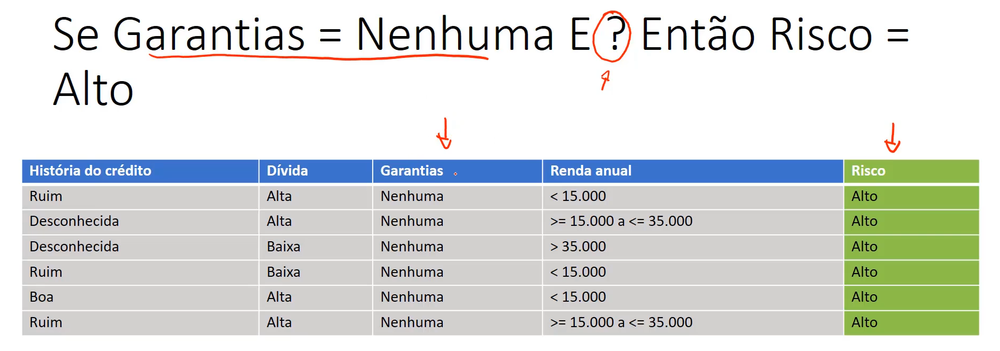

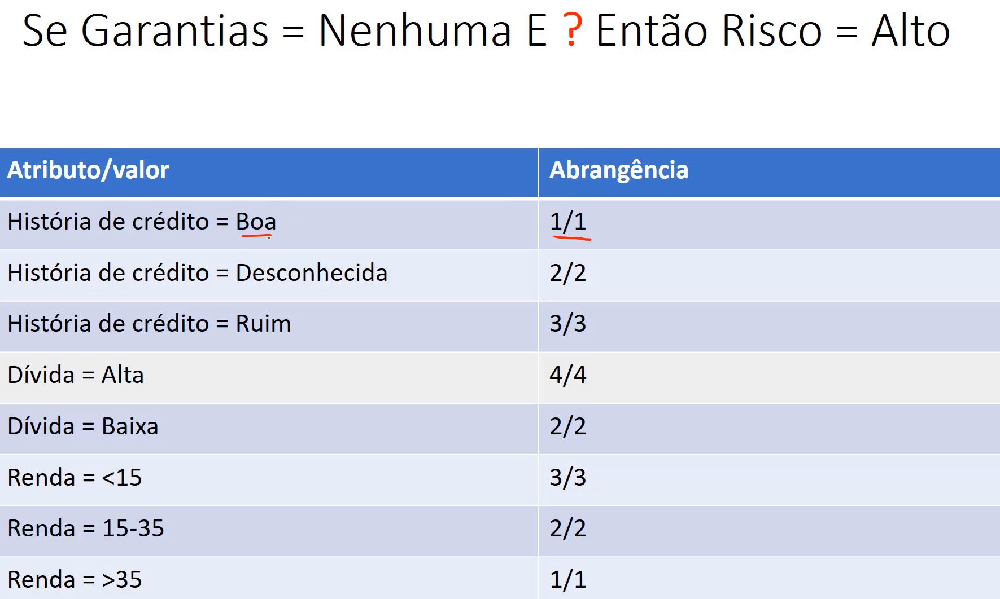

Na nova tabela temos que Dívida = Alta é o segundo atributo a compor nossa regra.

If **Garantia** = Nenhuma AND **Dívida** = Alta then **Risco** = Alto.

Depois faremos uma tabela de abrangencia para encontra o proximo atributo.

Esse processo é feito para todas as classes sucessivamente ate encontrarmos regras para todas as classes.

A regra final para a classe risco alto é:

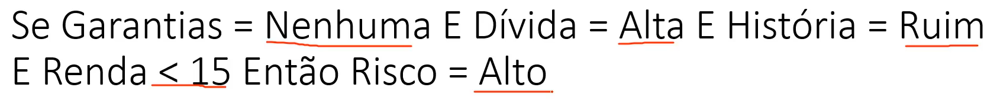

Temos que observar que as regras podem sofrer overfitting, no mesmo caso de arvores pode usar podas.

**ARVORES x REGRAS**

- Compreensibilidade
- Pouco espaço de armazenamento
- Mais lento
- Em geral, regras **NÃO** apresentam melhores resultados do que árvores de decisão

In [ ]:
'''
O SciKit learn não possui algoritmos baseados em regras portanto
vamos instalar uma biblioteca chamado Orange3
'''

!pip install Orange3

  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 535.3/535.3 kB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 270.3/270.3 kB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 18.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 125.7/125.7 kB 11.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.1/297.1 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 175.3/175.3 kB 11.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.1/51.1 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.0/95.0 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.4/6

In [ ]:
import Orange

In [ ]:
help(Orange)

Help on package Orange:

NAME
    Orange

DESCRIPTION
    # This module is a mixture of imports and code, so we allow import anywhere
    # pylint: disable=wrong-import-position,wrong-import-order

PACKAGE CONTENTS
    base
    canvas (package)
    classification (package)
    clustering (package)
    data (package)
    distance (package)
    ensembles (package)
    evaluation (package)
    misc (package)
    modelling (package)
    preprocess (package)
    projection (package)
    regression (package)
    statistics (package)
    tests (package)
    tree
    util
    version
    widgets (package)

DATA
    ADDONS_ENTRY_POINT = 'orange.addons'
    __git_version__ = '406083a568f5fb31335634f95617467351e4a565'
    classification = <Orange.misc.lazy_module._LazyModule object>
    clustering = <Orange.misc.lazy_module._LazyModule object>
    datasets = {'brown-selected': {'features': {'continuous': 7...01, 'tar...
    distance = <Orange.misc.lazy_module._LazyModule object>
    ensembles = <

## Regras - Base Risco de Crédito

In [ ]:
base_risco_credito = Orange.data.Table('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/risco_credito_regras.csv') #deixamos no forma do Orange

In [ ]:
'''
No arquivo CSV o titulo da clase no caso risco é c#risco, o c# indica ao Orange
que se trata de uma classe
'''

base_risco_credito # Observer que temos a notação atributos | classe, o c# faz
                   # essa sepração

[[ruim, alta, nenhuma, 0_15 | alto],
 [desconhecida, alta, nenhuma, 15_35 | alto],
 [desconhecida, baixa, nenhuma, 15_35 | moderado],
 [desconhecida, baixa, nenhuma, acima_35 | alto],
 [desconhecida, baixa, nenhuma, acima_35 | baixo],
 ...
]

In [ ]:
base_risco_credito.domain

[historia, divida, garantias, renda | risco]

In [ ]:
'''
O algoritmo de regra é o CN2 que é similar aos estudados OneR e PRISM
'''
cn2 = Orange.classification.rules.CN2Learner()
regras_risco_credito = cn2(base_risco_credito)

In [ ]:
'''
O algoritmo percorre todas as regras até uma delas seja satisfeita, assim gerando a classificação
'''

for regras in regras_risco_credito.rule_list:
  print(regras)

IF renda==0_15 THEN risco=alto 
IF historia==boa AND divida!=alta THEN risco=baixo 
IF historia==boa AND garantias!=nenhuma THEN risco=baixo 
IF historia==boa AND renda!=15_35 THEN risco=baixo 
IF historia==boa THEN risco=moderado 
IF divida==alta THEN risco=alto 
IF historia!=desconhecida THEN risco=moderado 
IF garantias==adequada THEN risco=baixo 
IF renda==15_35 THEN risco=moderado 
IF historia==desconhecida THEN risco=baixo 
IF TRUE THEN risco=alto 


In [ ]:
#Previsoes
#historia boa, divida alta, garantias nenhuma, renda > 35
#historia ruim, divida alta, garantias adequada, renda < 15
previsoes = regras_risco_credito([['boa','alta','nenhuma','15_35'],['ruim','alta','adequada','0_15']])
previsoes

array([2, 0])

In [ ]:
base_risco_credito.domain.class_var.values #alto =0, baixo =1 , moderado =2

('alto', 'baixo', 'moderado')

In [ ]:
for i in previsoes:
  #print(i)
  print('O Risco de crétido é:', base_risco_credito.domain.class_var.values[i])

O Risco de crétido é: moderado
O Risco de crétido é: alto


## Regras - base crédito

In [ ]:
base_credito = Orange.data.Table('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit_data_regras.csv')

In [ ]:
base_credito

[[66155.9, 59.017, 8106.53 | 0],
 [34415.2, 48.1172, 6564.75 | 0],
 [57317.2, 63.108, 8020.95 | 0],
 [42709.5, 45.752, 6103.64 | 0],
 [66952.7, 18.5843, 8770.1 | 1],
 ...
]

In [ ]:
base_credito.domain

[income, age, loan | default]

In [ ]:
base_divida = Orange.evaluation.testing.sample(base_credito, n=0.25) #Dividindo a base de dados de teste 25% para testar

In [ ]:
base_divida[0]

[[51903.5, 59.7627, 8807.87 | 0],
 [65137.9, 42.1331, 10352.2 | 0],
 [20583.6, 21.9898, 53.1862 | 0],
 [27089.1, 21.2077, 5029.49 | 1],
 [52100.9, 23.1814, 4767.28 | 0],
 ...
]

In [ ]:
base_divida[1]

[[21217.7, 21.3657, 2690.77 | 1],
 [20491.6, 35.1348, 1579.17 | 0],
 [30950.3, 26.3102, 5043.15 | 1],
 [29279.7, 18.8131, 2291.99 | 0],
 [60567.4, 40.0412, 571.933 | 0],
 ...
]

In [ ]:
base_train = base_divida[1]
base_test = base_divida[0]

In [ ]:
cn2_credito = Orange.classification.rules.CN2Learner()
regras_credito = cn2_credito(base_train)

In [ ]:
for i in regras_credito.rule_list:
  print(i)

IF age>=34.9257164876908 THEN default=0 
IF income>=69695.1504494064 THEN default=1 
IF loan<=2507.64970973955 AND income>=20145.9885970689 THEN default=0 
IF income<=31702.3342987522 AND loan>=3675.83341454456 THEN default=1 
IF loan>=7660.34617051509 AND loan>=9698.582169129 THEN default=1 
IF loan<=5836.56338145928 AND income>=46024.1445619613 THEN default=0 
IF age>=34.7410444347188 THEN default=0 
IF age>=34.4421687847935 THEN default=1 
IF income<=60019.447135273396 AND age>=34.3825240558945 THEN default=0 
IF income<=60019.447135273396 AND age>=33.6821509548463 THEN default=1 
IF age>=33.403173910453894 THEN default=0 
IF income<=60019.447135273396 AND age>=33.0152727491222 THEN default=1 
IF age>=32.8389940196648 THEN default=0 
IF loan<=4849.33378471958 AND age>=30.676849837880603 THEN default=0 
IF age>=29.9207484745421 AND loan>=7337.95043106519 THEN default=1 
IF age>=29.9207484745421 AND loan>=6924.90156914655 THEN default=0 
IF age>=29.9207484745421 AND loan>=5532.3438431

In [ ]:
previsao_base_credito = Orange.evaluation.testing.TestOnTestData(base_train, base_test, [lambda testdata: regras_credito])

In [ ]:
previsao_base_credito

In [ ]:
base_train.domain.class_var.values

('0', '1')

In [ ]:
Orange.evaluation.CA(previsao_base_credito) #Classificantion Accuray

array([0.96])

In [ ]:
Orange.evaluation.F1(previsao_base_credito) #F1 Score

array([0.87341772])

## Classificador base - Majority Learner

O majority learner não é um algoritmo que vai aprender algo com os dados, mas ele vai classificar dos registros baseado na maioria dos dados na base de dados.

In [ ]:
df_credito = Orange.data.Table('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit_data_regras.csv')
majority_credito = Orange.classification.MajorityLearner()

In [ ]:
previsoes = Orange.evaluation.testing.TestOnTestData(df_credito, df_credito, [majority_credito])
previsoes

In [ ]:
Orange.evaluation.CA(previsoes)

array([0.8585])

In [ ]:
for reg in df_credito:
  print(reg)

[66155.9, 59.017, 8106.53 | 0]
[34415.2, 48.1172, 6564.75 | 0]
[57317.2, 63.108, 8020.95 | 0]
[42709.5, 45.752, 6103.64 | 0]
[66952.7, 18.5843, 8770.1 | 1]
[24904.1, 57.4716, 15.4986 | 0]
[48430.4, 26.8091, 5722.58 | 0]
[24500.1, 32.8975, 2971 | 1]
[40654.9, 55.4969, 4755.83 | 0]
[25075.9, 39.7764, 1409.23 | 0]
[64131.4, 25.6796, 4351.03 | 0]
[59436.8, 60.4719, 9254.24 | 0]
[61050.3, 26.355, 5893.26 | 0]
[27268, 61.5768, 4759.79 | 0]
[63062, 39.2016, 1850.37 | 0]
[50501.7, -28.2184, 3977.29 | 0]
[43548.7, 39.5745, 3935.54 | 0]
[43378.2, 60.8483, 3277.74 | 0]
[20542.4, 61.6906, 3157.44 | 0]
[58887.4, 26.0761, 4965.52 | 0]
[23000.8, 31.7614, 1148.12 | 0]
[32197.6, -52.4233, 4244.06 | 0]
[23329.3, 48.577, 222.622 | 0]
[27845.8, 51.9706, 4959.92 | 0]
[65302, 48.8409, 5465.27 | 0]
[47451.6, 27.0317, 5361.28 | 0]
[63287, -36.497, 9595.29 | 0]
[45727.5, 55.8399, 6376.82 | 0]
[59417.8, ?, 2082.63 | 0]
[58842.9, 54.5109, 10871.2 | 0]
[48528.9, ?, 6155.78 | 0]
[23526.3, ?, 2862.01 | 0]
[67252.9,

# APRENDIZAGEM POR INSTANCIA **kNN (K nearest neighbors)**

O algoritmo kNN é utilizado para classificação baseado na distancia entre os vizinhos mais próximos.
No exemplo temos um grupo de circulos azuis e vermelhos, um novo objeto será inserido nesse meio, e o kNN vai classificar a qual classe pertence esse novo circulo.
O hiperparametro **K** é ajustado para que o algoritmo considere quantos vizinhos mais próximos serão utilizada as distancia para a classificação do novo objeto.

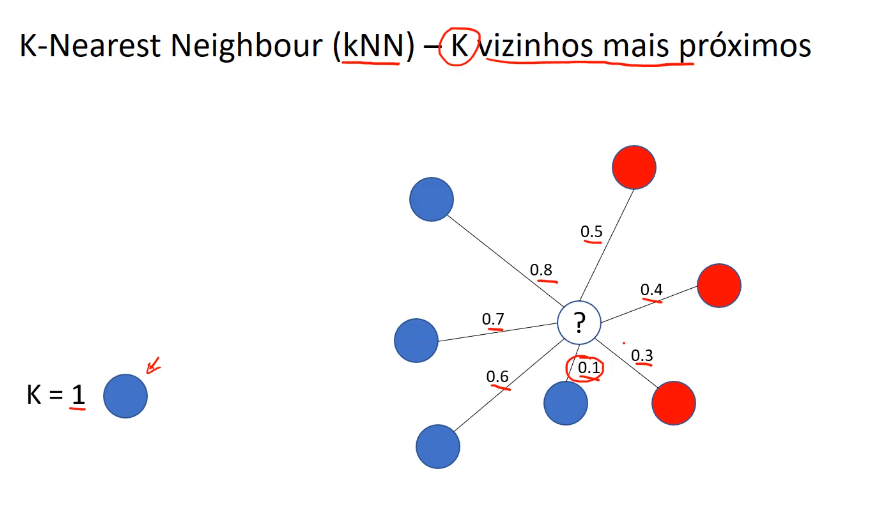

**Definições teoricas**

 - A maioria dos métodos de aprendizagem controem um modelo após o treinamento (os dados são descartados após a criação do modelo)
 - Métodos baseados em instâncias simplesmente armazenam os exemplos de treinamento, não existe efetivamente um treinamento. Um novo registro ele comparará com as distancias dos registros armazenados baseado no número K.
 - A generalização/previsão é feita somente quando uma nova instância precisar ser classificada (lazy - preguiçoso).



---
O calculo da distancia do kNN é a distancia euclidiana.

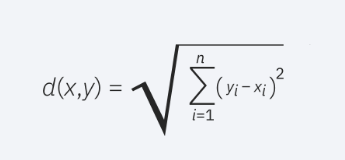

É usada para calcular a distancia entre dois pontos

---

**Resumo**

- É um algoritmo simples e poderoso
- Indicado quando o relacionamento entre as caracteristicas é complexo
- Quando se usa o valor de K pequeno, dados com ruídos ou outliers podem prejudicar
- Quando se usa o valor de K grande, tendência a classificar a classe com mais elementos (overfitting) - valor default 3 ou 5
- Lento para fazer as previsões
- Podemos usar outras metricas de distâncias:
  - Coeficiente de Pearson
  - Índice de Tanimoto
  - City Block

## Calculo Classificação

Usando o kNN para fazer uma classificação / recomendação de filmes.

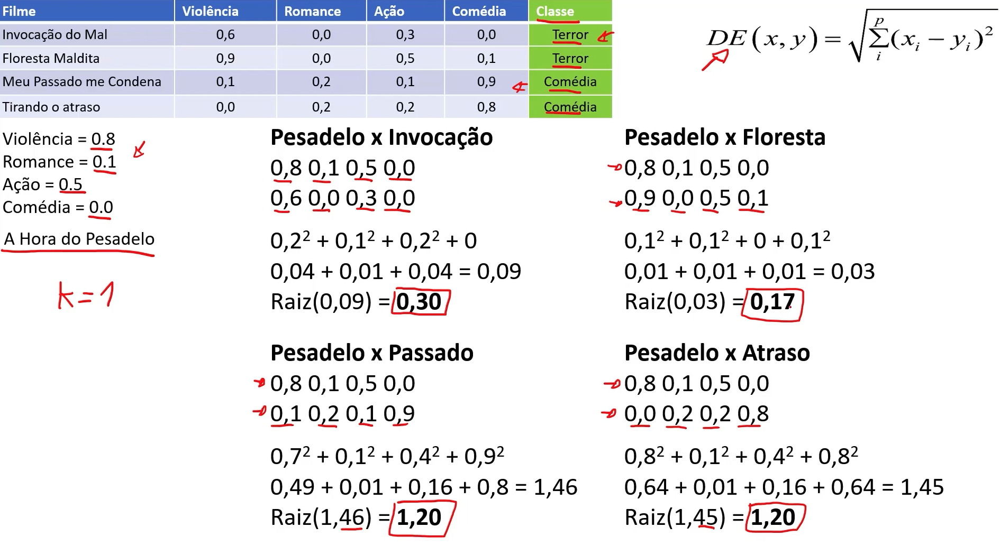

Baseado nas caracteristica: Violencia, Romance, Ação e Comédia, usamos o algoritmo de distancia euclidiana para o **novo filme Hora Do Pesadelo** para saber o quão proximo ele está da classe terror ou comédia, a menor distância nos indica sua classificação.

## Normalização e Padronização para kNN

No algoritmo kNN as variáveis devem estar na mesma escala, para que as previsões sejam feita da maneira mais correta.

**Exemplo:**

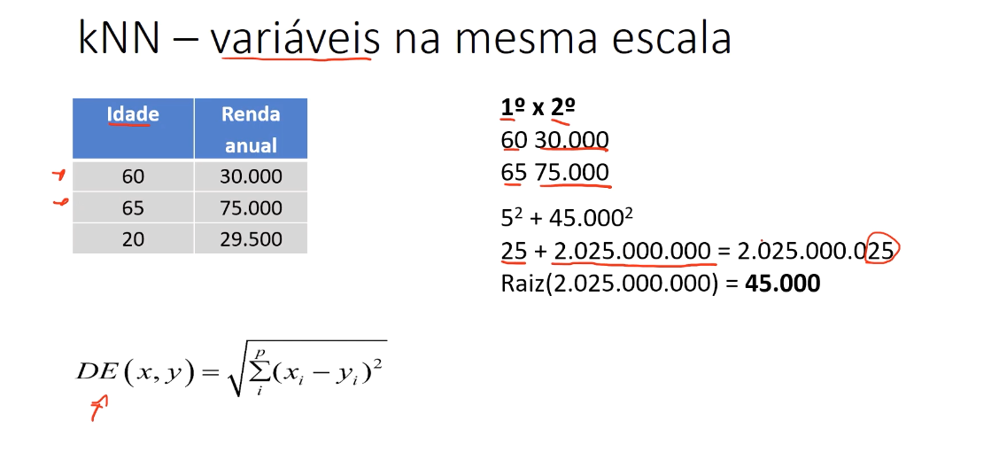

Observe a discrepância entre as variáveis **Idade e Renda anual**, avaliando em termos númerico o atributo idade tem pouca influencia no calculo da distância euclidiana.

O que fazemos é um escalonamento para deixar os 2 atributos na mesma escala e serem comparaveis, que são as **técnicas de Normalização e Padronização.**

## Normalização

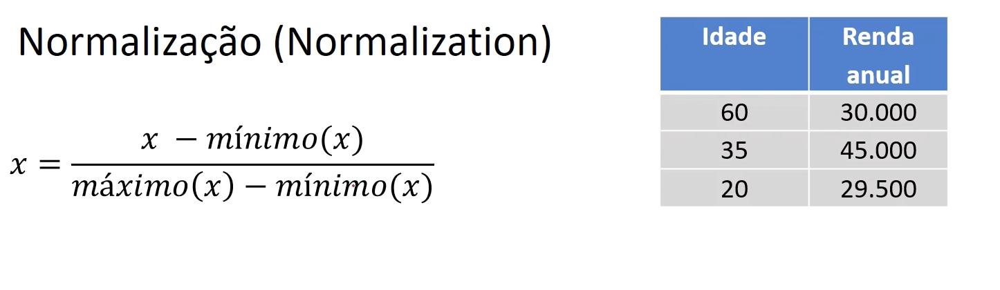

- A normalização sempre bem-vinda entretanto, podemos ter um bias quando usamos em banco de dados com outliers, podendo ter influência sobre o modelo


## Padrornização

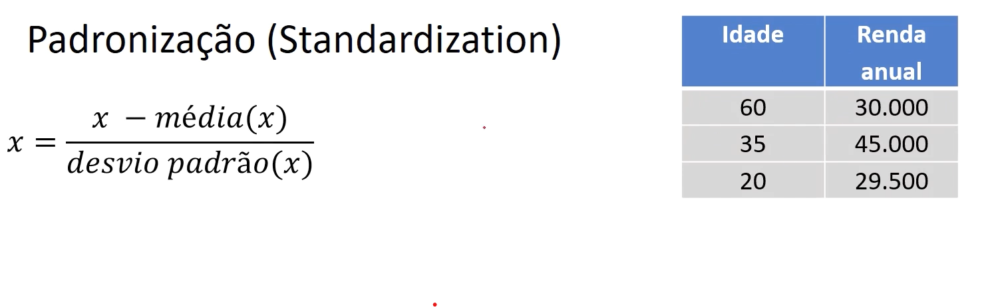

- A padronização leva em conta a média e o desvio padrão, isso a deixa menos sensível a outliers

## kNN - base crédito

In [ ]:
import pickle


In [ ]:
'''
Este arquivo está padronizado, ou seja, foi feito anteriormente na parte de pre processamento
'''

with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit.pkl', 'rb') as f:
  X_credit_treinamento, Y_credit_treinamento, X_credit_teste, Y_credit_teste = pickle.load(f)

In [ ]:
X_credit_treinamento.shape, Y_credit_treinamento.shape

((1500, 3), (1500,))

In [ ]:
X_credit_teste.shape, Y_credit_teste.shape

((500, 3), (500,))

In [ ]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2)
knn.fit(X_credit_treinamento, Y_credit_treinamento)

KNeighborsClassifier()

In [ ]:
previsoes = knn.predict(X_credit_teste)
previsoes

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
accuracy_score(Y_credit_teste, previsoes)

0.986

In [ ]:
print(classification_report(Y_credit_teste, previsoes))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       436
           1       0.94      0.95      0.95        64

    accuracy                           0.99       500
   macro avg       0.97      0.97      0.97       500
weighted avg       0.99      0.99      0.99       500



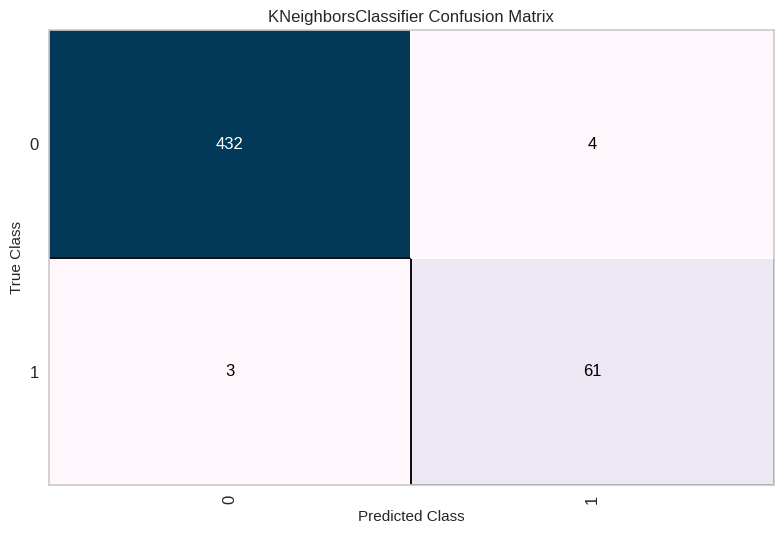

In [ ]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(knn, cmap = 'PuBu')
cm.fit(X_credit_treinamento, Y_credit_treinamento)
cm.score(X_credit_teste, Y_credit_teste)
cm.show();

## kNN - base census

In [ ]:
'''
Este arquivo está padronizado, ou seja, foi feito anteriormente na parte de pre processamento
'''
with open ('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/census.pkl', 'rb') as f:
  X_census_treinamento, Y_census_treinamento, X_census_teste, Y_census_teste = pickle.load(f)

In [ ]:
X_census_treinamento.shape, Y_census_treinamento.shape

((27676, 108), (27676,))

In [ ]:
X_census_teste.shape, Y_census_teste.shape

((4885, 108), (4885,))

In [ ]:
knn_census = KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2)
knn_census.fit(X_census_treinamento, Y_census_treinamento)


KNeighborsClassifier()

In [ ]:
previsao_censo = knn_census.predict(X_census_teste)
previsao_censo

Exception ignored on calling ctypes callback function: <function ThreadpoolController._find_libraries_with_dl_iterate_phdr.<locals>.match_library_callback at 0x7c0c8767ad40>
Traceback (most recent call last):
  File "/usr/local/lib/python3.12/dist-packages/threadpoolctl.py", line 1005, in match_library_callback
    self._make_controller_from_path(filepath)
  File "/usr/local/lib/python3.12/dist-packages/threadpoolctl.py", line 1187, in _make_controller_from_path
    lib_controller = controller_class(
                     ^^^^^^^^^^^^^^^^^
  File "/usr/local/lib/python3.12/dist-packages/threadpoolctl.py", line 114, in __init__
    self.dynlib = ctypes.CDLL(filepath, mode=_RTLD_NOLOAD)
                  ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/usr/lib/python3.12/ctypes/__init__.py", line 379, in __init__
    self._handle = _dlopen(self._name, mode)
                   ^^^^^^^^^^^^^^^^^^^^^^^^^
OSError: /usr/local/lib/python3.12/dist-packages/xgboost.libs/libgomp-e985bcbb.so.1.0.0

array([' <=50K', ' <=50K', ' >50K', ..., ' <=50K', ' <=50K', ' >50K'],
      dtype=object)

In [ ]:
accuracy_score(Y_census_teste, previsao_censo)

0.8223132036847492

In [ ]:
print(classification_report(Y_census_teste, previsao_censo))

              precision    recall  f1-score   support

       <=50K       0.87      0.90      0.88      3693
        >50K       0.66      0.57      0.61      1192

    accuracy                           0.82      4885
   macro avg       0.76      0.74      0.75      4885
weighted avg       0.82      0.82      0.82      4885



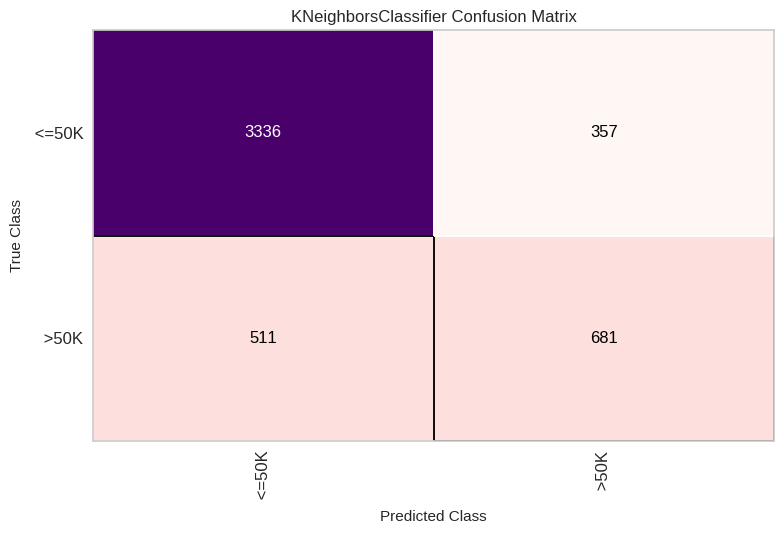

In [ ]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(knn_census, cmap = 'RdPu')
cm.fit(X_census_treinamento, Y_census_treinamento)
cm.score(X_census_teste, Y_census_teste)
cm.show();


# REGRESSÃO LOGISTICA

- Teoria sobre regressão logistica
- Regressao logistica com scikit learn com nossos datasets

## Introdução

Relembrando que no aprendizado de máquina temos dois métodos:

**- Métodos Preditivos (Supevisionados)**
  - Classificação (Rótulos)
  - Regressão (Números)

**- Métodos Descritivos (Não Supervisionados)**
  - Associação
  - Agrupamento
  - Detecção de Desvios
  - Padrões sequenciais
  - Sumarização


---


Um exemplo que podemos usar para regressão logistica envolve o atributo previsor idade e a classe pagar, na regressão logistica ***(sigmoid)*** temos 1 que irá pagar e 0 que não irá pagar, nessa regressão temos um resultado de probabilidades entre 0 e 1.

$P=\frac{1}{1+e^{-(\beta _{0}+\beta _{1}X_{1}+...+\beta _{n}X_{n})}}$


  - **$P:$** A probabilidade do evento ocorrer (variavel dependente, resultado entre 0 e 1)
  - **$e:$** A base do logaritmo natural
  - **$ß_{0}:$** o intercepto, que representa o valor base quando todas as variáveis independentes são zero
  - **$ß_{1},ß_{2},...ß_{n}:$** Os coeficientes que indicam o impacato de cada variável independente na probabilidade
  - **$X_{1},X_{2},..X{n}:$** As variáveis independentes ou preditoras

O objetivo é encotrar a melhor curva para encaixar nos dados

## Aprendizagem

O algoritmo tem como principal objetivo, encontrar os melhores pesos para cada **$ß_{1},ß_{2},...ß_{n}$** de cada variável independente.
No nosso exemplo da base de crédito que encontrar os seguintes pesos ß:

  - $ß_{0}$
  - $ß_{1}$(historia do crédito)
  - $ß_{2}$(dívida)
  - $ß_{3}$(garantias)
  - $ß_{4}$(renda anual)
---

Umas das técnicas é o **Gradient Descendent (Descida do Gradiente)**
Os parametros são testados até encontrar os melhores parametros que retorne o menor erro possível.

A descida do gradiente é um algoritmo de otimização que busca minimizar uma função de custo — ou seja, reduzir o erro entre os valores previstos por um modelo e os valores reais. É amplamente usado em regressão linear, redes neurais e outros modelos de aprendizado de máquina

- Função de custo: Representa o erro do modelo. Exemplo comum: erro quadrático médio.

- Gradiente: É o vetor de derivadas parciais da função de custo em relação aos parâmetros do modelo. Ele aponta na direção de maior crescimento da função.

- Atualização dos parâmetros:
  - A cada passo, o algoritmo calcula o gradiente da função de custo.
  - Move os parâmetros na direção oposta ao gradiente (por isso “descida”), com um passo de tamanho definido pela taxa de aprendizad

$𝜃:=𝜃−𝛼⋅∇𝐽(𝜃)$

Onde:  
  - 𝜃: são os parâmetros do modelo
  - 𝛼: é a taxa de aprendizado -
  - ∇𝐽(𝜃): é o gradiente da função de custo

- O algoritmo começa com valores iniciais aleatórios para os parâmetros.
- Em cada iteração:
  - Calcula o gradiente.
  - Atualiza os parâmetros.
  - Avalia a nova função de custo

$min C(ß_{1},ß_{2}..ß_{n})$ esta formula é para encontrar o minimo custo, aquele custo que tem o menor erro possível.




## Regressão classificação - risco crédito

In [ ]:
with open ('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/risco_credito.pkl', 'rb') as f:
  X_risco_credito, Y_risco_credito = pickle.load(f)

In [ ]:
X_risco_credito.shape, Y_risco_credito.shape

((14, 4), (14,))

In [ ]:
X_risco_credito

array([[2, 0, 1, 0],
       [1, 0, 1, 1],
       [1, 1, 1, 1],
       [1, 1, 1, 2],
       [1, 1, 1, 2],
       [1, 1, 0, 2],
       [2, 1, 1, 0],
       [2, 1, 0, 2],
       [0, 1, 1, 2],
       [0, 0, 0, 2],
       [0, 0, 1, 0],
       [0, 0, 1, 1],
       [0, 0, 1, 2],
       [2, 0, 1, 1]], dtype=object)

In [ ]:
Y_risco_credito

array(['alto', 'alto', 'moderado', 'alto', 'baixo', 'baixo', 'alto',
       'moderado', 'baixo', 'baixo', 'alto', 'moderado', 'baixo', 'alto'],
      dtype=object)

In [ ]:
X_risco_credito = np.delete(X_risco_credito, [2,7,11], axis=0) # estamos apagando a classe moderado para ficar mais simples o exemplo
Y_risco_credito = np.delete(Y_risco_credito, [2,7,11], axis=0)

In [ ]:
Y_risco_credito

array(['alto', 'alto', 'alto', 'baixo', 'baixo', 'alto', 'baixo', 'baixo',
       'alto', 'baixo', 'alto'], dtype=object)

In [ ]:
from sklearn.linear_model import LogisticRegression

In [ ]:
model = LogisticRegression(solver='lbfgs',random_state=38)
model.fit(X_risco_credito, Y_risco_credito)

LogisticRegression(random_state=38)

In [ ]:
model.intercept_ #Coeficientes ß0

array([-0.80855152])

In [ ]:
model.coef_ #Coeficientes ß1,2,3,4

array([[-0.76706797,  0.23921064, -0.47989768,  1.12196145]])

Neste exemplo nosso logito: $ß_{0}+ß_{1}*x1+ß_{2}*x2+ß_{3}*x3+ß_{4}*x4$

ficou desta maneira: $-0.805+(-0767*x1)+(0.239*x2)+(-0.479*x3)+(1.12*x4)$

In [ ]:
#Previsoes:
previsao = model.predict([[0,0,1,2],[2,0,0,0],[1,1,1,1]])
previsao

array(['baixo', 'alto', 'alto'], dtype=object)

## Regressão classificação - base credito

In [ ]:
with open ('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit.pkl', 'rb') as f:
  X_credit_treinamento, Y_credit_treinamento, X_credit_teste, Y_credit_teste = pickle.load(f)

In [ ]:
X_credit_treinamento.shape,Y_credit_treinamento.shape

((1500, 3), (1500,))

In [ ]:
X_credit_teste.shape,Y_credit_teste.shape

((500, 3), (500,))

In [ ]:
model1 = LogisticRegression(solver='lbfgs',random_state=38)
model1.fit(X_credit_treinamento, Y_credit_treinamento)


LogisticRegression(random_state=38)

In [ ]:
model1.intercept_

array([-6.03333114])

In [ ]:
model1.coef_

array([[-2.55275554, -3.72391763,  3.94333319]])

In [ ]:
model1.predict(X_credit_teste)

array([1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
Y_credit_teste

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
accuracy_score(Y_credit_teste, model1.predict(X_credit_teste))

0.946

In [ ]:
print(classification_report(Y_credit_teste, model1.predict(X_credit_teste)))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97       436
           1       0.79      0.78      0.79        64

    accuracy                           0.95       500
   macro avg       0.88      0.88      0.88       500
weighted avg       0.95      0.95      0.95       500



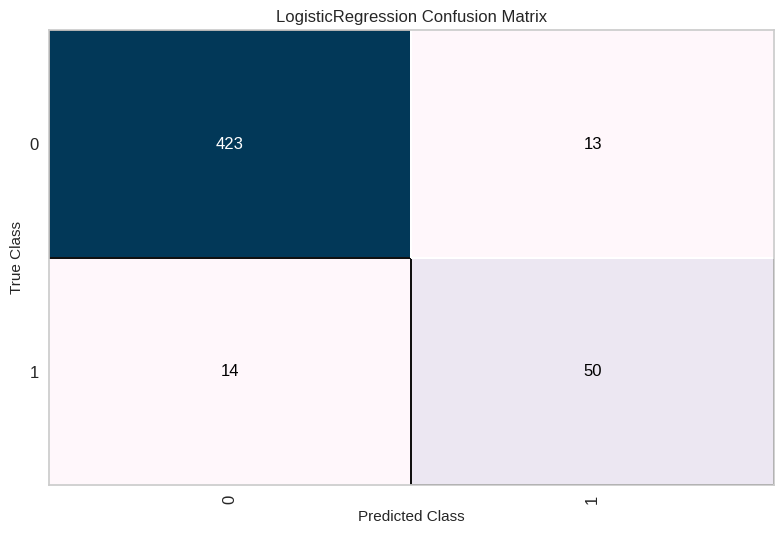

In [ ]:
from yellowbrick.classifier import ConfusionMatrix
cm = ConfusionMatrix(model1, cmap = 'PuBu')
cm.fit(X_credit_treinamento, Y_credit_treinamento)
cm.score(X_credit_teste, Y_credit_teste)
cm.show();

In [ ]:
#Usando Sklearn Confusion Matrix
cm = confusion_matrix(Y_credit_teste, model1.predict(X_credit_teste))

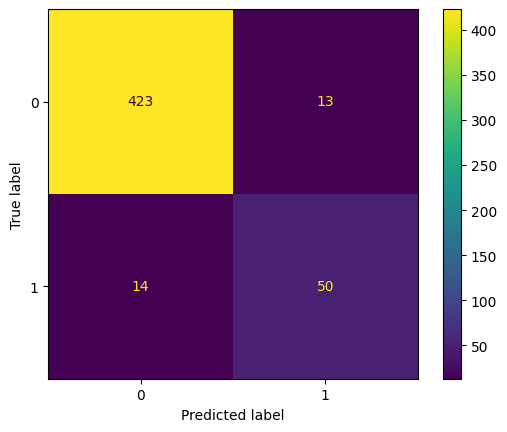

In [ ]:
from sklearn.metrics import ConfusionMatrixDisplay
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=np.unique(Y_credit_teste))
disp.plot();
plt.show();

## Regressão classificação - base census

In [ ]:
with open ('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/census.pkl', 'rb') as f:
  X_census_treinamento, Y_census_treinamento, X_census_teste, Y_census_teste = pickle.load(f)

In [ ]:
X_census_treinamento.shape,Y_census_treinamento.shape

((27676, 108), (27676,))

In [ ]:
X_census_teste.shape,Y_census_teste.shape

((4885, 108), (4885,))

In [ ]:
model2 = LogisticRegression(solver='lbfgs',random_state=38)
model2.fit(X_census_treinamento, Y_census_treinamento)

LogisticRegression(random_state=38)

In [ ]:
model2.intercept_

array([-2.10552416])

In [ ]:
model2.coef_

array([[-6.98488613e-02,  1.18355815e-01, -9.28364487e-03,
        -6.32571637e-02,  5.70026706e-02,  5.07381719e-02,
        -8.84284931e-02, -5.02268816e-02, -1.24694668e-01,
        -1.02481824e-01, -1.17822786e-01, -3.66227818e-02,
        -1.89874033e-02, -2.67960548e-02, -8.22889018e-02,
        -7.88822810e-02, -8.12332696e-03,  1.13390793e-02,
         1.45986267e-01,  1.18924828e-01, -7.54038219e-02,
         1.44347173e-01, -5.54400102e-01,  1.13453107e-01,
         2.46279059e-02, -1.90450912e-01,  4.34375255e-02,
         7.00139994e-01, -6.46427239e-02, -5.18599668e-01,
        -1.07259785e-01, -8.85445200e-02, -7.37373311e-02,
        -1.37206225e-02, -2.06416506e-02,  2.26862374e-02,
         2.52008753e-01, -1.67994077e-01, -1.41452274e-01,
        -8.40072161e-02, -2.57017139e-01, -2.82516289e-01,
         1.61879470e-01,  8.58540408e-02,  8.36697148e-02,
         1.09051852e-01, -2.53383593e-02, -2.30592713e-02,
         1.32752101e-01, -8.29001225e-02, -3.09430677e-0

In [ ]:
model2.predict(X_census_teste)

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' >50K'],
      dtype=object)

In [ ]:
Y_census_teste

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' <=50K'],
      dtype=object)

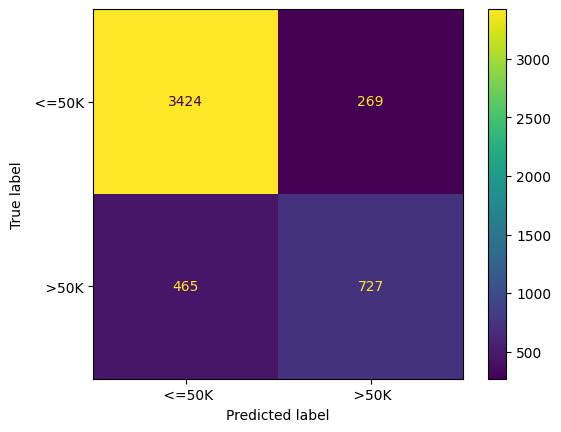

In [ ]:
cm = confusion_matrix(Y_census_teste, model2.predict(X_census_teste))
ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=np.unique(Y_census_teste)).plot();

In [ ]:
accuracy_score(Y_census_teste, model2.predict(X_census_teste))

0.8497441146366428

In [ ]:
print(classification_report(Y_census_teste, model2.predict(X_census_teste)))

              precision    recall  f1-score   support

       <=50K       0.88      0.93      0.90      3693
        >50K       0.73      0.61      0.66      1192

    accuracy                           0.85      4885
   macro avg       0.81      0.77      0.78      4885
weighted avg       0.84      0.85      0.84      4885



# SVM (SUPPORT VECTOR MACHINES)

## Introdução & Teoria

- Teoria sobre SVM (revisao matematica básica)
- Kernels
- Vamos trabalhar com SVM nas nossas bases de dados
---

- Em geral supera outros algoritmos de apredizagem de máquina, pode ser usando tanto para classificação como para regressão.
- Utilizado em tarefas complexas: reconhecimento de caracteres, voz, imagens


---


- **Componentes-chave do SVM**

A ideia por trás do SVM é aprender hiperplanos de separação com margem máxima.

  - **Hiperplano:** É a fronteira de decisão que separa as classes. Em um espaço bidimensional, é uma linha; em três dimensões, é um plano; e em dimensões superiores, é chamado de hiperplano.
  - **Vetores de suporte:** São os pontos de dados mais próximos do hiperplano. Eles são cruciais para definir a posição e orientação do hiperplano.
  - **Margem:** É a distância entre o hiperplano e os vetores de suporte. O SVM tenta maximizar essa margem, pois uma margem maior geralmente leva a uma melhor generalização do modelo


  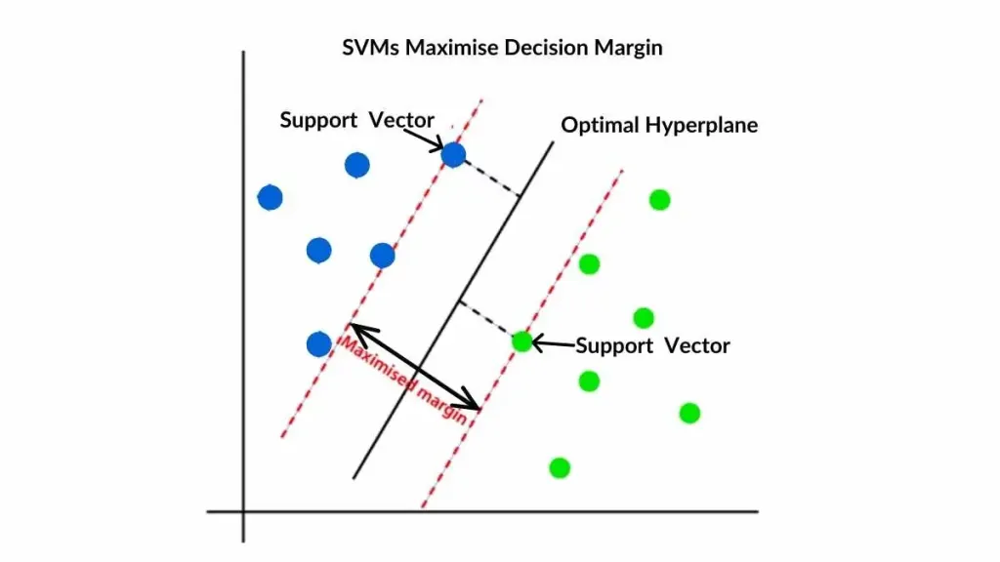

O algoritmo irá aprender qual melhor hiperplano considerando a margem máxima do vetor de suporte, isso é importe pois , quanto maior a margem melhor a generalização do algoritmo para novos registros.

- **Como o SVM funciona?**
  1) **Treinamento:** O algoritmo recebe dados rotulados e tenta encontrar o hiperplano que melhor separa as classes.
  2) **Maximização da margem:** Ele escolhe o hiperplano que tem a maior distância possível dos pontos mais próximos de cada classe.
  3) **Classificação:** Novos dados são classificados com base em qual lado do hiperplano eles caem.

- **Criação do hiperplano - Convex hulls (envoltória convexa)**
  - O SVM busca o hiperplano ótimo que separa duas classes com a maior margem possível. O Convex Hull entra como uma ferramenta geométrica para entender e até melhorar essa separação.
  - Cada classe de dados pode ser envolvida por seu fecho convexo (Convex Hull).- Se os Convex Hulls das duas classes não se interceptam, então existe um hiperplano que pode separá-las perfeitamente.
  - O SVM, nesse caso, pode ser visto como uma forma de encontrar esse hiperplano entre os dois Convex Hulls.

  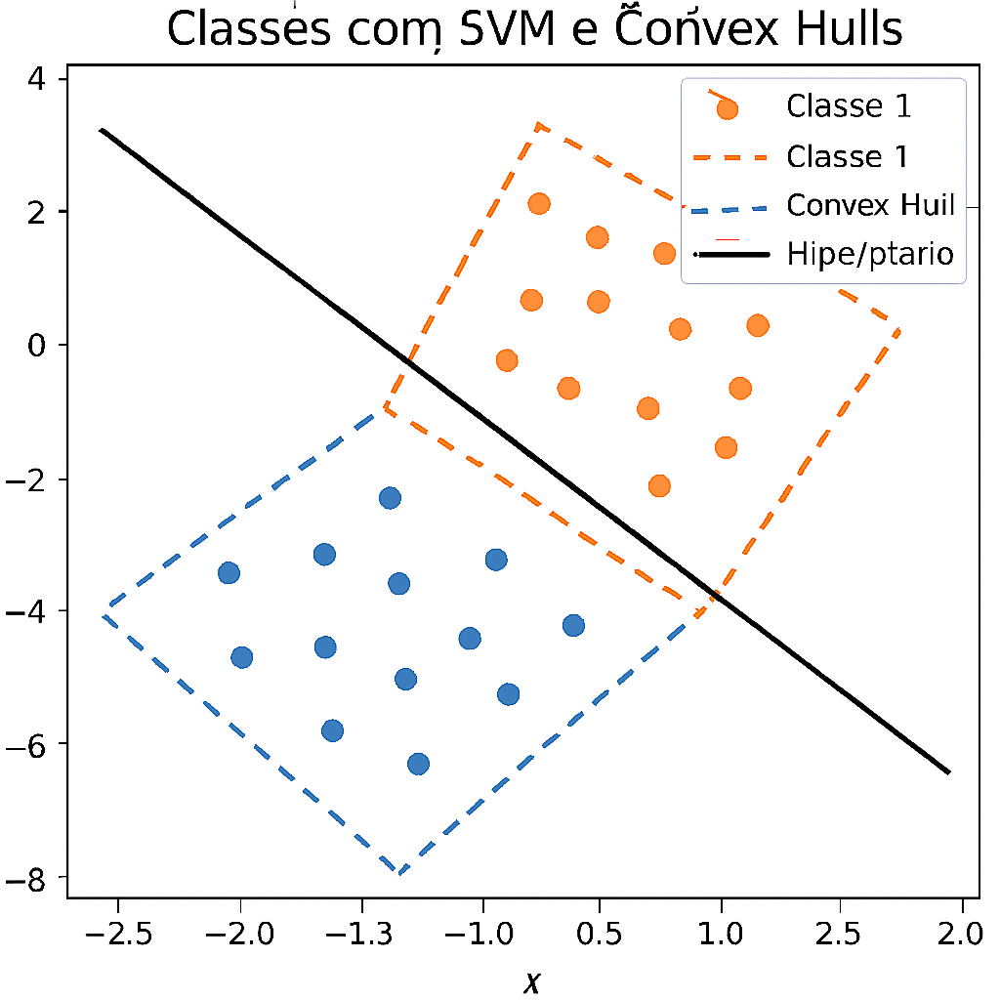

- Criação do hiperplano abordagem matemática
  - Existe também a abordagem matemática para criação do hiperplano, é a mais utilizada atualmente.

  - Em um espaço 𝑅𝑛, um hiperplano é definido pela equação:𝑤⋅𝑥+𝑏=0
    1. 𝑤: vetor normal ao hiperplano (direção).
    2. 𝑥: vetor de entrada (ponto no espaço)
    3. 𝑏: viés (bias), que desloca o hiperplano

Esse hiperplano divide o espaço em duas metades: uma para cada classe.
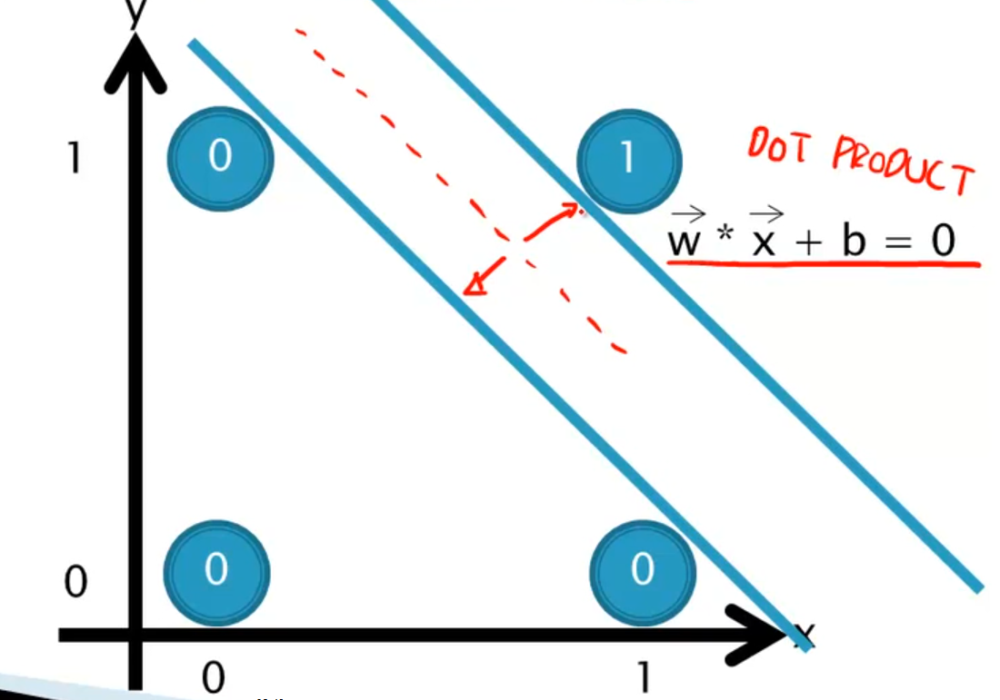

- O SVM busca maximizar a margem entre as classes. Para isso, impõe as seguintes restrições:

  1. 𝑦𝑖(𝑤⋅𝑥𝑖+𝑏)≥1

  2. 𝑦𝑖∈ {−1,+1}: rótulo da classe

𝑥𝑖: ponto de treinamento

  - Essas restrições garantem que os pontos estejam fora da margem, exceto os vetores de suporte, que ficam exatamente na margem.

- **𝑤⋅𝑥+𝑏=0**

  1. 𝑤: vetor de pesos (define a direção do hiperplano)

  2. 𝑥: ponto de entrada (com suas características)

  3. 𝑏: viés (desloca o hiperplano no espaço)

  - Essa equação define uma fronteira de decisão: ela separa os dados em duas classes. Se o resultado for:
    - > 0 → o ponto está de um lado do hiperplano (classe +1)
    - < 0 → está do outro lado (classe -1)
    - = 0 → o ponto está exatamente sobre o hiperplano

- **Função do termo de viés:** Permite flexibilidade: O termo \(b\) é essencial para que o hiperplano não precise passar pela origem (0,0). Sem ele, o classificador seria forçado a sempre passar pela origem, o que restringiria o modelo e poderia levar a um desempenho muito ruim, a menos que a solução ideal de fato passasse por esse ponto.Realiza o deslocamento:
  - O valor de \(b\) desloca o hiperplano para cima ou para baixo, encontrando a posição ideal para maximizar a margem entre as classes de dados.
  - Não é regularizado: O termo de viés é tratado de forma diferente do vetor de pesos \(w\) durante a regularização. A regularização busca manter o vetor de pesos pequeno para evitar o sobreajuste (overfitting), mas o viés não deve ser penalizado, pois ele não afeta a complexidade ou a forma do hiperplano, apenas sua posição.


- Imagine que temos um hiperplano em 2D com:

  1. 𝑤=[2,−1]
  2. 𝑏= −3

- E queremos classificar o ponto

  - 𝑥=[2,1]:

    - **𝑤⋅𝑥+𝑏=(2⋅2)+(−1⋅1)+(−3) = 4−1−3=0**

    - 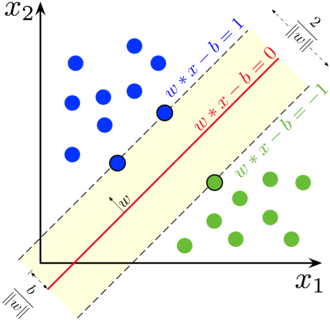

- Erros e custo
  - A função que o SVM minimiza é:
 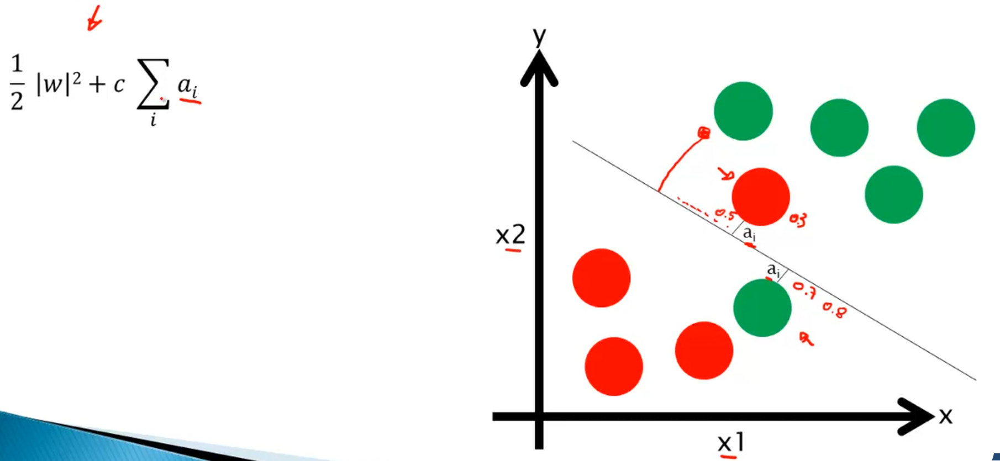

  -  **C:** punição por classicação incorreta, um C alto tenta 100% de separação, já um C baixo permite mais erros.

  
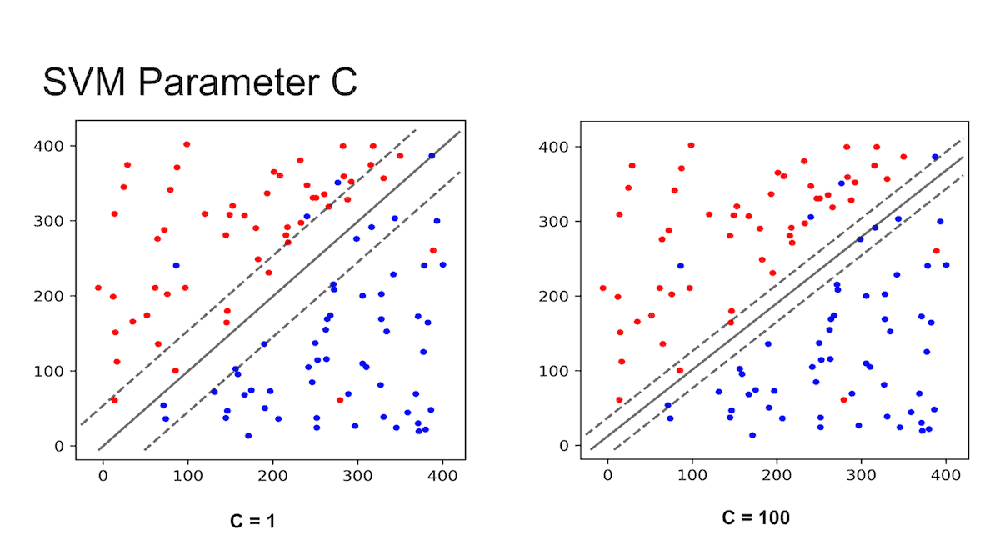
  - Observer que com um fator **C** mais alto há uma classificação bem melhor se comparado a um **C** pequeno

- **SVM Não Linear & Kernel Tricks**
  - **Linear:** Quando os dados podem ser separados por uma linha reta (ou plano).

  - **Não linear:** Quando os dados não são linearmente separáveis, o SVM usa uma técnica chamada kernel trick para transformar os dados em um espaço de maior dimensão onde a separação linear é possível.

- Para trabalharmos com SVMs não lineares usando uma técnica chamada **Kernel Trick**, isso nos permite a fazer uma mudança nos dados de forma a poder termos um hiperplano linear.

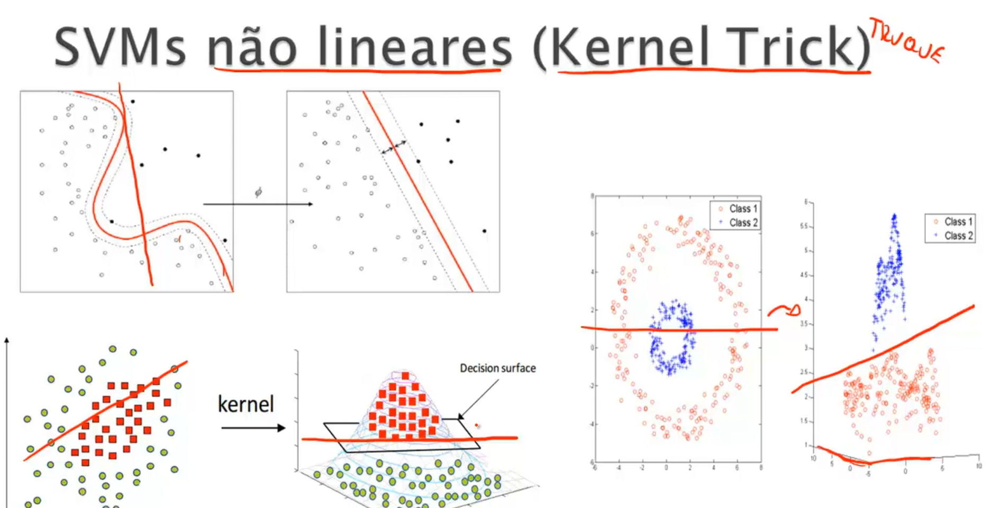

- **Tipos de Kernel:**
  1. Linear: Simples e rápido. Ideal quando os dados são linearmente separáveis.
  2. Gaussian ou RBF(Radial Basis Function): Captura relações não lineares com grau ajustável. Pode ser mais lento.
  3. Polynomial: Muito poderoso para dados complexos. Pode causar overfitting se mal ajustado.
  4. Tangent Hyperbolic: Inspirado em redes neurais. Menos usado por instabilidade em alguns casos.

  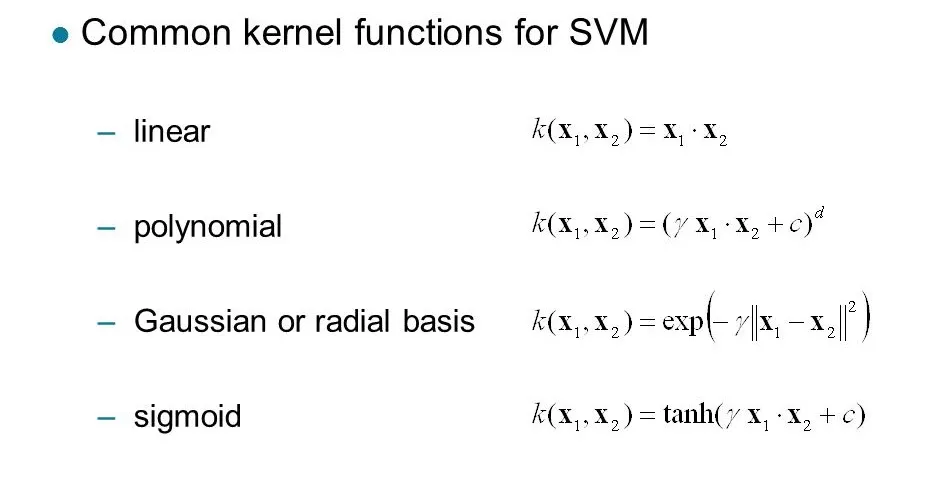

- **Vantagens**
  1. Não é muito influenciado por ruídos nos dados
  2. Utilizado para classificação e regressão
  3. Aprende conceitos não presentes nos dados originais
  4. Mais fácil de usar do que redes neurais

- **Desvantagens**
  1. Testar várias combinações de parâmetros
  2. Lento
  3. Black box


## SVM - Base Crédito

In [ ]:
with open ('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit.pkl', 'rb') as f:
  X_credit_treinamento, y_credit_treinamento, X_credit_teste, y_credit_teste = pickle.load(f)

In [ ]:
X_credit_treinamento.shape, y_credit_treinamento.shape

((1500, 3), (1500,))

In [ ]:
X_credit_teste.shape, y_credit_teste.shape

((500, 3), (500,))

In [ ]:
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix,ConfusionMatrixDisplay

In [ ]:
model_svm = SVC(kernel='rbf',C=100,random_state=38)
model_svm.fit(X_credit_treinamento, y_credit_treinamento)

SVC(C=100, random_state=38)

In [ ]:
model_svm.score(X_credit_treinamento, y_credit_treinamento)

0.9973333333333333

In [ ]:
pred_svm = model_svm.predict(X_credit_teste)

In [ ]:
pred_svm

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
y_credit_teste

array([1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1,
       0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0,
       0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,

In [ ]:
accuracy_score(y_credit_teste,pred_svm)

0.99

In [ ]:
print(classification_report(y_credit_teste,pred_svm))

              precision    recall  f1-score   support

           0       0.99      1.00      0.99       436
           1       0.98      0.94      0.96        64

    accuracy                           0.99       500
   macro avg       0.99      0.97      0.98       500
weighted avg       0.99      0.99      0.99       500



In [ ]:
cm = confusion_matrix(y_credit_teste,pred_svm)
cm
disp = ConfusionMatrixDisplay(cm,display_labels=np.unique(y_credit_teste))

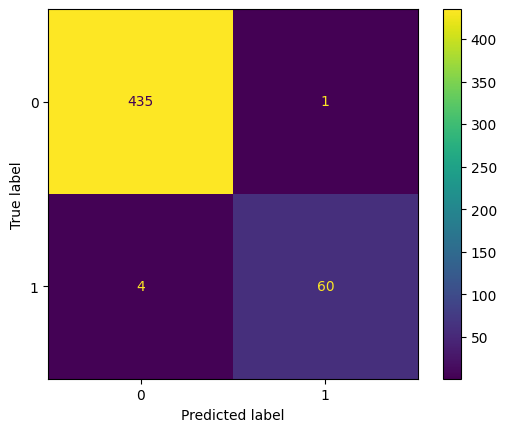

In [ ]:
disp.plot();

## SVM - Base Census


In [ ]:
with open ('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/census.pkl', 'rb') as f:
  X_census_treinamento, y_census_treinamento, X_census_teste, y_census_teste = pickle.load(f)

In [ ]:
X_census_treinamento.shape, y_census_treinamento.shape

((27676, 108), (27676,))

In [ ]:
X_census_teste.shape, y_census_teste.shape

((4885, 108), (4885,))

In [ ]:
model_svm = SVC(kernel='rbf',C=100,random_state=38)
model_svm.fit(X_census_treinamento, y_census_treinamento)

SVC(C=100, random_state=38)

In [ ]:
model_svm.score(X_census_treinamento, y_census_treinamento)

In [ ]:
pred_svm = model_svm.predict(X_census_teste)

In [ ]:
pred_svm

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' >50K'],
      dtype=object)

In [ ]:
y_census_teste

array([' <=50K', ' <=50K', ' <=50K', ..., ' <=50K', ' <=50K', ' <=50K'],
      dtype=object)

In [ ]:
accuracy_score(y_census_teste,pred_svm)

0.8325486182190379

In [ ]:
print(classification_report(y_census_teste,pred_svm))

              precision    recall  f1-score   support

       <=50K       0.88      0.90      0.89      3693
        >50K       0.67      0.61      0.64      1192

    accuracy                           0.83      4885
   macro avg       0.78      0.76      0.77      4885
weighted avg       0.83      0.83      0.83      4885



In [ ]:
cm = confusion_matrix(y_census_teste,pred_svm)
cm
disp = ConfusionMatrixDisplay(cm,display_labels=np.unique(y_census_teste))

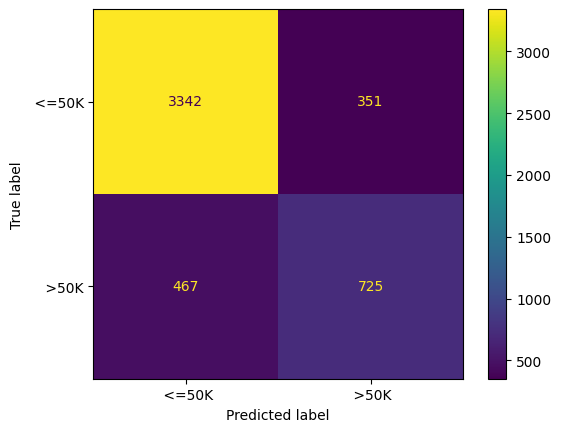

In [ ]:
disp.plot();

# REDES NEURAIS ARTIFICIAIS

## Syllabus

- Fundamentos Teóricos
  - Perceptron
  - Treinamento / ajuste dos pesos
  - Gradient descent (Descida do gradiente)
  - Cálculo do delta
  - Learning rate (taxa de aprendizagem)
  - Momentum (momento)
  - Back propagation
- Conceitos sobre deep learning
- Redes neurais com scikit-learn
- Redes neurais convolucionais, recorrentes, GANS, autoencoders(TensorFLow)

## Introdução redes neurais

Quando trabalhamos com reconhecimento facial, processamento de linguagem natural, não temos um algoritmo pré-determinando para esse tipo de problema. Por isso lançamos mão do uso de redes neurais como ferramenta para a solução de problemas como estes.
- **Algumas aplicações:**
  - Entendimento de linguagem natural
  - Carros autônomos
  - Reconhecimento facial
  - Bolsa de valores
  - Predições de falhas em equipamentos industriais
  - Encontrar soluções para controle de tráfego

As redes neurais artificiais são baseadas no sistema neural humano, que são vários neurônios conectados entre si, onde a informção é passada de neurônio para neurônio. (Uma pequena abstração de como o cérebro funciona).

- Imitar o sistema nervoso de humanos no processo de aprendizagem
- Inspirada em redes neurais biológicas
- Parecido com a troca de informações em uma rede biológica



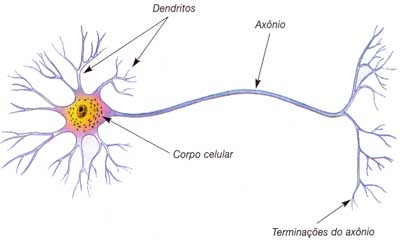

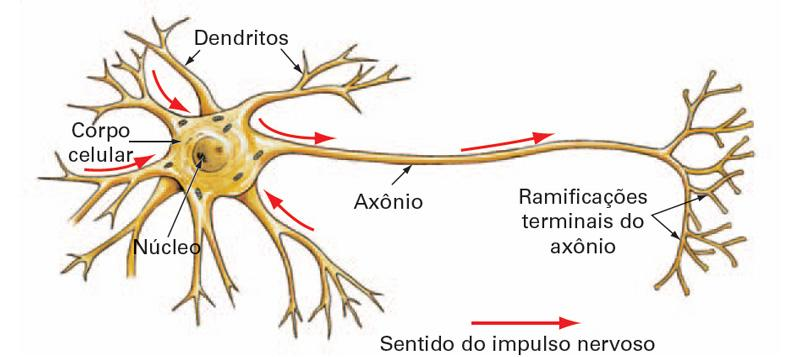
---

Acima temos uma referência de um neurônio biologico o qual a rede neural é baseada.

- **Neurônios:** o cérebro usa para processar informações
- **Axônio:** transmite o sinal de um neurônio para outro (sinais elétricos mais conhecido como sinapses) - conecta os neurônios
- Substâncias químicas são lançadas das sinapses e entram pelos dentritos, aumentando ou baixando o potencial elétrico do corpo celular
- O neurônio dispara se a entrada é maior que um número definido (liga ou não liga)
- **Na rede neural** é fornecido um valor de entrada, a rede neural vai processar e retornará uma resposta
- O neurônio é ativado somente se o valor for maior que um certo limiar

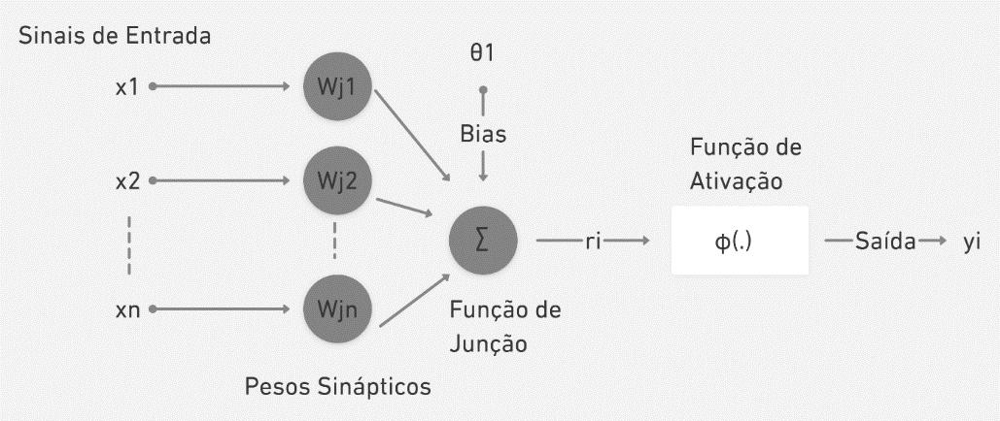

---



## Neurônio artificial / Perceptron de uma camada

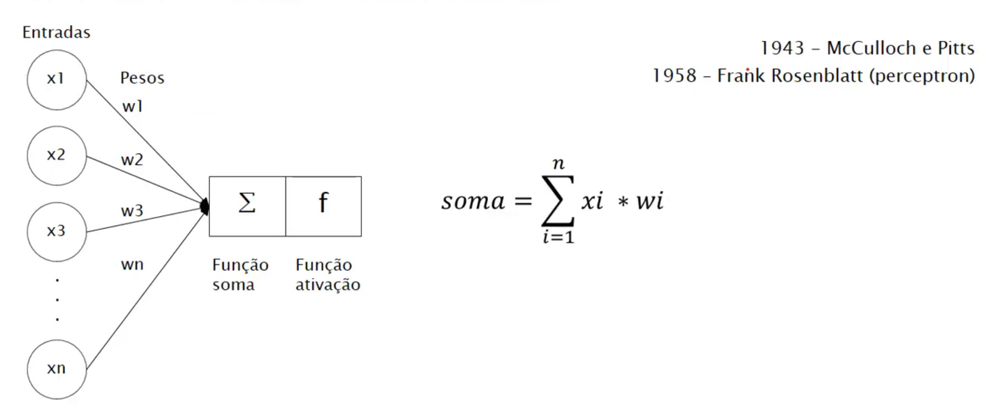

Observemos a estrutura de um neurônio artificial, onde temos a camada de entrada
que pode ser composta por Xn entradas, cada entrada esta liga a um peso Wn,a equação matemática básica que pode ser chamada de função soma que é um somatório do produto de cada entrada pelo seu respectivo peso.

**O Perceptron de uma camada ou Perceptron de Rosenblatt é um neurônio artificial que somente contém uma camada de entrada e uma camada de saída**

- Peso positivo = Sinapse excitatoria
- Peso negativo = Sinapse inibidora
- Pesos são sinapses
- Pesos amplificam ou reduzem o sinal de entrada
- O conhecimento da rede neural são os pesos, ou seja, o que ela irá aprender será o melhor conjunto de pesos para uma base de dados.

## Tipos de aprendizagem de máquina

A aprendizagem de máquina é dividida em 3 partes básicamente:

1. **Supervisionada**
  - Classificação
  - Regressão

2. **Não Supervisionada**
  - Associação
  - Agrupamento (Clustering)
  - Detecção de Desvio
  - Padrões sequenciais
  - Sumarização

3. **Reforço**
   - Aprender com as interações com o ambiente (causa e efeito)
   - Aprender com sua prória experiência

---

Um exememplo de Redes Neurais relativo a Classificação:

**Tipo de Parafusos**

X1 - Comprimento do parafuso - entrada
X2 - Diâmentro do parafuso - entrada

Classe A (0) - saida
Classe B (1) - saida

Temos 2 entradas e uma saída

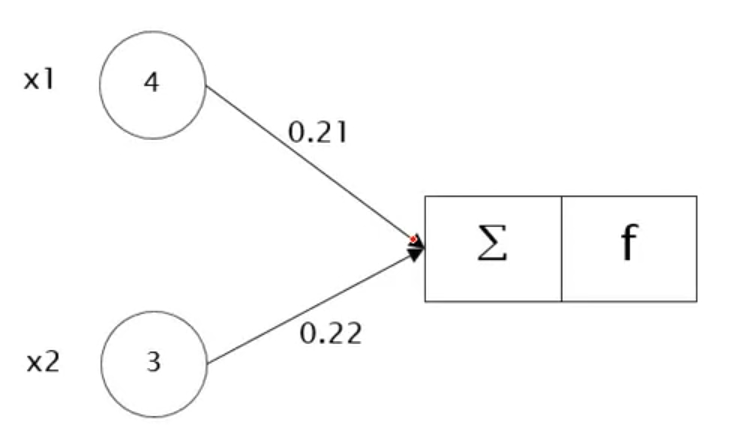

- Para classificar fazemos a função soma
- Com valor da função soma passamos para função de ativação no nosso caso Step Function
- O resultado da função de ativação nos da o resultado da Classe


## Ajuste de Pesos

O ajuste de pesos em redes neurais é o processo pelo qual o modelo aprende com os erros para melhorar suas previsões

Neste caso estamos usando uma rede com Perceptron de Rosenblatt

- Erro
  - O algoritmo mais simples é: **erro = respostaCorreta - respostaErrada**

- Os pesos são atualizados até os erros serem pequenos
  - **peso(n+1) = peso(n) + (taxaAprendizagem * entrada * erro)**

O processo de atualização do peso é realizado até redução do erro ao minimo possível.

Em resumo o Perceptron de Rosenblatt (uma camada) é eficiente para problemas linearmente separáveis, ou seja, classificações simples.

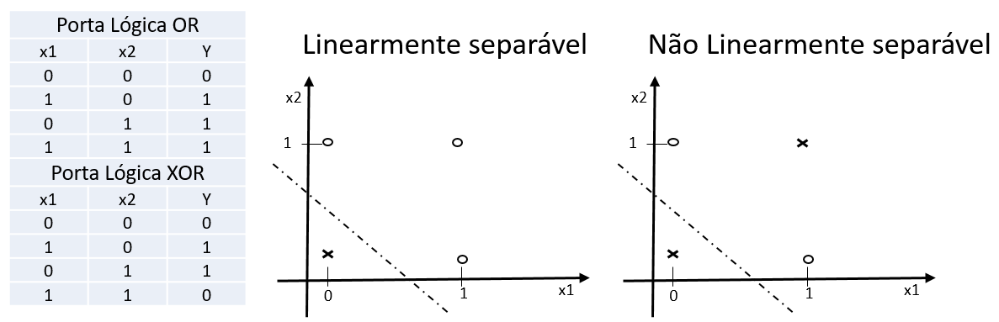

## Introdução a redes neurais multicamada

Para resolver o problemas não linearmente seperável, lançamos mão das redes neurais multicamadas.

Redes neurais multicamadas (MLPs) são modelos de aprendizado profundo compostos por múltiplas camadas de neurônios artificiais, capazes de aprender padrões complexos e realizar tarefas como classificação, regressão e reconhecimento de padrões.

Uma rede neural multicamada (MLP – Multilayer Perceptron) é uma arquitetura de rede neural composta por:

- Camada de entrada: recebe os dados brutos (ex.: pixels de uma imagem, características de um produto).

- Camadas ocultas: uma ou mais camadas que processam os dados por meio de pesos e funções de ativação. É aqui que ocorre a extração de padrões complexos.

- Camada de saída: fornece o resultado final, como uma classificação ou valor previsto.

Cada neurônio em uma camada está conectado aos neurônios da próxima camada, formando uma rede densa de conexões.


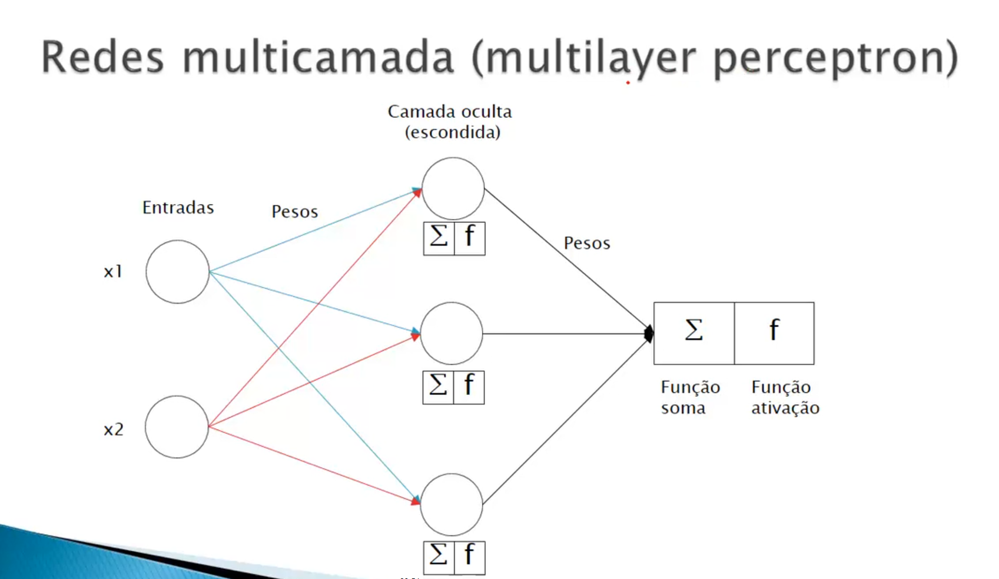


⚙️ Como funciona?
  1. **Propagação direta (feedforward pass):**
      - Os dados entram pela camada de entrada.
      - São transformados pelas camadas ocultas usando pesos e funções de ativação (como ReLU, sigmoid ou tanh).
      - A saída é gerada na última camada
  2. **Retropropagação (backpropagation):**
      - Após comparar a saída com o valor esperado (erro), o modelo ajusta os pesos usando o algoritmo de gradiente descendente.
      - Esse processo é repetido em várias iterações (épocas) até que o erro seja minimizado.

🔍 Características importantes

- Capacidade de aprendizado não linear: MLPs podem modelar relações complexas entre variáveis.

- Treinamento supervisionado: geralmente treinadas com dados rotulados.

- Sensíveis à escolha de hiperparâmetros: número de camadas, neurônios, taxa de aprendizado, etc.

## Funções de ativação

Em uma rede neural, cada neurônio realiza uma operação matemática: ele soma os valores de entrada multiplicados por seus respectivos pesos e adiciona um bias. O resultado dessa soma é então passado por uma função de ativação, que decide o que será transmitido para a próxima camada.

Sem funções de ativação, a rede seria apenas uma combinação de operações lineares — incapaz de capturar relações complexas entre os dados.

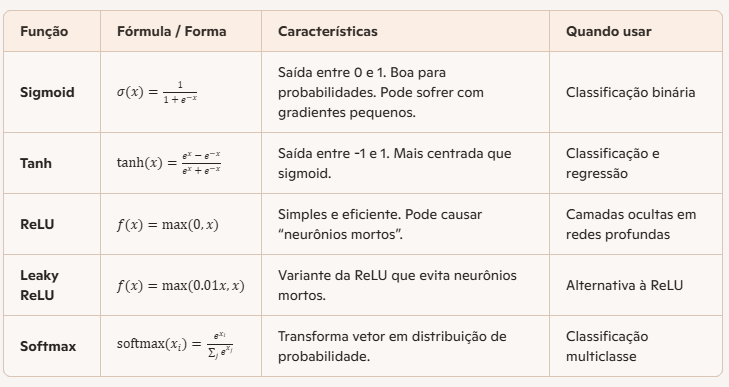

- **Sigmoid**: Retorna valores entre 0 e 1, Se **X** for alto o valor será aproximadamente 1, se **X** for pequeno o valor será aproximadamente 0 e esta função não retornar valores negativos

- **Tangente Hiperbolica:** Essa função retorna valores entre -1 e 1, ou seja, já há possibilidade de retorno de valores negativos.

## Ativação Camada Oculta

Usando o problema do Operador XOR para explicação, uma vez que ele não é linearmente separavel.

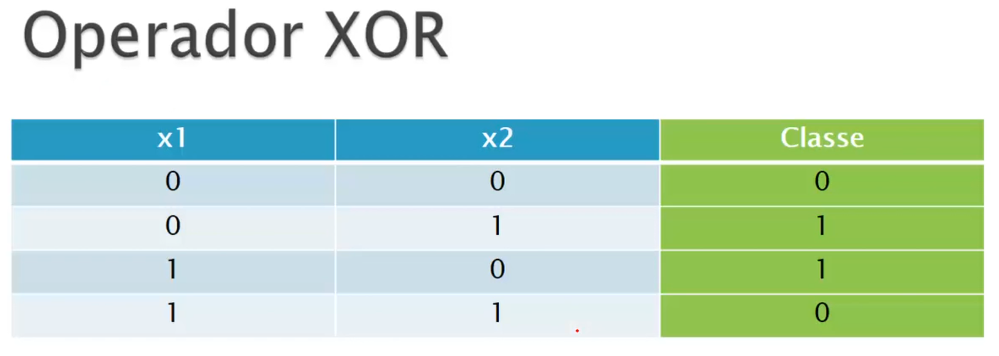

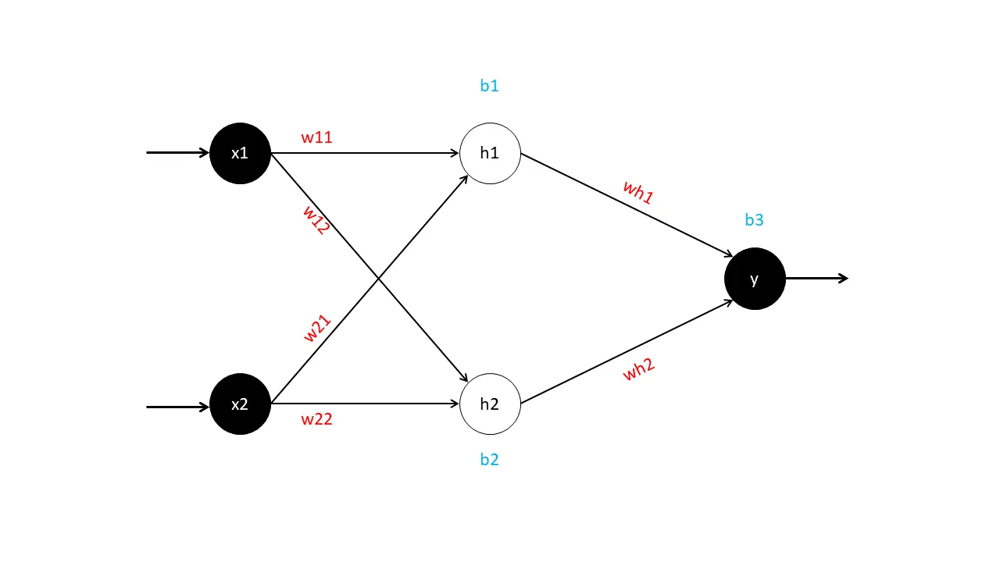



De acordo com a tabela de classe e os atributos de entrada vamos passar cada registro afim dos pesos serem ajustados para obtermos o menor erro possível.

Os pesos numa rede neural são inicializados de uma forma aleatória e conforme a rede vai sendo treinanda esses valores vão sendo ajustado e atualizados para termos o menor erro possível. No nosso exemplo a função de ativação usada é a sigmoid.

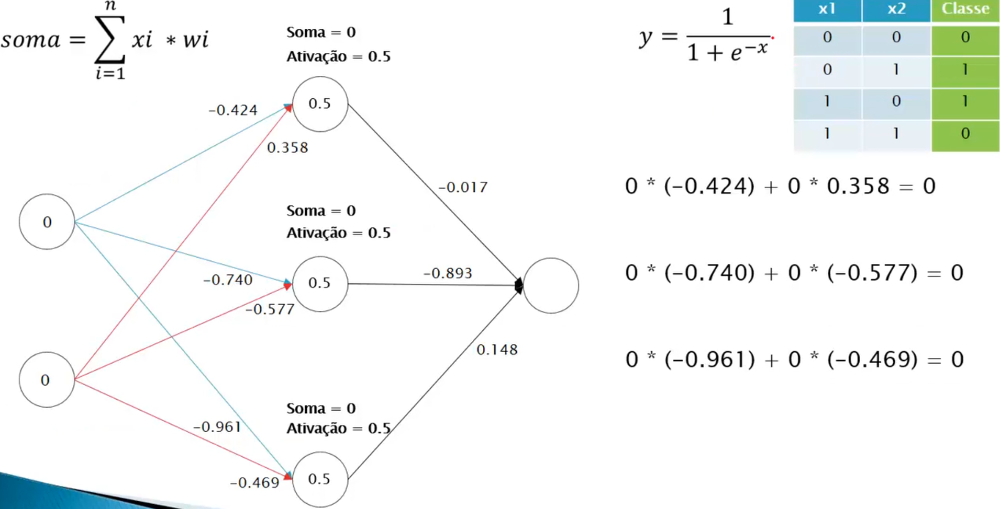

Observe acima que o primeiro registro onde X1 e X2 são 0 fizemos todos o processamento e chegamos a conclusão que a ativação para os 3 neurônios na camada escondida foi de 0.5.

O processo será feito para todos os registros contidos na tabela até obtermos os melhores pesos que atendam todos os registros com erro minimo.



## Ativação camada de saída

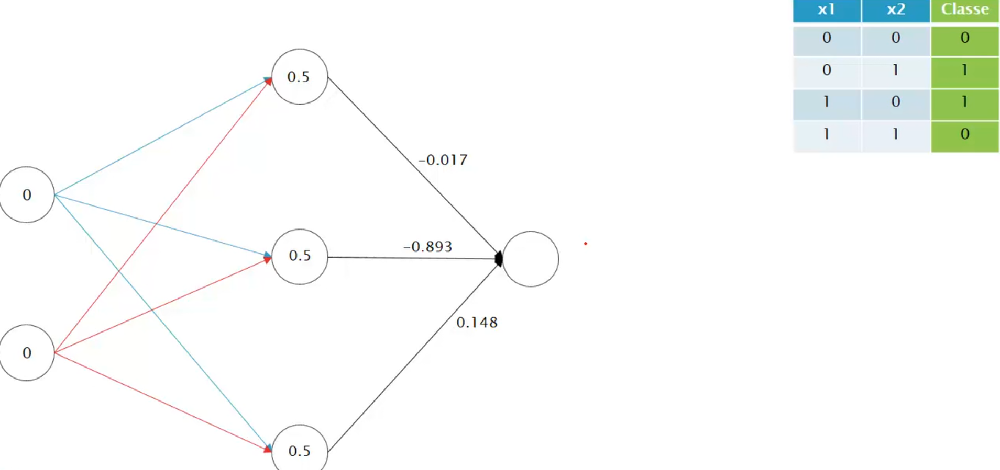


Acima já temos a função de ativação feita na camada oculta para o primeiro registro onde X1 e X2 são 0 respectivamente.

Para a camada de saída o processo é o mesmo, usamos a função soma onde multiplicaremos o valor de cada neurônio da camada oculta pelos seus respectivos pesos e iremos fazer o somatório de todos os valores.
Depois da soma passaremos o valor na função de ativação.

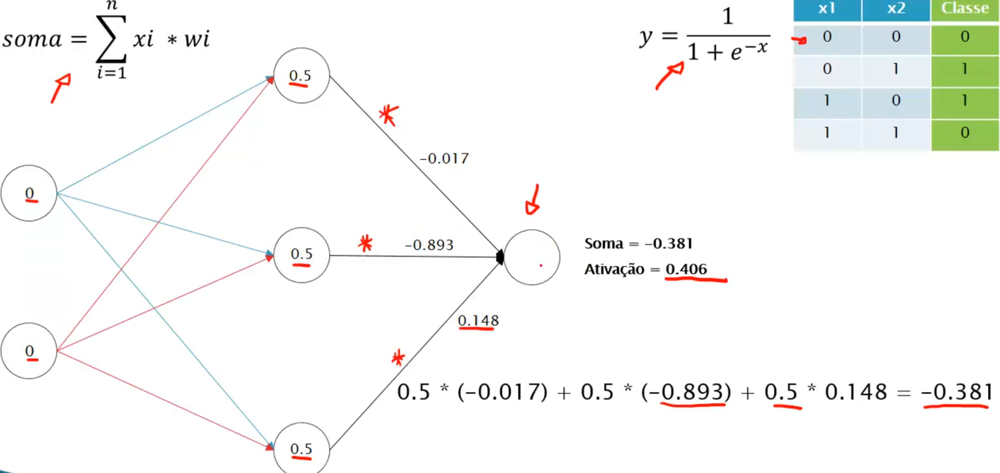

De posse do resultado na camada de saída temos: **0.406**
Como estamos em um treinamento supervisionado temos que fazer o calculo do erro que é:

**erro = valor real - valor predito**

**erro = 0-0.406 = -0.406**

Queremos um valor bem próximo de 0 que é o resultado para esse primeiro registro.
Todos os registros serão passados na rede neural afim de que o os pesos de toda rede neural sejam ajustado afim de termos o menor erro possível para todos os registros e que tenha uma boa generalização e convergência.

## Pesos e erros

- **Algoritmo**
  - Inicializa os pesos com valores aleatórios
  - Baseado nos dados (aprendizagem supervisionada), realiza os cálculos com os pesos e calcula o erro
  - Calcula as mudanças nos pesos e os atualiza (backpropagation)
  - O Algortimo termina quando o erro é pequeno

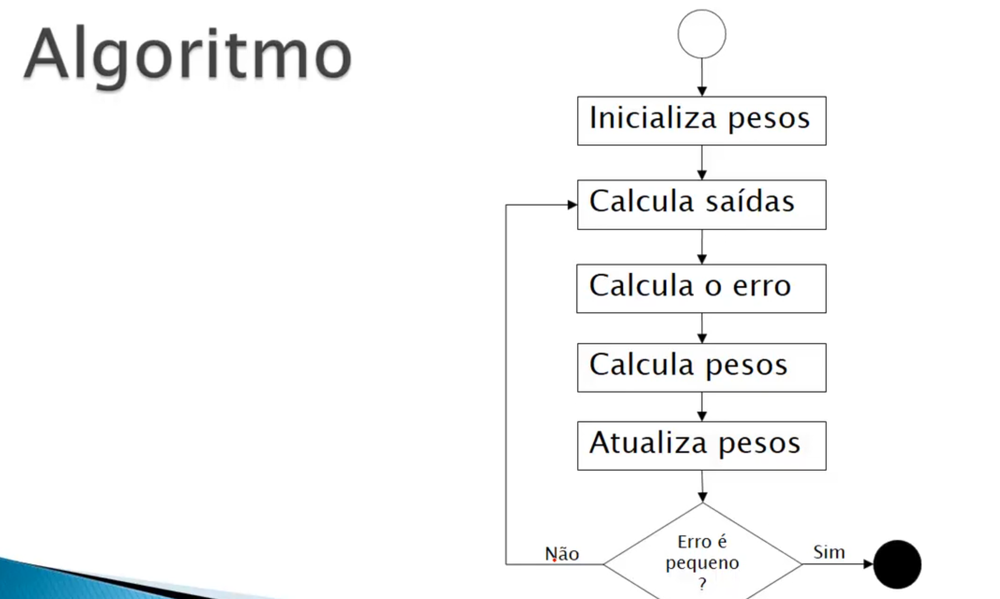

Para fazer a atualização de peso temos:

- Gradiente (gradiente descent)
- Derivada
- Cálculo do delta
- Backpropagation
- Learning rate (taxa de aprendizagem)
- Momentum (momento)

## Descida do Gradiente

Em relação ao gradiente observe a imagem a seguir, inicializamos com pesos aleatórios e o erro está alto, a ideia  ir modificando os peso até o ponto de termos o menor  erro possível.

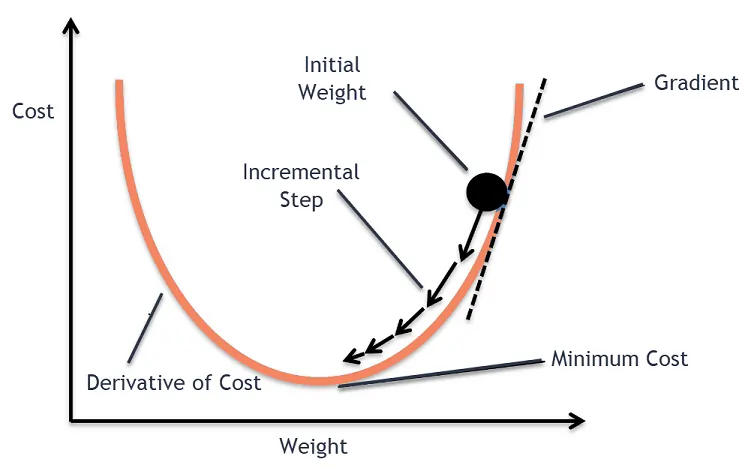

---

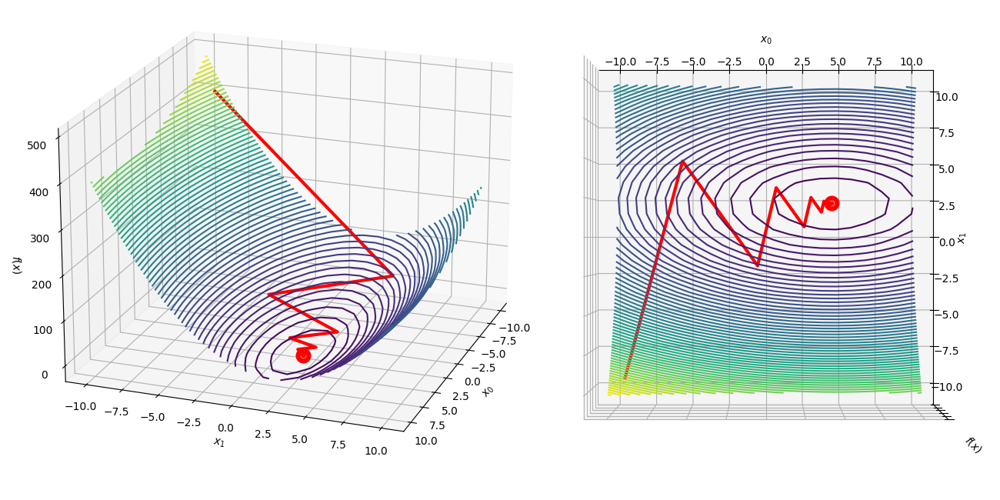

E como funciona esse ajuste de pesos?!?!
O objetivo é Min | C(W1, W2..Wn) , achar pesos para minimizar a função custo.
Para isso calculamos a derivada parcial para mover para a direção do gradiente

📉 Como funciona?

1. **Função de custo:** Representa o erro do modelo. Exemplo comum: erro quadrático médio.

2. **Gradiente:** É o vetor de derivadas parciais da função de custo em relação aos parâmetros do modelo. Ele aponta na direção de maior crescimento da função

3. **Atualização dos parâmetros:** A cada passo, o algoritmo calcula o gradiente da função de custo. Move os parâmetros na direção oposta ao gradiente (por isso “descida”), com um passo de tamanho definido pela taxa de aprendizado.

- Fórmula:
𝜃novo:= 𝜃−𝛼⋅∇𝐽(𝜃)

Onde:
- 𝜃: são os parâmetros do modelo
- 𝛼: é a taxa de aprendizado
- ∇𝐽(𝜃): é o gradiente da função de custo



🧪 Exemplo prático: função quadrática
Vamos usar a função de custo:

- 𝐽(𝜃) = (𝜃−3)²

Essa função tem um mínimo global em
 𝜃= 3, onde o valor de 𝐽(𝜃) é zero.

🔁 Aplicando a descida do gradiente
Escolha um valor inicial: Suponha que começamos com
𝜃 = 0

- Calcule o gradiente: Derivada de 𝐽(𝜃) é: 𝑑𝐽/𝑑𝜃= 2(𝜃−3)

Atualize o valor de 𝜃 Usando a fórmula: **𝜃novo:= 𝜃−𝛼⋅∇𝐽(𝜃)**

- Com taxa de aprendizado
𝛼=0.1, temos: 𝜃novo:=0−0.1*2(0−3)=0+0.6=0.

A cada iteração 𝜃 ficará mais próximo de 3


## Cálculo do parâmetro Delta - Camada Oculta e Camada Saída

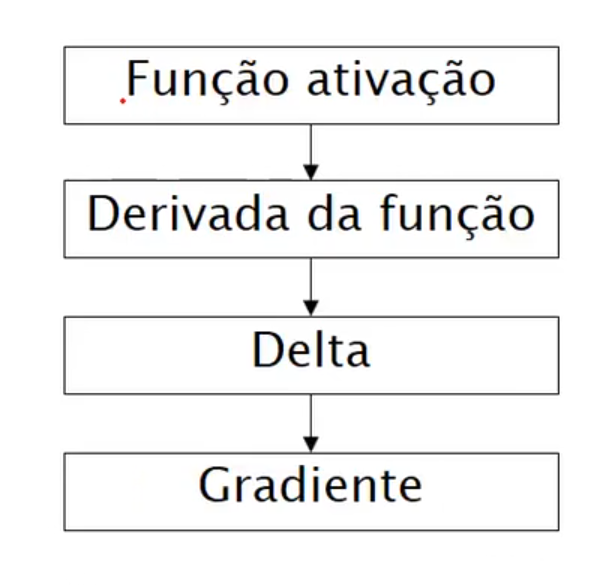

É um parâmetro crucial utilizado no algoritmo de backpropagation (retropropagação) para calcular a direção e a magnitude da atualização dos pesos, com o objetivo de minimizar o erro global da rede.
Nós temos o valor da função de ativação porém precisaremos fazer a derivada da função de ativação, tendo o resultado da derivada da função conseguiremos fazer o calculo do parâmetro Delta que nos auxiliará o calculo do Gradiente.

Com este valor de delta saberemos para onde devemos calcular nosso gradiente uma vez que na função podemos ter minimos locais e o global.

- *Cálculo do Delta:* (Regra Delta)
 O método de cálculo do delta varia ligeiramente entre a camada de saída e as camadas ocultas:

- *Camada de Saída:* O delta para um neurônio na camada de saída é calculado multiplicando a diferença entre a saída real (esperada) e a saída prevista (o erro) pela derivada da função de ativação desse neurônio.

  **Fórmula geral:** 𝛿𝑠𝑎𝑖𝑑𝑎 = Erro*Derivada da Função de Ativação

- *Camadas Ocultas:* Para os neurônios nas camadas ocultas, o cálculo do delta é mais complexo, pois o erro não é diretamente conhecido. O delta é calculado com base na soma ponderada dos deltas da camada posterior (mais próxima da saída), multiplicada pelos pesos das conexões e pela derivada da função de ativação do próprio neurônio da camada oculta.

  **Formula Geral:** 𝛿oculta=(∑𝛿posterior*Pesos)*Derivada da Função de Ativação

- **O delta (𝛿) é o gradiente local de cada neurônio. Ele indica quanto e em qual direção os pesos devem ser ajustados para reduzir o erro da rede.**

1. Na camada de saída
Fórmula:

  - 𝛿saída=(𝑦esperado−𝑦obtido)⋅𝑓′(𝑧)

Uso: serve para calcular diretamente o erro da saída e ajustar os pesos que ligam a última camada à saída.

2. Nas camadas ocultas
Fórmula:

  - 𝛿oculta=(∑𝛿posterior⋅Pesos)⋅𝑓′(𝑧)

Uso: o delta da camada oculta é calculado a partir dos deltas da camada seguinte (posterior). Isso permite que o erro seja propagado para trás pela rede.

3. Atualização dos pesos

Cada peso é ajustado usando o delta:

  - 𝑤novo=𝑤antigo+𝜂⋅𝛿⋅𝑥


**Paralelo com a Descida do Gradiente**
  - A descida do gradiente é um método de otimização que ajusta os parâmetros (pesos) na direção que minimiza a função de custo.

  - Gradiente: indica a inclinação da função de custo em relação aos pesos.

  - Delta: é justamente o gradiente local calculado para cada neurônio.

👉 Em outras palavras:

O delta é o "pedaço" do gradiente que cada neurônio contribui.
A descida do gradiente usa esses deltas para mover os pesos na direção que reduz o erro global.

🔍 Analogia simples
Imagine que você está descendo uma montanha (função de custo).

- O gradiente indica a inclinação da montanha.
- O delta é como se cada passo fosse calculado localmente para cada ponto do caminho.
- A taxa de aprendizado (𝜂) é o tamanho do passo que você dá

**DELTA CAMADA DE SAÍDA**

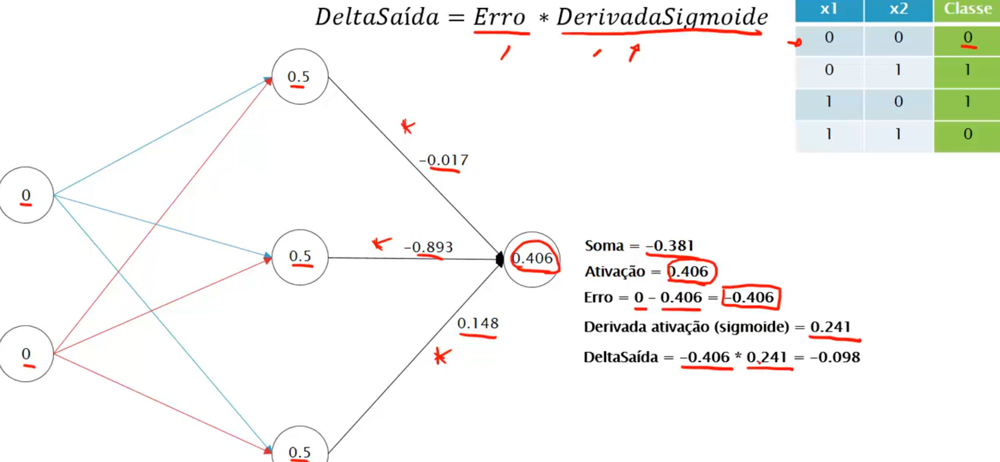

**DELTA CAMADA OCULTA**

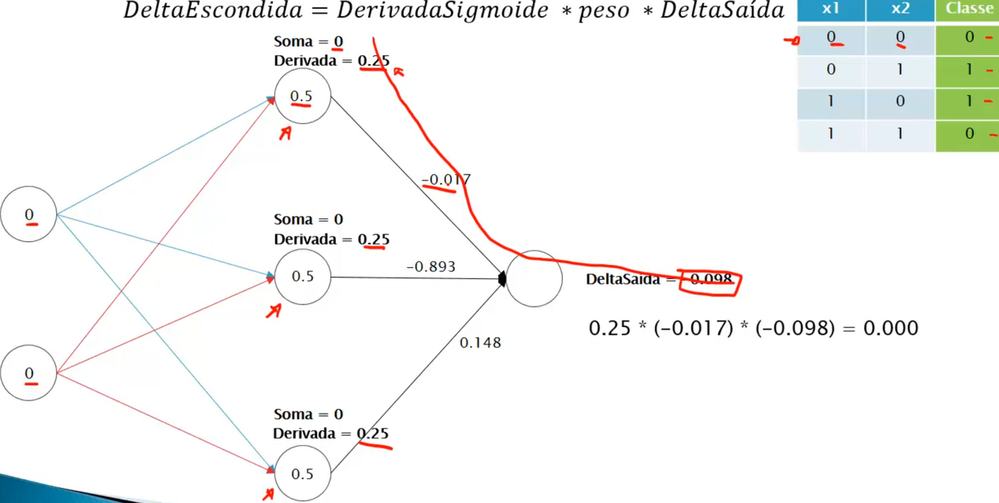

## Backpropagation, taxa de aprendizagem e momento




- **Backpropagation** é o algoritmo que permite às redes neurais aprenderem ajustando seus pesos para minimizar o erro entre a saída prevista e a saída desejada. Ele funciona aplicando a regra da cadeia para calcular gradientes e atualizar os pesos camada por camada.
Um método de treinamento usado em redes neurais artificiais. Ele calcula como cada peso contribuiu para o erro final e ajusta esses pesos para melhorar o desempenho da rede. É o coração do aprendizado supervisionado em redes neurais profundas.

- **Taxa de aprendizagem** define quão rápido o algoritmo vai aprender, uma taxa ALTA a convergência é rápida mas pode perder o mínimo global, já uma taxa BAIXA será mais lento para convergir mas tem mais chances de chegar no mínimo global.

- **Momento**, server para escapar de mínimos locais, define o quão confiável é a última alteração. Técnica de otimização usada junto com a descida do gradiente para acelerar o treinamento e evitar que o processo fique preso em mínimos locais ou oscile demais. É um parametro a mais porém nem sempre funciona mas pode ser usado nas bilbiotecas de ML




## Ajustando os pesos

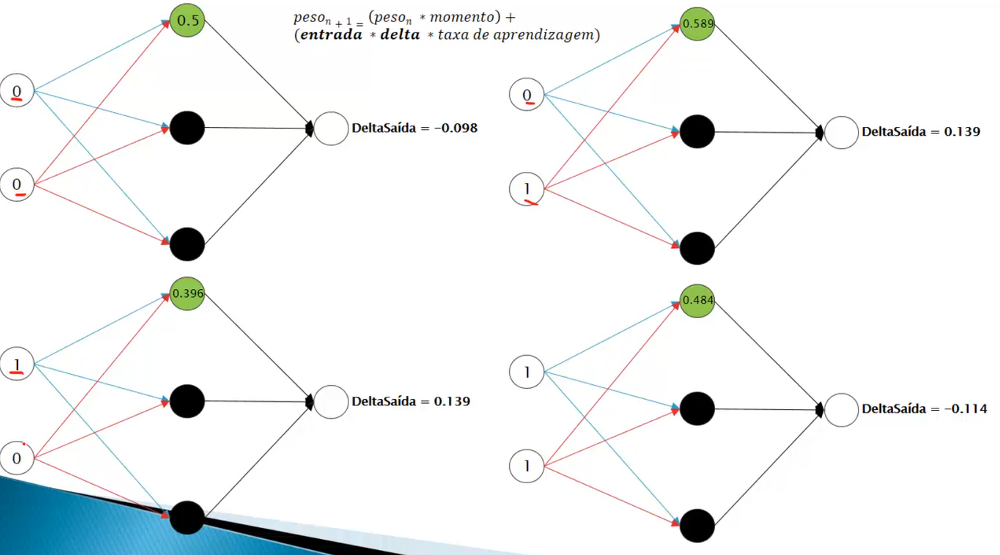

Fazemos para cada neuronio da camada oculta o calculo da formula acima.
Lembrando que o termo **Entrada*Delta** é um somatorio de para cada neuronio:

*Exemplo*

Para o primeiro neuronio da nossa rede neural, com todas as entradas possíveis.

Entrda * Delta = 0.5*(-0.098)+0.589*(0.139)+0.396*(0.139)+0.484*(-0.114) = 0.0032

Isso se repete para cada neuronio.






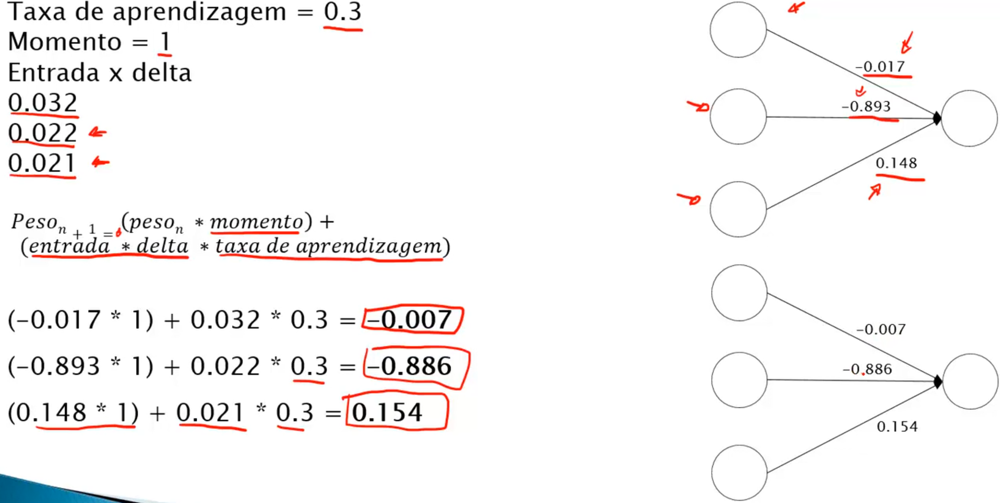

Para camada oculta seguimos também a mesma lógica, porém usando o delta da camada oculta.

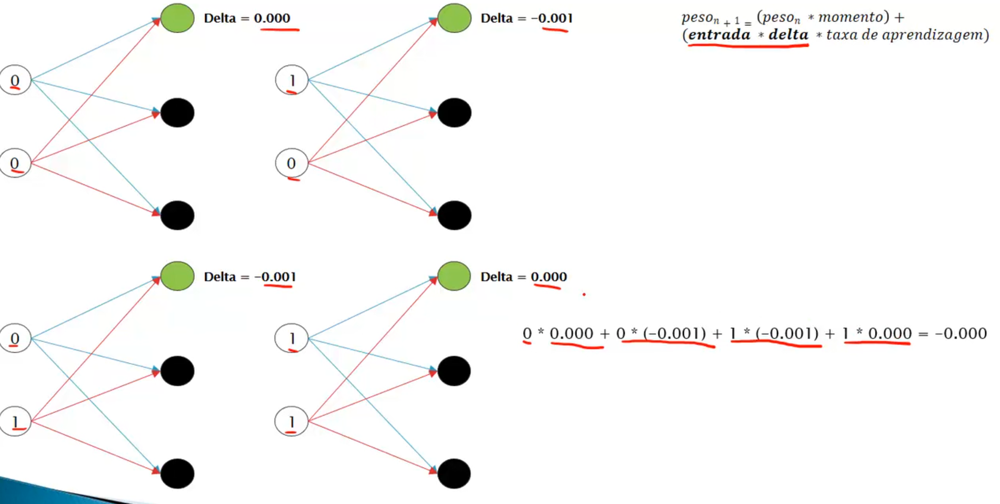

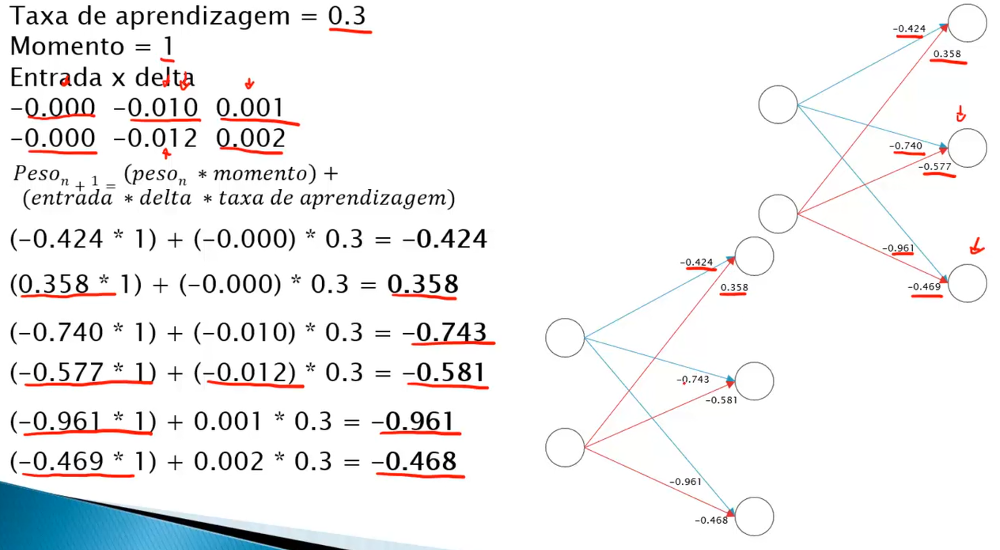

##Bias e Erro


Bias, também chamada de viés em português.
Temos nossa rede neural com nossa saida, e camada oculta com seus respectivos pesos e entradas, o bias ele adiciona um atributo um valor a mais em cada uma das camadas.
Perceba que há uma adição de valor 1.



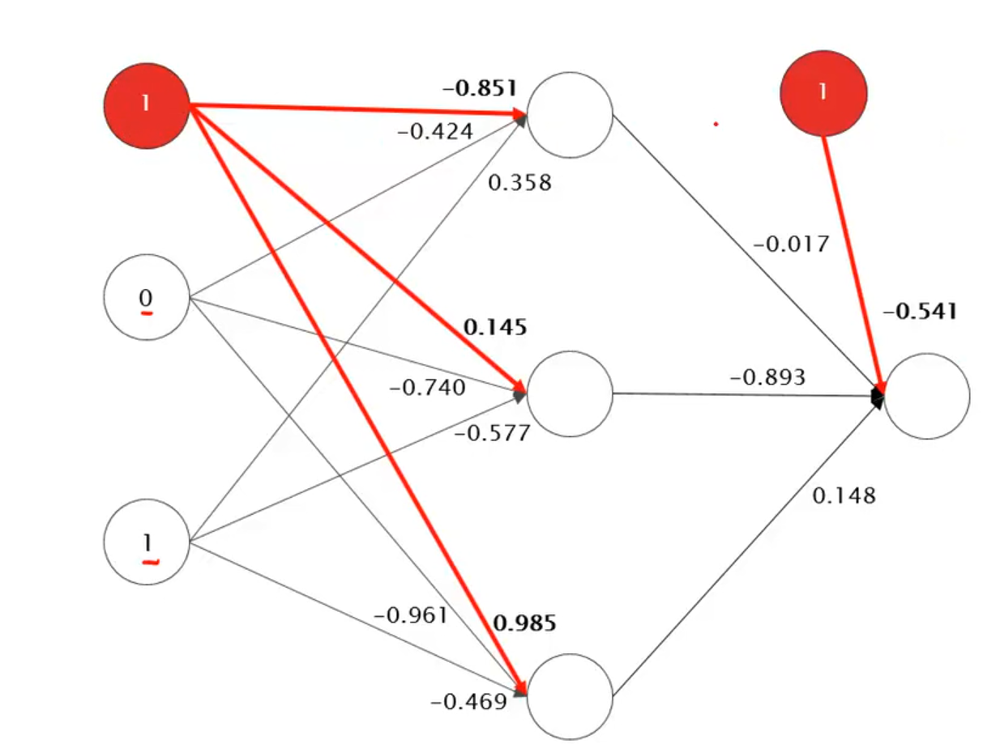

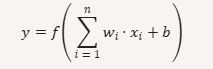

𝑥𝑖: entradas (features)

𝑤𝑖: pesos associados a cada entrada

𝑏: bias (termo de deslocamento)

𝑓(⋅): função de ativação (sigmoid, ReLU, tanh, etc.)

𝑦: saída do neurônio

**Papel do bias**
**Deslocamento da função de ativação:** sem o bias, todas as funções passariam pela origem. O bias permite que o modelo se ajuste melhor aos dados.

**Maior flexibilidade:** ajuda a rede a aprender padrões que não são centrados em zero.

**Analogia geométrica:** em um perceptron simples, o bias desloca o hiperplano de decisão, permitindo que ele se ajuste em diferentes posições do espaço de entrada.

O erro, pode ser simplismente  calculado como:

erro = (saida prevista - saida esperada), entretanto em redes neurais temos algumas outras maneira de calular o erro que são:

- MSE (Mean Square Error): erro quadratico médio, em resumo é a média da diferença entre o esperado e o que foi previsto pela rede. Erros maiores contam mais que erros menores,ou seja, erros maiores serão penalizados.

- RMSE (Root Mean Square Error): Raiz do erro quadratico médio.

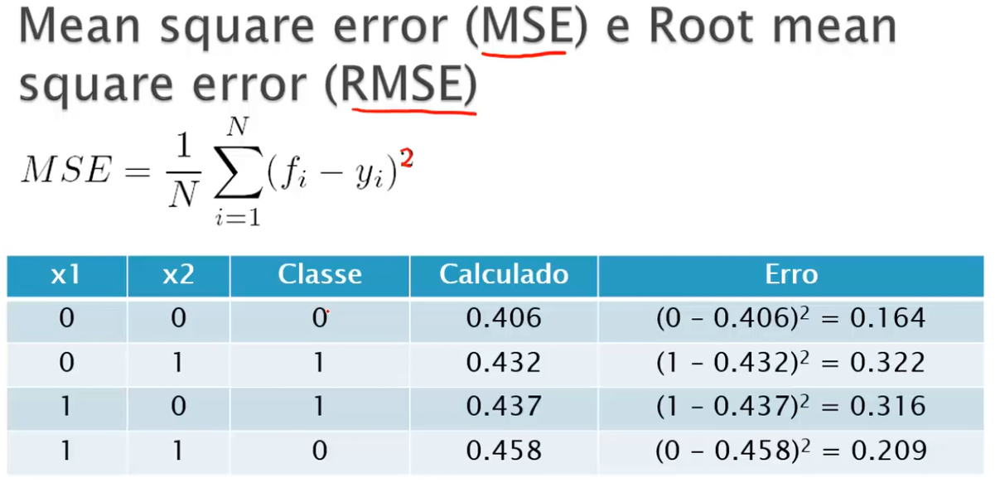

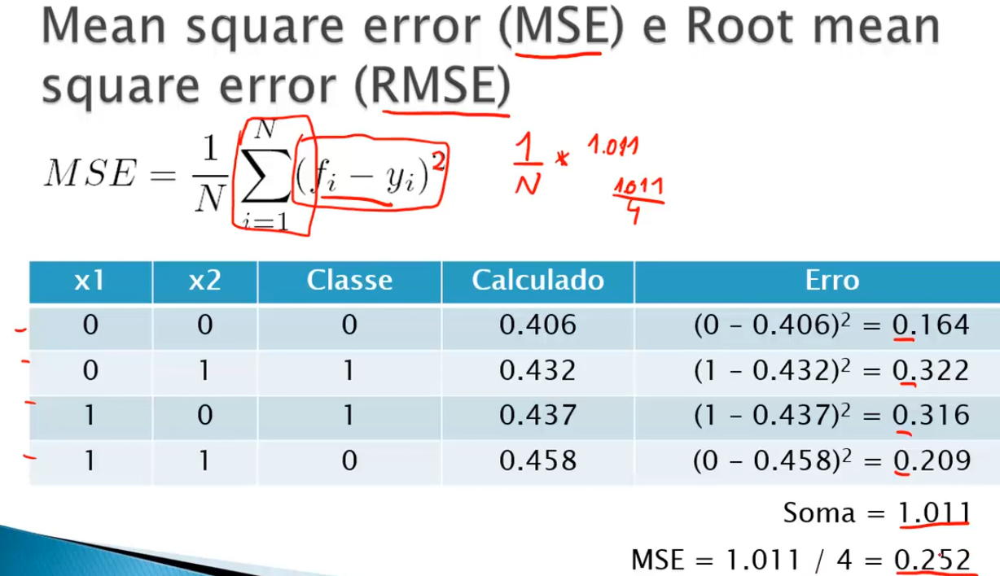

## Rede neural multicamada

**Camada Multipla Saida**

Uma rede neural multicamada (MLP) é um modelo de aprendizado de máquina composto por várias camadas de neurônios artificiais. Ela processa informações de forma hierárquica: a camada de entrada recebe os dados, as camadas ocultas extraem padrões complexos e a camada de saída gera a resposta final.
É uma rede neural artificial com mais de uma camada de neurônios conectados em sequência.


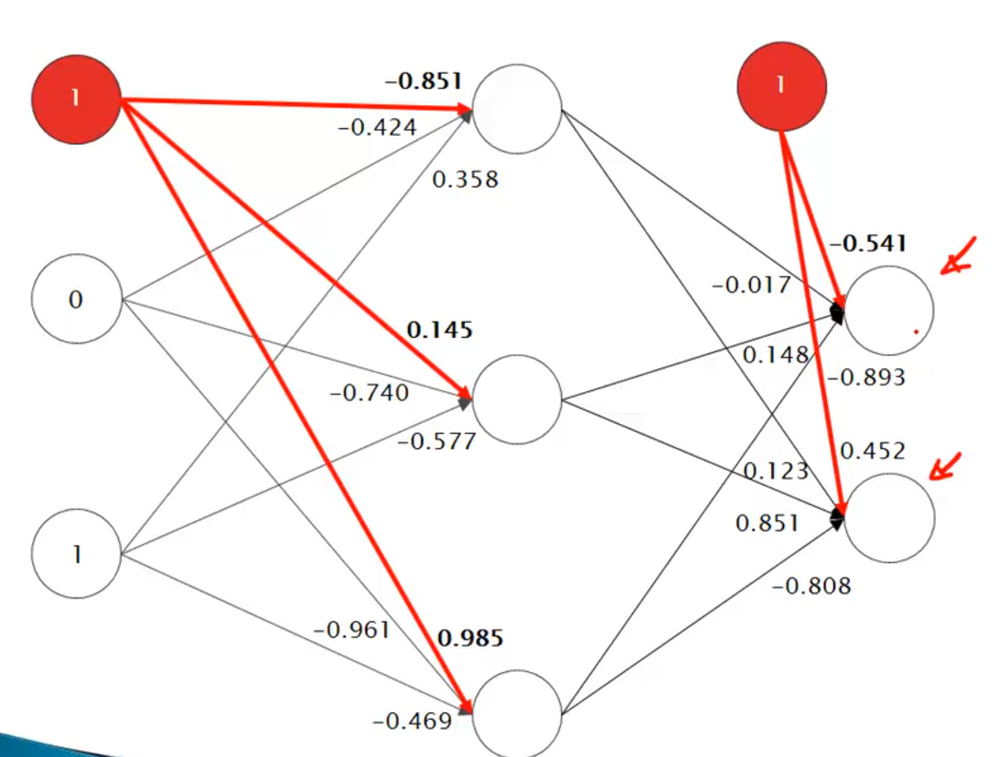

Acima temos um exemplo com 2 neuronios na camada de saída o processamento é mesmo.


**Pesos sinápticos:** cada conexão entre neurônios tem um peso que indica a importância do sinal.

**Propagação direta:** os dados fluem da entrada até a saída.

**Retropropagação (backpropagation):** algoritmo usado para ajustar os pesos, minimizando o erro entre a saída prevista e a saída real.

**Função de perda:** mede o erro (ex.: erro quadrático médio ou entropia cruzada).

O que difere agora é que para os 2 neuronios da saída teremos 2 valores e devemos ter uma "regra" que classificaria quais valores representariam 0 e 1.



**Camadas Multipla Oculta**

Como definir o número de neurônios e camadas ocultas vou definir numa rede neural?
Apesar de não existir uma resposta exata para todos os casos e todas as base de dados sobre isso, existe uma formula bastante utilizada na literatura que é?

**Neurônios = (Entradas + Saídas)/2** - É uma boa referência para um inicio

 Em relação ao número de camadas ocultas temos alguns pontos e questão:

 - Podemos usar o Cross Validation para esse hiperparametro
 - Em geral, duas camadas funcionam bem para poucos dados
 - Problemas simples (classificação linear ou pouco complexa): Muitas vezes 1 camada escondida já é suficiente.Exemplo: classificar dados tabulares com poucas variáveis
 - Problemas moderados (não linearidade moderada): 2 a 3 camadas escondidas ajudam a capturar relações mais complexas. Exemplo: previsão de séries temporais básicas ou reconhecimento de padrões simples.
 - Problemas complexos (alta dimensionalidade e não linearidade): Necessário usar redes profundas (deep learning), com dezenas ou centenas de camadas.

O número de neurônios de camada oculta segue a mesma regra para a camada simples, ou seja, definido o numero baseado nas entradas e saida podemos usar este valor para todas as camadas ocultas;

O exemplo abaixo mostra uma rede neural para o problema da nossa base de crédito.


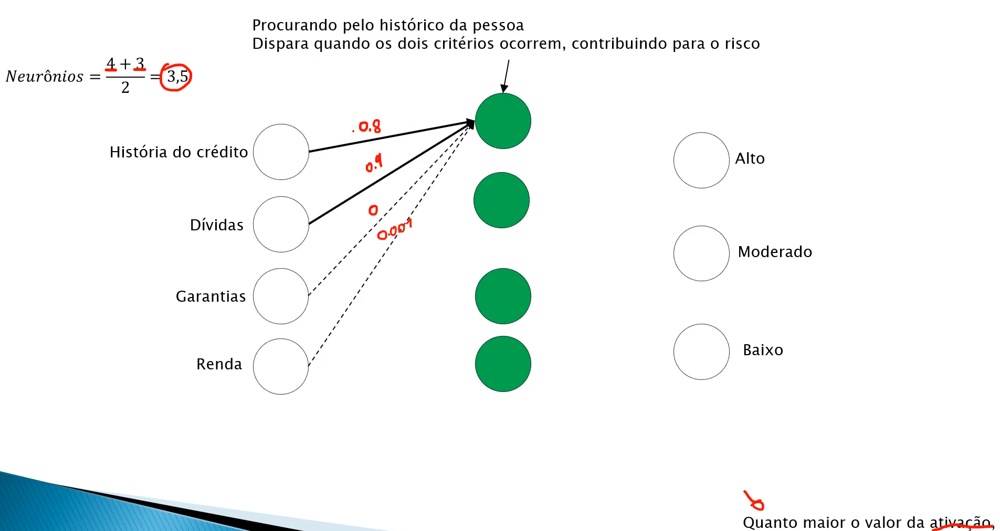

Temos um problema categórico neste caso, devemos transoformar esse problema com labels númericos como mencionados anteriormente.

Observemos que temos:
- 4 neuronios de entradas
- 3 neuronios de saida
- De acordo com regra do número de neurônios da camada oculta chegamos em 4

Cada neurônio de entrada será conectado a cada neurônio da camada oculta com seus respectivos pesos e bias. Note que para os 2 primeiros neurônios da camada de entrada **História de Crédito e Dívidas** que estão ligados ao primeiro neuronio da camada de entrada tem sua "conexão" mais intensa do que os 2 últimos neuronios **Garantias e Renda**.
Isso porque os pesos desses 2 primeiro neurônios são maiores que os 2 últimos que estão praticamente zerado, isso significa que essã duas primeiras entradas tem uma importancia maior que as outras para a função de ativação do respectivo neurônio da camada oculta.

**Batch & Stochastic Gradiente Descent**

------------------------------------------------------

Relembrando que o Gradient Descente (gradiente descendente) é um otimização matemática que tem por função minimizar uma função custo/objetivo.
Ele calcula a derivada parcial dessa função para mover a direção do gradiente.




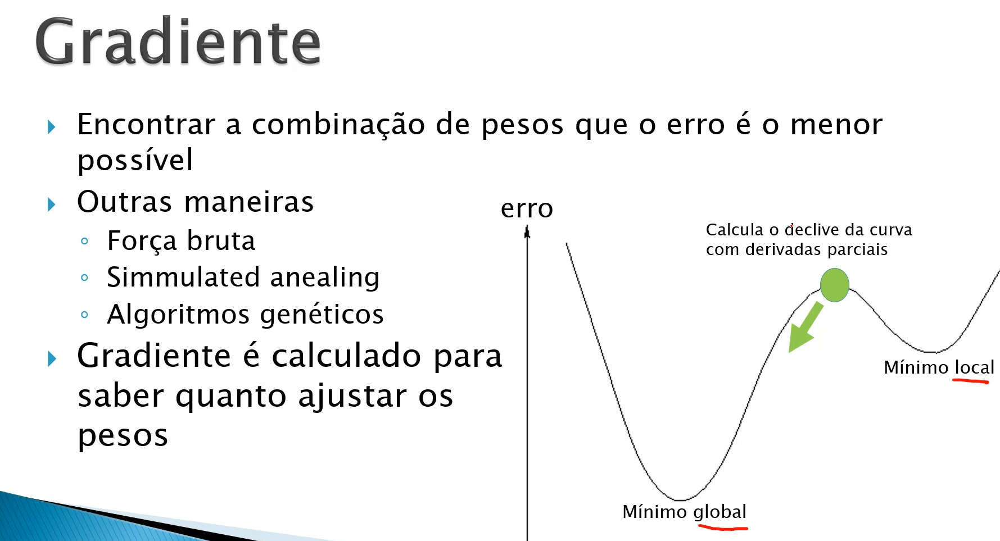

**O Batch Gradient descent**, calcula o erro para todos os registro e atualiza os pesos, é a forma mais classica onde, todos os registro de entrada são passados para rede neural e os pessoas são atualizados até minimizar o erro.

**O Stocastic Gradient descent**, calcula o erro para cada registro e atualizada o erro, ou seja, para cada entrada ele passa os registros individualmente pela rede neural e atualiza o peso para cada passagem de registro.


**Stochastic**:
  - Ajuda a previnir mínimos locais (superficies não convexas)
  - Mais rápido (não precisa carregar todos os dados em memória)

# AVALIAÇÃO DOS ALGORITMOS DE CLASSIFICAÇÃO

Iremos ver os seguintes tópicos:

- Matriz de confusão
- Verdadeiro positivo e falso positivo
- Precision e recall
- Overfitting e underfitting
- Validação cruzada (cross validation)
- Tuning de hiperparametros
- Como testar e avaliar os algoritmos (variância, desvio padrão, coeficiente de variação, distribuição normal, testes de hipóteses)
- Avaliação dos algoritmos com ANOVA e Tukey
- Salvar o classificadores já treinados


## Matriz de confusão

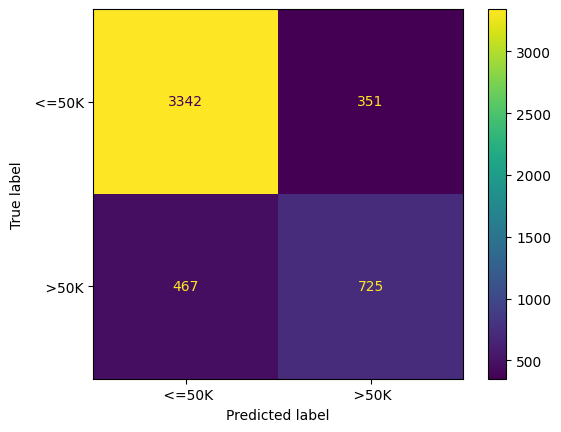

Na imagem acima temos uma matriz de confusão baseado na classificação de quem tem renda <=50k ou >50k

Em **True Label** temos a classicação verdadeira, e em **Predict Label** temos o que o nosso algoritmo previu.

- Temos um total de 3691 registros que estão na **Classe <=50** porém nosso algoritmo preveu corretamente 3342 registros e calssificou errado 467 registros

- Temos um total de 1192 registros que estão na **Classe >50** porém nosso algoritmo preveu corretamente 725 registros e classificou errado 351 registros

E para medirmos a quantidade de acertos que nosso algoritmo teve faremos o somatório da diagonal princiapal: **3342+725 = 4067** acertos.

E para os erros fazemos o somatorio dos demais valores fora da diagonal principal: **351+467 = 818** erros.

E total de registros é: ** 4067+818 = 4885**

Para o percentual de acerto temos: **(4067/4885)*.100 = 83,25%**
Para o percentual de erros temos: **(818/4885)*.100 = 16,75%**

Para sabermos o percentual de acerto e erro de cada classe devemos fazer:

Nível de acerto:
- Classe <=50K

  (3342 / 3693 ) * 100 = 90.5% que é o número de acerto da respectiva classe divido pelo total de evidencias da respectiva classe

- Classe >50k

(725 / 1192) * 100 = 60.89% que é o número de acerto da respectiva classe divido pelo total de evidencias da respectiva classe




## Verdadeiro positivo e falso positivo

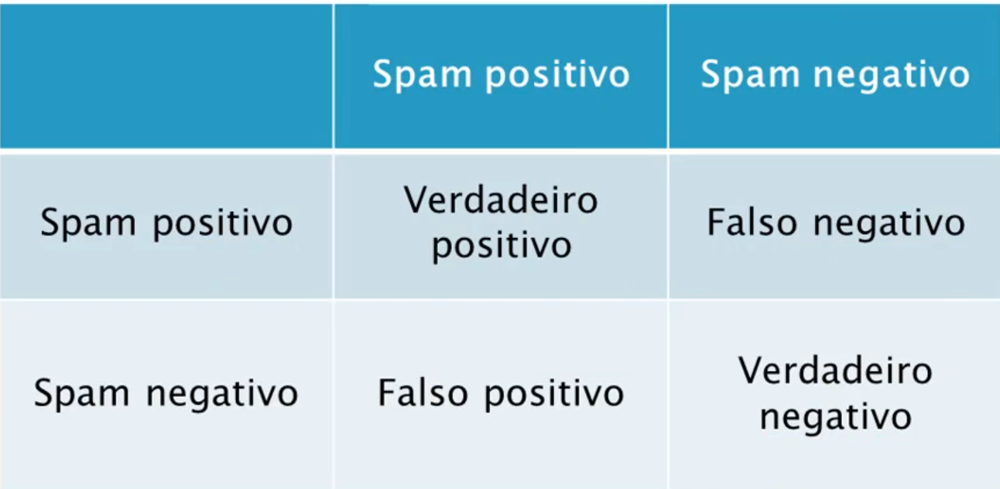

## Metricas de avaliação

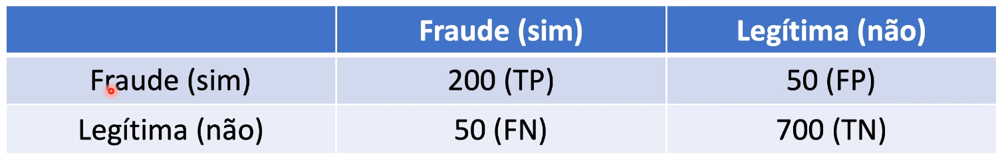

Temos acima um exemplo de fraude de cartão de crédito, um exemplo onde classificaremos se é Fraude ou Legimita as compras.

Temos 1000 registros no total.

Há uma séries de paramentros que devemos observar:

- True Positive(TP Verdadeiros Positivos): Quando o classificardor previu SIM (é fraude) e a classe correta é SIM (fraude)

- True negative(TN Verdadeiros Negativos): Quando o classificador preivu NÃO (não é fraude) e a classe correta é NÃO (não é fraude)

- False Positive(FP Falsos Positivos): Quando o classificador previu SIM(é fraude), mas a classe correta era NÃO (não é fraude)

- False Negatives(FN Falsos Negativos): Quando o classificador previu NÃO(não é fraude), mas a classe era SIM (é fraude)

Com base nessas informações podemos calcular: Accuray, F1-Score, Precision e Recall

- Accuracy: (Somatorio dos registros corretos / Quantidade total) *100

            (900/1000)*100 = 90%
- Precision: A precisão mede a qualidade das previsões positivas de um modelo. Ela responde à pergunta: "De todas as instâncias que o modelo previu como positivas, quantas eram realmente positivas?

Precision = TP / (TP + FP)

- Recall: O recall mede a completude das previsões positivas. Ele responde à pergunta: "De todas as instâncias que eram realmente positivas, quantas o modelo conseguiu prever corretamente?

Recall = TP / (TP+FN)

Geralmente, há um trade-off (relação de compromisso) entre precisão e recall. Melhorar um tende a piorar o outro. Por exemplo, para aumentar o recall (encontrar mais casos positivos), um modelo pode ser ajustado para ser menos seletivo, o que, por sua vez, aumentará o número de falsos positivos e diminuirá a precisão

## Cross Validation

Relembrando conceitos anteriores, para a avaliação do algoritmo nossa base de dados deve ser dividida 2 duas partes: **TREINAMENTO e TESTE**.

Nosso modelo é gerado a partir da base de TREINAMENTO o qual usará cada entrada dessa base para treinar.
E depois para ser testado usa-se uma bse destinta que é nossa base de dados de TESTE.


Em alguns casos a divisão de dados em 80% treinamento e 20% de teste não é tão boa uma vez que estes dados são escolhidos aleatoriamente, e poderiamos ter dados que são melhores para treinamento do que para teste e vice-versa.

Para evitar isso usamos a validação cruzada (K-Fold Cross Validation) aumenta a confiabilidade das métricas de desempenho e ajuda a evitar overfitting.
Avalia a capacidade de generalização do modelo, ou seja, como ele se comporta em dados novos e não vistos

Onde K é um número escolhido que ira fazer a divisao do base de dados.

Por exemplo se temos um K=4, nossa base de dados será divida em 4 partes ao inves de treinamento e teste.

No nosso exemplo 3 parte será usada para treinamento e 1 parte para testes. Após a primeira "rodada" nosso banco e divido novamente em 4 partes, porém a parte de treinamento serão outras 3 porém diferentes da primeira rodada assim como a parte de teste.

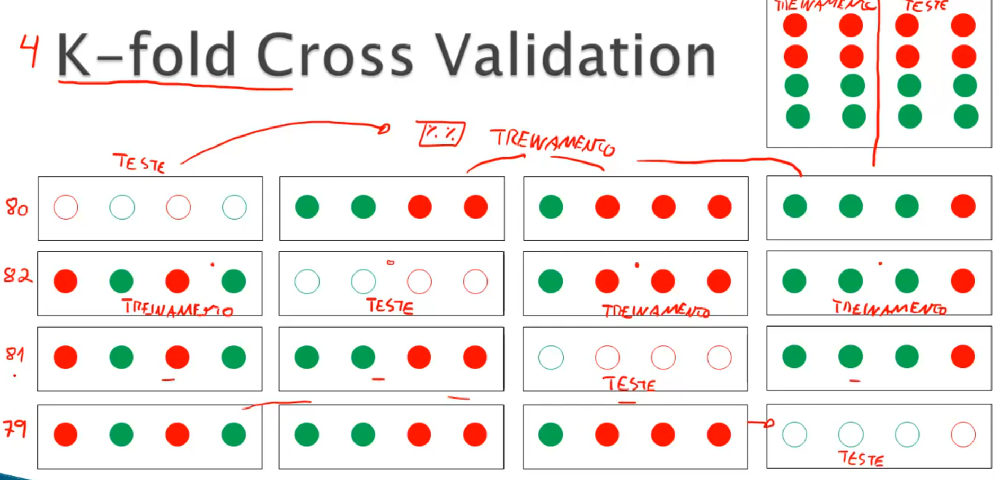

No modelo acima temos o K-Fold Cross Validation com K=40 e seus respectivos valores de performance, o valor final do nosso modelo se dar pelas 4 métricas de desempenho que são combinadas em uma média resultando em 80,5%

✅ Vantagens
Uso eficiente dos dados: Cada observação é usada para treino e teste.

Maior confiabilidade: Reduz a variabilidade das métricas em comparação ao método holdout (treino/teste único).

Detecção de overfitting: Mostra se o modelo generaliza bem ou apenas memoriza os dados

## Underfitting & Overfitting


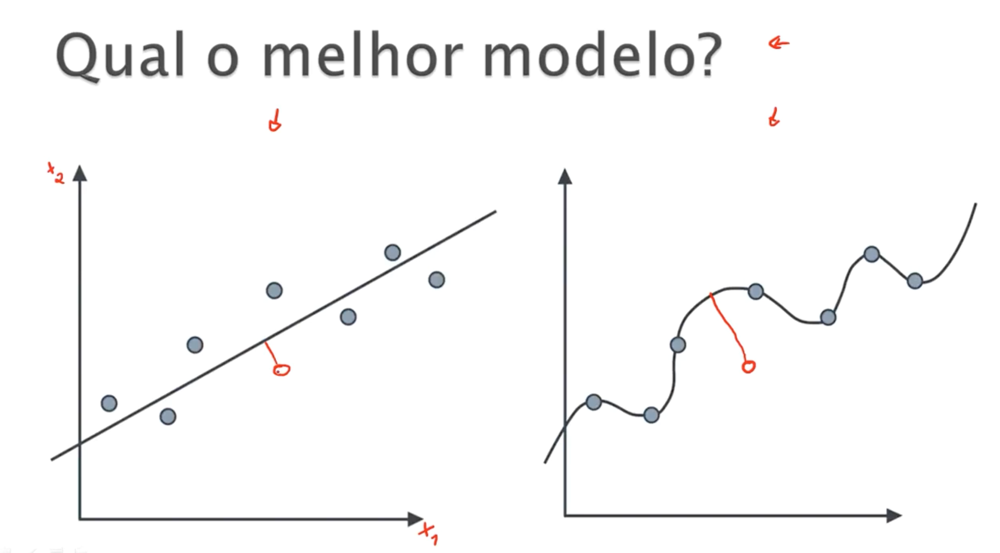

Under & Overfitting São problemas clássicos em machine learning, observando os graficos acima temos que claramente um dos problemas mais clássicos e recorrentes o **overfitting** onde o modelo se adapta muito aos dados de treinamento e perde seu poder de generalização para novas entradas.

🚦 Underfitting (Subajuste)
Definição: Ocorre quando o modelo é muito simples para capturar os padrões dos dados.

Sintomas:

Baixa performance tanto nos dados de treino quanto nos de teste.

Erros altos porque o modelo não consegue aprender a relação subjacente.

Exemplo: Usar uma linha reta (regressão linear simples) para tentar explicar dados que seguem uma curva complexa.

Analogia: É como tentar explicar um romance inteiro usando apenas uma frase curta — perde muitos detalhes importantes.

🎯 Overfitting (Sobreajuste)
Definição: Ocorre quando o modelo é complexo demais e aprende não só os padrões, mas também o “ruído” dos dados de treino.

Sintomas:

Excelente performance nos dados de treino.

Péssima performance nos dados de teste (generalização ruim).

Exemplo: Uma árvore de decisão muito profunda que memoriza cada ponto de treino, mas falha em prever novos dados.

Analogia: É como decorar todas as respostas de uma prova antiga sem entender a matéria — na hora da prova nova, não sabe aplicar.





## Ajustes de hiperparametros

O ajuste de hiperparâmetros é uma das etapas mais críticas para melhorar a performance de modelos de aprendizado de máquina. Hiperparâmetros são valores definidos antes do treinamento (como taxa de aprendizado, número de camadas, número de vizinhos, etc.) e influenciam diretamente a capacidade do modelo de generalizar.

Usamos o GridSearch (busca em grade) para encontrarmos os melhores hiperparametros dos nossos algoritmos afim de termos a melhor acuracia e generalização.

In [19]:
#Importando as bibliotecas necessárias

from sklearn.model_selection import GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
import numpy as np
import pandas as pd

In [7]:
import pickle
with open('/content/drive/MyDrive/Cursos/IAExpert/MachineLearning/Basesdedados/credit.pkl','rb') as f:
  X_credit_treinamento, y_credit_treinamento, X_credit_teste, y_credit_teste = pickle.load(f)

In [8]:
X_credit_treinamento.shape,y_credit_treinamento.shape

((1500, 3), (1500,))

In [9]:
X_credit_teste.shape, y_credit_teste.shape

((500, 3), (500,))

In [10]:
X_credit = np.concatenate((X_credit_treinamento, X_credit_teste), axis = 0) #Juntando as bases de treinamento e testes para fazer o GridSearch, pois o algoritmo já faz a divisao usando o CrossValidation
X_credit.shape

(2000, 3)

In [11]:
Y_credit = np.concatenate((y_credit_treinamento, y_credit_teste), axis = 0)#Juntando as bases de treinamento e testes para fazer o GridSearch, pois o algoritmo já faz a divisao usando o CrossValidation
Y_credit.shape

(2000,)

###Arvore de Decisão

In [ ]:
DecisionTreeClassifier()

DecisionTreeClassifier()

In [ ]:
'''
Iremos testar todos os hiperparamentro para achar os melhores para o modelo, todavia
esses parametros deverão ser passados para o GridSearchCV da forma como estão descritos
no modelo.

DecisionTreeClassifier() temos:

criterion{“gini”, “entropy”, “log_loss”}, default=”gini”
The function to measure the quality of a split. Supported criteria are “gini” for the Gini impurity and “log_loss” and “entropy” both for the Shannon information gain, see Mathematical formulation.

splitter{“best”, “random”}, default=”best”
The strategy used to choose the split at each node. Supported strategies are “best” to choose the best split and “random” to choose the best random split.

max_depthint, default=None
The maximum depth of the tree. If None, then nodes are expanded until all leaves are pure or until all leaves contain less than min_samples_split samples.

min_samples_split int or float, default=2

min_samples_leaf int or float, default=1
'''
parametros = {'criterion':['gini','entropy'],
              'splitter':['best','random'],
              'min_samples_split':[2,5,10], #valores de forma randomica que serão utilizados na busca
              'min_samples_leaf':[2,5,10] #valores de forma randomica que serão utilizados na busca
              }

In [ ]:
grid_search = GridSearchCV(estimator = DecisionTreeClassifier(), #Primeiro paramentro do GridSearch estimator; qual algoritmo será testado
                           param_grid = parametros,scoring=['accuracy','neg_mean_squared_error'],refit='accuracy') #Segundo paramentros são os os parametros dos algoritmo usado, ele irá combinar todos com todos

In [ ]:
grid_search.fit(X_credit,Y_credit)

GridSearchCV(estimator=DecisionTreeClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'min_samples_leaf': [2, 5, 10],
                         'min_samples_split': [2, 5, 10],
                         'splitter': ['best', 'random']},
             refit='accuracy', scoring=['accuracy', 'neg_mean_squared_error'])

In [ ]:
melhor_parametro = grid_search.best_params_
melhor_resultado = grid_search.best_score_

In [ ]:
melhor_parametro

{'criterion': 'entropy',
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'splitter': 'best'}

In [ ]:
melhor_resultado

np.float64(0.984)

In [ ]:
df_resultado=pd.DataFrame.from_dict(grid_search.cv_results_)

In [ ]:
df_resultado

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_min_samples_leaf,param_min_samples_split,param_splitter,params,split0_test_accuracy,...,std_test_accuracy,rank_test_accuracy,split0_test_neg_mean_squared_error,split1_test_neg_mean_squared_error,split2_test_neg_mean_squared_error,split3_test_neg_mean_squared_error,split4_test_neg_mean_squared_error,mean_test_neg_mean_squared_error,std_test_neg_mean_squared_error,rank_test_neg_mean_squared_error
0,0.007858,0.001645,0.003560,0.000864,gini,2,2,best,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9825,...,0.007176,4,-0.0175,-0.0300,-0.0200,-0.0075,-0.0200,-0.0190,0.007176,4
1,0.003956,0.002474,0.005071,0.003259,gini,2,2,random,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9900,...,0.012510,9,-0.0100,-0.0325,-0.0200,-0.0050,-0.0375,-0.0210,0.012510,12
2,0.009881,0.004415,0.004048,0.000339,gini,2,5,best,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9750,...,0.007483,7,-0.0250,-0.0300,-0.0200,-0.0075,-0.0200,-0.0205,0.007483,7
3,0.002479,0.000914,0.003586,0.001282,gini,2,5,random,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9750,...,0.003391,21,-0.0250,-0.0325,-0.0225,-0.0275,-0.0250,-0.0265,0.003391,21
4,0.006098,0.001434,0.002566,0.000948,gini,2,10,best,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9750,...,0.005099,5,-0.0250,-0.0225,-0.0200,-0.0100,-0.0200,-0.0195,0.005099,5
5,0.002415,0.000934,0.004694,0.001664,gini,2,10,random,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9550,...,0.008000,26,-0.0450,-0.0375,-0.0325,-0.0225,-0.0425,-0.0360,0.008000,26
6,0.006444,0.001375,0.002714,0.001025,gini,5,2,best,"{'criterion': 'gini', 'min_samples_leaf': 5, '...",0.9775,...,0.006442,9,-0.0225,-0.0300,-0.0200,-0.0100,-0.0225,-0.0210,0.006442,9
7,0.003598,0.000422,0.002554,0.000976,gini,5,2,random,"{'criterion': 'gini', 'min_samples_leaf': 5, '...",0.9375,...,0.012884,29,-0.0625,-0.0375,-0.0425,-0.0275,-0.0275,-0.0395,0.012884,29
8,0.006638,0.001400,0.004161,0.001230,gini,5,5,best,"{'criterion': 'gini', 'min_samples_leaf': 5, '...",0.9775,...,0.006442,9,-0.0225,-0.0300,-0.0200,-0.0100,-0.0225,-0.0210,0.006442,9
9,0.002883,0.000996,0.002994,0.001665,gini,5,5,random,"{'criterion': 'gini', 'min_samples_leaf': 5, '...",0.9750,...,0.014089,27,-0.0250,-0.0600,-0.0350,-0.0225,-0.0475,-0.0380,0.014089,27


###Random forest


In [3]:
'''
Os hiperparametros que serão testados são:
n_estimators, criterion, max_depth, min_samples_split, min_samples_leaf

n_estimators, The number of trees in the forest.

criterion{“gini”, “entropy”, “log_loss”},
The function to measure the quality of a split. Supported criteria are “gini” for the Gini impurity and “log_loss” and “entropy”
both for the Shannon information gain, see Mathematical formulation. Note: This parameter is tree-specific.

max_depthint,
The maximum depth of the tree. If None, then nodes are expanded until all leaves are pure or until all leaves contain less than min_samples_split samples.

min_samples_split,
The minimum number of samples required to split an internal node:
If int, then consider min_samples_split as the minimum number.
If float, then min_samples_split is a fraction and ceil(min_samples_split * n_samples) are the minimum number of samples for each split.

min_samples_leaf,
The minimum number of samples required to be at a leaf node. A split point at any depth will only be considered if it leaves at least min_samples_leaf training samples in each of the left and right branches. This may have the effect of smoothing the model, especially in regression.
If int, then consider min_samples_leaf as the minimum number.
If float, then min_samples_leaf is a fraction and ceil(min_samples_leaf * n_samples) are the minimum number of samples for each node.
'''
from sklearn.ensemble import RandomForestClassifier


In [12]:
parametros = {'criterion':['gini','entropy','log_loss'],
              'n_estimators':[10,40,100,150],
              'min_samples_split':[2,5,10], #valores de forma randomica que serão utilizados na busca
              'min_samples_leaf':[2,5,10] #valores de forma randomica que serão utilizados na busca
              }

In [13]:
grid_search = GridSearchCV(estimator = RandomForestClassifier(), #Primeiro paramentro do GridSearch estimator; qual algoritmo será testado
                           param_grid = parametros,scoring=['accuracy','neg_mean_squared_error'],refit='accuracy') #Segundo parametros são os parametros dos algoritmo usados, ele irá combinar todos com todos

In [14]:
grid_search.fit(X_credit,Y_credit)

GridSearchCV(estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'min_samples_leaf': [2, 5, 10],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [10, 40, 100, 150]},
             refit='accuracy', scoring=['accuracy', 'neg_mean_squared_error'])

In [15]:
melhor_parametro = grid_search.best_params_
melhor_resultado = grid_search.best_score_

In [16]:
melhor_parametro

{'criterion': 'entropy',
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 100}

In [17]:
melhor_resultado

np.float64(0.9880000000000001)

In [20]:
df_resultado=pd.DataFrame.from_dict(grid_search.cv_results_)

In [21]:
df_resultado

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_min_samples_leaf,param_min_samples_split,param_n_estimators,params,split0_test_accuracy,...,std_test_accuracy,rank_test_accuracy,split0_test_neg_mean_squared_error,split1_test_neg_mean_squared_error,split2_test_neg_mean_squared_error,split3_test_neg_mean_squared_error,split4_test_neg_mean_squared_error,mean_test_neg_mean_squared_error,std_test_neg_mean_squared_error,rank_test_neg_mean_squared_error
0,0.166829,0.035362,0.015807,0.005118,gini,2,2,10,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9825,...,0.009301,38,-0.0175,-0.0300,-0.0250,-0.0025,-0.0200,-0.0190,0.009301,44
1,0.492550,0.087947,0.024466,0.008006,gini,2,2,40,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9850,...,0.004848,7,-0.0150,-0.0175,-0.0225,-0.0075,-0.0150,-0.0155,0.004848,7
2,0.976408,0.251381,0.023684,0.005847,gini,2,2,100,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9875,...,0.005831,13,-0.0125,-0.0175,-0.0250,-0.0075,-0.0175,-0.0160,0.005831,13
3,1.188489,0.337529,0.029623,0.009979,gini,2,2,150,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9800,...,0.006325,20,-0.0200,-0.0200,-0.0225,-0.0050,-0.0200,-0.0175,0.006325,23
4,0.060397,0.005695,0.006894,0.002773,gini,2,5,10,"{'criterion': 'gini', 'min_samples_leaf': 2, '...",0.9875,...,0.004472,20,-0.0125,-0.0225,-0.0225,-0.0175,-0.0125,-0.0175,0.004472,23
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
103,0.394811,0.010557,0.018490,0.002210,log_loss,10,5,150,"{'criterion': 'log_loss', 'min_samples_leaf': ...",0.9800,...,0.004183,55,-0.0200,-0.0250,-0.0225,-0.0125,-0.0200,-0.0200,0.004183,56
104,0.026826,0.000941,0.003068,0.000064,log_loss,10,10,10,"{'criterion': 'log_loss', 'min_samples_leaf': ...",0.9675,...,0.009618,108,-0.0325,-0.0200,-0.0400,-0.0175,-0.0400,-0.0300,0.009618,108
105,0.109754,0.008010,0.006050,0.000224,log_loss,10,10,40,"{'criterion': 'log_loss', 'min_samples_leaf': ...",0.9750,...,0.007746,81,-0.0250,-0.0250,-0.0250,-0.0075,-0.0300,-0.0225,0.007746,82
106,0.263122,0.010611,0.011674,0.000463,log_loss,10,10,100,"{'criterion': 'log_loss', 'min_samples_leaf': ...",0.9725,...,0.007483,77,-0.0275,-0.0225,-0.0250,-0.0075,-0.0275,-0.0220,0.007483,80


###kNN

In [22]:
'''
Os hiperparametros que iremos estimar para o algoritmo kNN são:
n_neighbors, weights, algorithm,  leaf_size, p ,metric

n_neighbors
Number of neighbors to use by default for kneighbors queries.

weights
Weight function used in prediction. Possible values:
‘uniform’ : uniform weights. All points in each neighborhood are weighted equally.
‘distance’ : weight points by the inverse of their distance. in this case, closer neighbors of a query point will have a greater influence than neighbors which are further away.

algorithm{‘auto’, ‘ball_tree’, ‘kd_tree’, ‘brute’},
Algorithm used to compute the nearest neighbors:
‘ball_tree’ will use BallTree
‘kd_tree’ will use KDTree
‘brute’ will use a brute-force search.
‘auto’ will attempt to decide the most appropriate algorithm based on the values passed to fit method.

leaf_size,
Leaf size passed to BallTree or KDTree. This can affect the speed of the construction and query, as well as the memory required to store the tree.
The optimal value depends on the nature of the problem

p,
Power parameter for the Minkowski metric. When p = 1, this is equivalent to using manhattan_distance (l1), and euclidean_distance (l2) for p = 2.
For arbitrary p, minkowski_distance (l_p) is used. This parameter is expected to be positive.

metric,
Metric to use for distance computation. Default is “minkowski”, which results in the standard Euclidean distance when p = 2. See the documentation of scipy.spatial.distance and the metrics listed in distance_metrics for valid metric values.
If metric is “precomputed”, X is assumed to be a distance matrix and must be square during fit. X may be a sparse graph, in which case only “nonzero” elements may be considered neighbors.
If metric is a callable function, it takes two arrays representing 1D vectors as inputs and must return one value indicating the distance between those vectors. This works for Scipy’s metrics, but is less efficient than passing the metric name as a string.
'''
parametros = {'n_neighbors':[5,6,7],
              'weights':['uniform','distance'],
              'algorithm':['auto','ball_tree','kd_tree','brute'],
              'p':[1,2],
              'metric':['euclidean','minkowski'] #valores de forma randomica que serão utilizados na busca
              }


In [23]:
grid_search = GridSearchCV(estimator = KNeighborsClassifier(), #Primeiro paramentro do GridSearch estimator; qual algoritmo será testado
                           param_grid = parametros,scoring=['accuracy','neg_mean_squared_error'],refit='accuracy') #Segundo parametros são os parametros dos algoritmo usados, ele irá combinar todos com todos

In [24]:
grid_search.fit(X_credit,Y_credit)

GridSearchCV(estimator=KNeighborsClassifier(),
             param_grid={'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],
                         'metric': ['euclidean', 'minkowski'],
                         'n_neighbors': [5, 6, 7], 'p': [1, 2],
                         'weights': ['uniform', 'distance']},
             refit='accuracy', scoring=['accuracy', 'neg_mean_squared_error'])

In [25]:
melhor_parametro = grid_search.best_params_
melhor_resultado = grid_search.best_score_

In [26]:
melhor_parametro

{'algorithm': 'auto',
 'metric': 'euclidean',
 'n_neighbors': 6,
 'p': 1,
 'weights': 'distance'}

In [27]:
melhor_resultado

np.float64(0.9825000000000002)

In [28]:
df_resultado=pd.DataFrame.from_dict(grid_search.cv_results_)

In [29]:
df_resultado

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_algorithm,param_metric,param_n_neighbors,param_p,param_weights,params,...,std_test_accuracy,rank_test_accuracy,split0_test_neg_mean_squared_error,split1_test_neg_mean_squared_error,split2_test_neg_mean_squared_error,split3_test_neg_mean_squared_error,split4_test_neg_mean_squared_error,mean_test_neg_mean_squared_error,std_test_neg_mean_squared_error,rank_test_neg_mean_squared_error
0,0.007013,0.002103,0.021787,0.007093,auto,euclidean,5,1,uniform,"{'algorithm': 'auto', 'metric': 'euclidean', '...",...,0.005148,53,-0.0225,-0.0250,-0.0275,-0.0150,-0.0150,-0.0210,0.005148,53
1,0.006310,0.001413,0.014836,0.002232,auto,euclidean,5,1,distance,"{'algorithm': 'auto', 'metric': 'euclidean', '...",...,0.006124,21,-0.0200,-0.0225,-0.0300,-0.0125,-0.0150,-0.0200,0.006124,21
2,0.006004,0.001009,0.016459,0.000763,auto,euclidean,5,2,uniform,"{'algorithm': 'auto', 'metric': 'euclidean', '...",...,0.005148,53,-0.0225,-0.0250,-0.0275,-0.0150,-0.0150,-0.0210,0.005148,53
3,0.009065,0.005250,0.016629,0.003753,auto,euclidean,5,2,distance,"{'algorithm': 'auto', 'metric': 'euclidean', '...",...,0.006124,21,-0.0200,-0.0225,-0.0300,-0.0125,-0.0150,-0.0200,0.006124,21
4,0.007663,0.003021,0.026452,0.004614,auto,euclidean,6,1,uniform,"{'algorithm': 'auto', 'metric': 'euclidean', '...",...,0.005148,85,-0.0225,-0.0275,-0.0300,-0.0150,-0.0225,-0.0235,0.005148,85
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91,0.001947,0.000965,0.010022,0.000338,brute,minkowski,6,2,distance,"{'algorithm': 'brute', 'metric': 'minkowski', ...",...,0.003536,1,-0.0175,-0.0200,-0.0225,-0.0125,-0.0150,-0.0175,0.003536,1
92,0.002603,0.002480,0.021673,0.003538,brute,minkowski,7,1,uniform,"{'algorithm': 'brute', 'metric': 'minkowski', ...",...,0.007483,81,-0.0150,-0.0325,-0.0275,-0.0225,-0.0125,-0.0220,0.007483,81
93,0.001427,0.000105,0.020633,0.001838,brute,minkowski,7,1,distance,"{'algorithm': 'brute', 'metric': 'minkowski', ...",...,0.005339,17,-0.0125,-0.0225,-0.0275,-0.0200,-0.0150,-0.0195,0.005339,17
94,0.001458,0.000050,0.011247,0.000866,brute,minkowski,7,2,uniform,"{'algorithm': 'brute', 'metric': 'minkowski', ...",...,0.005612,65,-0.0200,-0.0325,-0.0200,-0.0175,-0.0175,-0.0215,0.005612,69


###Logistic Regression

In [37]:
'''
Os hiperparametros que iremos estimar para o algoritmo Logistic Regression são:
penalty, C, solver, max_iter

penalty,
Specify the norm of the penalty:
None: no penalty is added;
'l2': add a L2 penalty term and it is the default choice;
'l1': add a L1 penalty term;
'elasticnet': both L1 and L2 penalty terms are added.

C,
Inverse of regularization strength; must be a positive float.
Like in support vector machines, smaller values specify stronger regularization.
C=np.inf results in unpenalized logistic regression.
For a visual example on the effect of tuning the C parameter with an L1 penalty, see: Regularization path of L1- Logistic Regression.

max_iter,
Maximum number of iterations taken for the solvers to converge.

tol, default=1e-4
Tolerance for stopping criteria.

solver{‘lbfgs’, ‘liblinear’, ‘newton-cg’, ‘newton-cholesky’, ‘sag’, ‘saga’},
Algorithm to use in the optimization problem. Default is ‘lbfgs’. To choose a solver, you might want to consider the following aspects:
‘lbfgs’ is a good default solver because it works reasonably well for a wide class of problems.
For multiclass problems (n_classes >= 3), all solvers except ‘liblinear’ minimize the full multinomial loss, ‘liblinear’ will raise an error.
‘newton-cholesky’ is a good choice for n_samples >> n_features * n_classes, especially with one-hot encoded categorical features with rare categories. Be aware that the memory usage of this solver has a quadratic dependency on n_features * n_classes because it explicitly computes the full Hessian matrix.
For small datasets, ‘liblinear’ is a good choice, whereas ‘sag’ and ‘saga’ are faster for large ones;
‘liblinear’ can only handle binary classification by default. To apply a one-versus-rest scheme for the multiclass setting one can wrap it with the OneVsRestClassifier.
'''

parametros = {'penalty':['l1','l2','elasticnet'],
              'C':[0.15,0.5,1],
              'tol':[0.0001,0.00001,0.0000001],
              'solver': ['lbfgs', 'liblinear', 'newton-cg', 'newton-cholesky', 'sag', 'saga'],
              'max_iter':[50,10,150,200],
              }

grid_search = GridSearchCV(estimator = LogisticRegression(), #Primeiro paramentro do GridSearch estimator; qual algoritmo será testado
                           param_grid = parametros,scoring=['accuracy','neg_mean_squared_error'],refit='accuracy') #Segundo parametros são os parametros dos algoritmo usados, ele irá combinar todos com todos

In [38]:
grid_search.fit(X_credit,Y_credit)

/usr/local/lib/python3.12/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/svm/_base.py:1249: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  w

GridSearchCV(estimator=LogisticRegression(),
             param_grid={'C': [0.15, 0.5, 1], 'max_iter': [50, 10, 150, 200],
                         'penalty': ['l1', 'l2', 'elasticnet'],
                         'solver': ['lbfgs', 'liblinear', 'newton-cg',
                                    'newton-cholesky', 'sag', 'saga'],
                         'tol': [0.0001, 1e-05, 1e-07]},
             refit='accuracy', scoring=['accuracy', 'neg_mean_squared_error'])

In [39]:
melhor_parametro = grid_search.best_params_
melhor_resultado = grid_search.best_score_

In [40]:
melhor_parametro

{'C': 1, 'max_iter': 50, 'penalty': 'l2', 'solver': 'lbfgs', 'tol': 0.0001}

In [41]:
melhor_resultado

np.float64(0.9484999999999999)

In [42]:
df_resultado=pd.DataFrame.from_dict(grid_search.cv_results_)
df_resultado

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_max_iter,param_penalty,param_solver,param_tol,params,...,std_test_accuracy,rank_test_accuracy,split0_test_neg_mean_squared_error,split1_test_neg_mean_squared_error,split2_test_neg_mean_squared_error,split3_test_neg_mean_squared_error,split4_test_neg_mean_squared_error,mean_test_neg_mean_squared_error,std_test_neg_mean_squared_error,rank_test_neg_mean_squared_error
0,0.002436,0.002041,0.000000,0.000000,0.15,50,l1,lbfgs,1.000000e-04,"{'C': 0.15, 'max_iter': 50, 'penalty': 'l1', '...",...,NaN,289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,289
1,0.002360,0.002083,0.000000,0.000000,0.15,50,l1,lbfgs,1.000000e-05,"{'C': 0.15, 'max_iter': 50, 'penalty': 'l1', '...",...,NaN,289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,289
2,0.002403,0.002088,0.000000,0.000000,0.15,50,l1,lbfgs,1.000000e-07,"{'C': 0.15, 'max_iter': 50, 'penalty': 'l1', '...",...,NaN,289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,289
3,0.025374,0.002527,0.009545,0.004056,0.15,50,l1,liblinear,1.000000e-04,"{'C': 0.15, 'max_iter': 50, 'penalty': 'l1', '...",...,0.01044,91,-0.05,-0.055,-0.07,-0.0375,-0.055,-0.0535,0.01044,91
4,0.031549,0.005165,0.012055,0.002032,0.15,50,l1,liblinear,1.000000e-05,"{'C': 0.15, 'max_iter': 50, 'penalty': 'l1', '...",...,0.01044,91,-0.05,-0.055,-0.07,-0.0375,-0.055,-0.0535,0.01044,91
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
643,0.000520,0.000018,0.000000,0.000000,1.00,200,elasticnet,sag,1.000000e-05,"{'C': 1, 'max_iter': 200, 'penalty': 'elasticn...",...,NaN,289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,289
644,0.000539,0.000009,0.000000,0.000000,1.00,200,elasticnet,sag,1.000000e-07,"{'C': 1, 'max_iter': 200, 'penalty': 'elasticn...",...,NaN,289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,289
645,0.000568,0.000090,0.000000,0.000000,1.00,200,elasticnet,saga,1.000000e-04,"{'C': 1, 'max_iter': 200, 'penalty': 'elasticn...",...,NaN,289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,289
646,0.000515,0.000018,0.000000,0.000000,1.00,200,elasticnet,saga,1.000000e-05,"{'C': 1, 'max_iter': 200, 'penalty': 'elasticn...",...,NaN,289,NaN,NaN,NaN,NaN,NaN,NaN,NaN,289


###SVM

In [45]:
'''
Os hiperparametros que iremos estimar para a SVM são:

C, kernel, degree, gamma, coef0, tol

C,
Regularization parameter.
The strength of the regularization is inversely proportional to C.
Must be strictly positive. The penalty is a squared l2 penalty.

kernel{‘linear’, ‘poly’, ‘rbf’, ‘sigmoid’, ‘precomputed’},
Specifies the kernel type to be used in the algorithm. If none is given, ‘rbf’ will be used.
If a callable is given it is used to pre-compute the kernel matrix from data matrices; that matrix should be an array of shape (n_samples, n_samples)

degree,
Degree of the polynomial kernel function (‘poly’). Must be non-negative. Ignored by all other kernels.

gamma{‘scale’, ‘auto’},

if gamma='scale' (default) is passed then it uses 1 / (n_features * X.var()) as value of gamma,
if ‘auto’, uses 1 / n_features
if float, must be non-negative.

coef0,
Independent term in kernel function. It is only significant in ‘poly’ and ‘sigmoid’.

tol,
Tolerance for stopping criterion.
'''

parametros = {'C':[0.15,0.5,1],
              'tol':[0.001,0.0001,0.00001],
              'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
              'degree':[1,2,3,4,5],
              'gamma':['scale','auto'],
              'coef0':[0.1,0.5,1],
              }

grid_search = GridSearchCV(estimator = SVC(), #Primeiro paramentro do GridSearch estimator; qual algoritmo será testado
                           param_grid = parametros,scoring=['accuracy','neg_mean_squared_error'],refit='accuracy') #Segundo parametros são os parametros dos algoritmo usados, ele irá combinar todos com todos

In [46]:
grid_search.fit(X_credit,Y_credit)

GridSearchCV(estimator=SVC(),
             param_grid={'C': [0.15, 0.5, 1], 'coef0': [0.1, 0.5, 1],
                         'degree': [1, 2, 3, 4, 5], 'gamma': ['scale', 'auto'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
                         'tol': [0.001, 0.0001, 1e-05]},
             refit='accuracy', scoring=['accuracy', 'neg_mean_squared_error'])

In [47]:
melhor_parametro = grid_search.best_params_
melhor_resultado = grid_search.best_score_

In [48]:
melhor_parametro

{'C': 1,
 'coef0': 1,
 'degree': 5,
 'gamma': 'scale',
 'kernel': 'poly',
 'tol': 0.001}

In [49]:
melhor_resultado

np.float64(0.993)

In [51]:
df_resultado = pd.DataFrame.from_dict(grid_search.cv_results_)
df_resultado

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_C,param_coef0,param_degree,param_gamma,param_kernel,param_tol,...,std_test_accuracy,rank_test_accuracy,split0_test_neg_mean_squared_error,split1_test_neg_mean_squared_error,split2_test_neg_mean_squared_error,split3_test_neg_mean_squared_error,split4_test_neg_mean_squared_error,mean_test_neg_mean_squared_error,std_test_neg_mean_squared_error,rank_test_neg_mean_squared_error
0,0.032164,0.008868,0.009829,0.003419,0.15,0.1,1,scale,linear,0.00100,...,0.011247,685,-0.0500,-0.0550,-0.0725,-0.0375,-0.0550,-0.0540,0.011247,685
1,0.065221,0.021099,0.017534,0.005685,0.15,0.1,1,scale,linear,0.00010,...,0.011247,685,-0.0500,-0.0550,-0.0725,-0.0375,-0.0550,-0.0540,0.011247,685
2,0.096635,0.040203,0.033516,0.003071,0.15,0.1,1,scale,linear,0.00001,...,0.011247,685,-0.0500,-0.0550,-0.0725,-0.0375,-0.0550,-0.0540,0.011247,685
3,0.186198,0.029592,0.046899,0.012357,0.15,0.1,1,scale,poly,0.00100,...,0.006633,793,-0.0525,-0.0575,-0.0675,-0.0475,-0.0575,-0.0565,0.006633,793
4,0.097800,0.011345,0.025415,0.009379,0.15,0.1,1,scale,poly,0.00010,...,0.006633,793,-0.0525,-0.0575,-0.0675,-0.0475,-0.0575,-0.0565,0.006633,793
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1075,0.013920,0.004458,0.006359,0.001384,1.00,1.0,5,auto,rbf,0.00010,...,0.005477,64,-0.0200,-0.0200,-0.0250,-0.0100,-0.0250,-0.0200,0.005477,58
1076,0.012159,0.000640,0.005890,0.000383,1.00,1.0,5,auto,rbf,0.00001,...,0.005477,64,-0.0200,-0.0200,-0.0250,-0.0100,-0.0250,-0.0200,0.005477,58
1077,0.048863,0.001402,0.012626,0.000724,1.00,1.0,5,auto,sigmoid,0.00100,...,0.009028,1051,-0.2375,-0.2500,-0.2450,-0.2250,-0.2475,-0.2410,0.009028,1051
1078,0.050214,0.001298,0.013277,0.001072,1.00,1.0,5,auto,sigmoid,0.00010,...,0.009028,1051,-0.2375,-0.2500,-0.2450,-0.2250,-0.2475,-0.2410,0.009028,1051


###Redes Neurais


In [54]:
'''
Os parametros que serão testados na Redeu Neural são:
hidden_layer_size,activation, solver, alpha, batch_size, learning_rate, max_iter

hidden_layer_sizes, array-like of shape(n_layers - 2,),
The ith element represents the number of neurons in the ith hidden layer.
The total number of layers in the network is n_layers. The total is calculated as 1 Input Layer + Hidden Layers + 1 Output Layer.
Therefore, the number of hidden layers is the total layers minus two.
Examples:
hidden_layer_sizes=(100,) (Default): One hidden layer with 100 neurons.
hidden_layer_sizes=(100, 50, 25): Three hidden layers with 100, 50, and 25 neurons, respectively.
hidden_layer_sizes=(6,): One hidden layer with 6 neurons.

activation{‘identity’, ‘logistic’, ‘tanh’, ‘relu’},
Activation function for the hidden layer.
‘identity’, no-op activation, useful to implement linear bottleneck, returns f(x) = x
‘logistic’, the logistic sigmoid function, returns f(x) = 1 / (1 + exp(-x)).
‘tanh’, the hyperbolic tan function, returns f(x) = tanh(x).
‘relu’, the rectified linear unit function, returns f(x) = max(0, x)

solver{‘lbfgs’, ‘sgd’, ‘adam’},
The solver for weight optimization.
‘lbfgs’ is an optimizer in the family of quasi-Newton methods.
‘sgd’ refers to stochastic gradient descent.
‘adam’ refers to a stochastic gradient-based optimizer proposed by Kingma, Diederik, and Jimmy Ba

alpha,
Strength of the L2 regularization term. The L2 regularization term is divided by the sample size when added to the loss.
For an example usage and visualization of varying regularization, see Varying regularization in Multi-layer Perceptron.

batch_size, default=’auto’
Size of minibatches for stochastic optimizers. If the solver is ‘lbfgs’, the classifier will not use minibatch. When set to “auto”, batch_size=min(200, n_samples).

learning_rate{‘constant’, ‘invscaling’, ‘adaptive’},
Learning rate schedule for weight updates.
‘constant’ is a constant learning rate given by ‘learning_rate_init’.
‘invscaling’ gradually decreases the learning rate at each time step ‘t’ using an inverse scaling exponent of ‘power_t’. effective_learning_rate = learning_rate_init / pow(t, power_t)
‘adaptive’ keeps the learning rate constant to ‘learning_rate_init’ as long as training loss keeps decreasing. Each time two consecutive epochs fail to decrease training loss by at least tol, or fail to increase validation score by at least tol if ‘early_stopping’ is on, the current learning rate is divided by 5.

max_iterint, default=200
Maximum number of iterations. The solver iterates until convergence (determined by ‘tol’) or this number of iterations.
For stochastic solvers (‘sgd’, ‘adam’), note that this determines the number of epochs (how many times each data point will be used), not the number of gradient steps.
'''

parametros = {'hidden_layer_sizes':[(2,2),(3,3)],
              'activation':['identity', 'logistic', 'tanh', 'relu'],
              'solver':['lbfgs', 'sgd', 'adam'],
              'alpha': [0.1,0.2,0.3],
              'batch_size':['auto',300,400],
              'learning_rate':['constant', 'invscaling', 'adaptive'],
              'max_iter':[100,200,300]
              }

grid_search = GridSearchCV(estimator = MLPClassifier(), #Primeiro paramentro do GridSearch estimator; qual algoritmo será testado
                           param_grid = parametros,scoring=['accuracy','neg_mean_squared_error'],refit='accuracy') #Segundo parametros são os parametros dos algoritmo usados, ele irá combinar todos com todos

In [ ]:
grid_search.fit(X_credit,Y_credit)

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.12/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:691: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.12/dist-pa